# Preprocessing

In [1]:
import librosa
import librosa.display
import IPython.display as ipd
import numpy as np
import os
import pandas as pd
import pywt
import csv
import os
from glob import glob
import noisereduce as nr
import shutil
from scipy.io import wavfile
import matplotlib
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
#from google.colab import drive

In [27]:
base_path = r"C:\Users\asus\Downloads\Proyek Riset\datasetMI\Data MI Github"
MI_path = os.path.join(base_path, 'MI')
NORM_path = os.path.join(base_path, 'Normal')


audio_file_MI = glob(os.path.join(MI_path, '*.wav'))
audio_file_NORMAL = glob(os.path.join(NORM_path, '*.wav'))

print("Audio file in MI path:", audio_file_MI)
print("Audio file in Normal path:", audio_file_NORMAL)

# audio_file_MI = glob(MI_path + '*.wav')
# audio_file_NORMAL =glob(NORM_path + '*.wav')
#MI_path = f'{base_path}{os.sep}MI/'
#NORM_path = f'{base_path}{os.path}Normal/'

Audio file in MI path: ['C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of APEX.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Abdul Qadir_RUSB_10 Juni 2022.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Abdul Qadir_RUSB_10 Juni 2022_1.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Abdul Rohman_LLSB_6 Februari 2022.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Abdul Rohman_LUSB_6 Februari 2022.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Abdul Rohman_RUSB_6 Februari 2022_1..wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Aceng Zakaria_APEX_1 Juli 2022.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\datasetMI\\Data MI Github\\MI\\Copy of Copy of Aceng Zakaria_LLSB_

## MI Preprocessing

In [28]:
file_name = 'Copy of Copy of Abdul Qadir_RUSB_10 Juni 2022.wav'
file_MI = os.path.join(MI_path, file_name)

# Verifikasi apakah file ada
if os.path.isfile(file_MI):
    print(f"File found: {file_MI}")
    signal, sr = librosa.load(file_MI, sr=None)
    print(f"Loaded {file_MI} with sample rate {sr}")
else:
    print(f"File not found: {file_MI}")

File found: C:\Users\asus\Downloads\Proyek Riset\datasetMI\Data MI Github\MI\Copy of Copy of Abdul Qadir_RUSB_10 Juni 2022.wav
Loaded C:\Users\asus\Downloads\Proyek Riset\datasetMI\Data MI Github\MI\Copy of Copy of Abdul Qadir_RUSB_10 Juni 2022.wav with sample rate 4000


In [29]:
sr

4000

Text(0.5, 1.0, 'Sample of Raw PCG Signal MI Data')

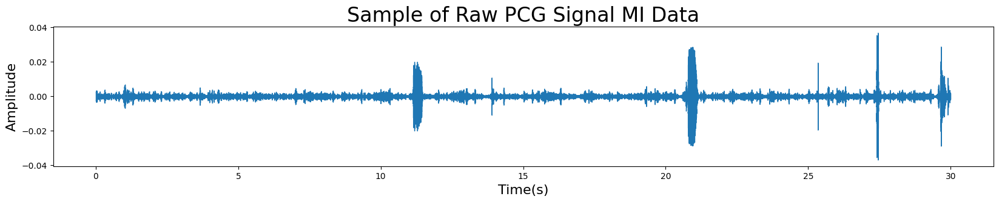

In [30]:
plt.figure(figsize=(20,3))
librosa.display.waveshow(signal, sr = sr)
plt.ylabel("Amplitude", size=16)
plt.xlabel('Time(s)', size=16)

plt.title('Sample of Raw PCG Signal MI Data', size=24)

Text(0.5, 1.0, 'Sample of Denoised PCG Signal MI Data')

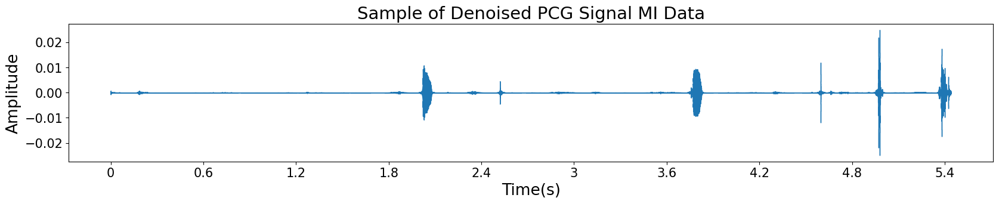

In [31]:
reduced_noise = nr.reduce_noise(y=signal, sr=sr, n_std_thresh_stationary=1.5, stationary=True, time_mask_smooth_ms=64)
plt.figure(figsize=(20,3))
librosa.display.waveshow(reduced_noise)
plt.ylabel("Amplitude", size=19)
plt.xlabel('Time(s)', size=19)
plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)
plt.title('Sample of Denoised PCG Signal MI Data', size=21)

In [32]:
reduced_noise.size

120000

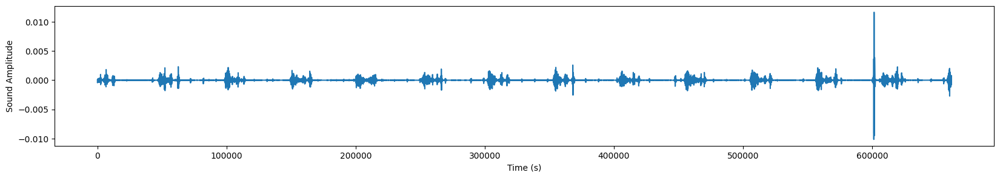

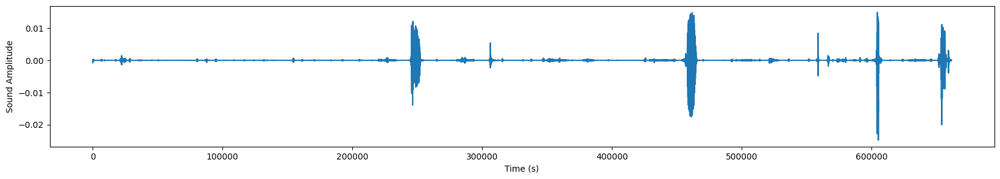

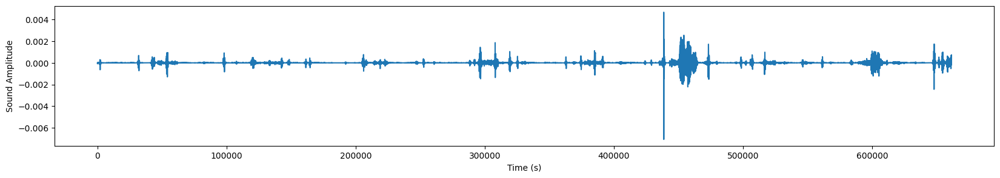

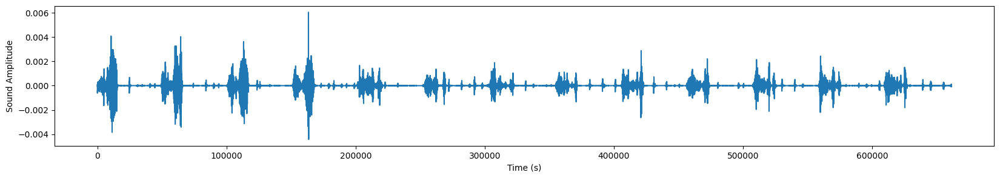

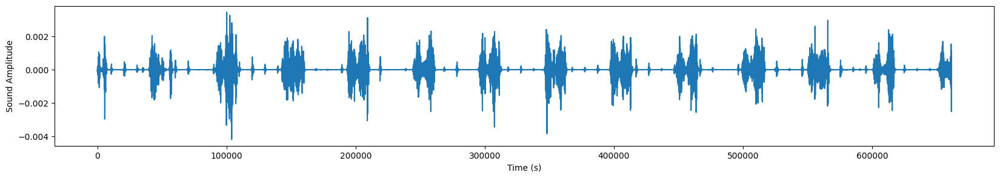

...

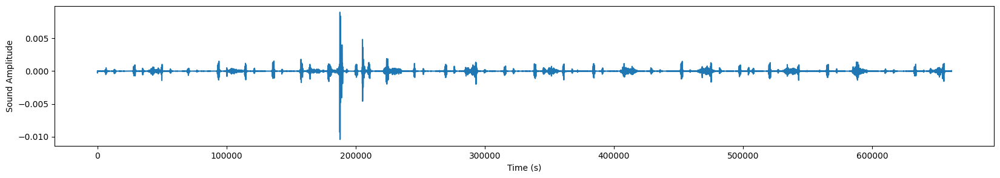

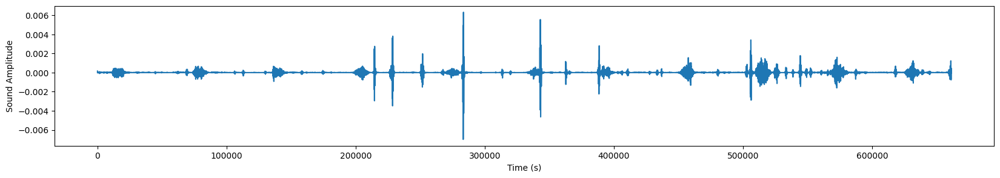

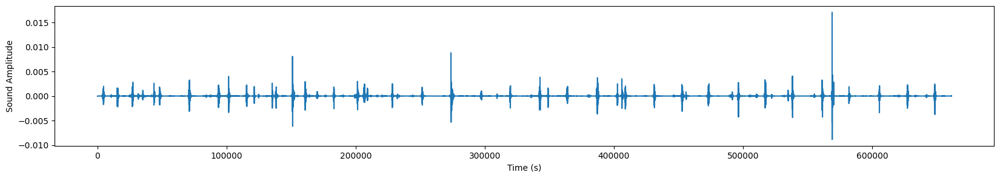

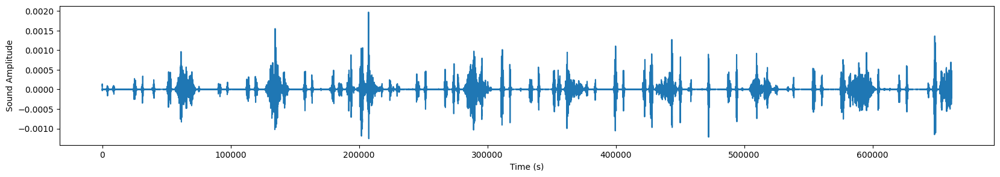

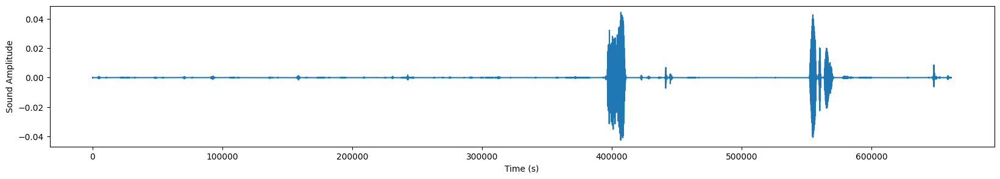

In [33]:
denoised_file = []
i = 1

for file in range(0, len(audio_file_MI),1):

  audio, sfreq = librosa.load(audio_file_MI[file])
  denoised_name =  "Preprocessed_MI_%s.wav" % i
  reduced_noise = nr.reduce_noise(y = audio, sr=sfreq, n_std_thresh_stationary=1.5,stationary=True)
  wavfile.write(denoised_name, sfreq, reduced_noise)
  denoised_file.append(denoised_name)
  fig, ax = plt.subplots(figsize=(20,3))
  ax.plot(reduced_noise)
  ax.set(xlabel='Time (s)', ylabel='Sound Amplitude')
  
  i=i+1
  plt.show()

In [41]:
import os
import shutil

# Definisikan base_path dan jalur folder tempat file hasil
base_path = r"C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection"

# Folder baru untuk memindahkan file
new_folder_name = "Denoised_MI_Files"
new_folder_path = os.path.join(base_path, new_folder_name)

# Buat folder baru jika belum ada
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)

# Daftar file yang ingin dipindahkan
file_prefix = "Preprocessed_MI_"
file_extension = ".wav"

# Iterasi melalui file dengan nama sesuai prefix
for i in range(1, 281):  # Asumsikan ada 280 file
    file_name = f"{file_prefix}{i}{file_extension}"
    file_path = os.path.join(base_path, file_name)
    
    # Periksa apakah file ada
    if os.path.isfile(file_path):
        # Tentukan jalur tujuan
        destination_path = os.path.join(new_folder_path, file_name)
        
        # Pindahkan file
        shutil.move(file_path, destination_path)
        print(f"Moved {file_path} to {destination_path}")
    else:
        print(f"File not found: {file_path}")

print("File move complete.")

Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_MI_1.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_MI_Files\Preprocessed_MI_1.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_MI_2.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_MI_Files\Preprocessed_MI_2.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_MI_3.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_MI_Files\Preprocessed_MI_3.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_MI_4.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_MI_Files\Preprocessed_MI_4.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_MI_5.wav to C

## NORMAL Preprocessing

In [34]:
file_name_normal = 'Copy of RUSB (59).wav'
file_NORMAL = os.path.join(NORM_path, file_name_normal)

if os.path.isfile(file_NORMAL):
    print(f"File found: {file_NORMAL}")
    signal, sr = librosa.load(file_NORMAL, sr=None)
    print(f"Loaded {file_NORMAL} with sampe rate {sr}")
else:
    print(f"File not found: {file_NORMAL}")

File found: C:\Users\asus\Downloads\Proyek Riset\datasetMI\Data MI Github\Normal\Copy of RUSB (59).wav
Loaded C:\Users\asus\Downloads\Proyek Riset\datasetMI\Data MI Github\Normal\Copy of RUSB (59).wav with sampe rate 4000


In [35]:
sr

4000

Text(0.5, 1.0, 'Sample of Raw PCG Signal Normal Data')

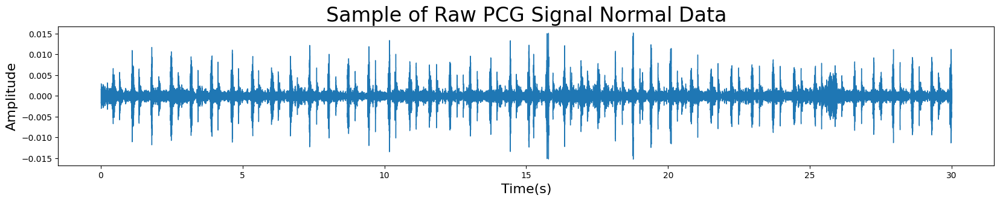

In [36]:
plt.figure(figsize=(20,3))
librosa.display.waveshow(signal, sr = sr)
plt.ylabel("Amplitude", size=16)
plt.xlabel('Time(s)', size=16)

plt.title('Sample of Raw PCG Signal Normal Data', size=24)

Text(0.5, 1.0, 'Sample of Denoised PCG Signal Normal Data')

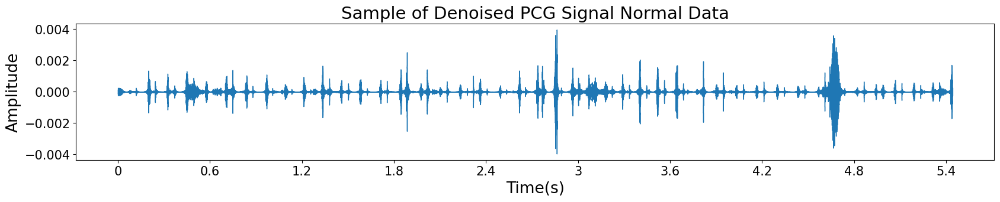

In [38]:
reduced_noise = nr.reduce_noise(y=signal, sr=sr, n_std_thresh_stationary=1.5, stationary=True, time_mask_smooth_ms=64)
plt.figure(figsize=(20,3))
librosa.display.waveshow(reduced_noise)
plt.ylabel("Amplitude", size=19)
plt.xlabel('Time(s)', size=19)
plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)
plt.title('Sample of Denoised PCG Signal Normal Data', size=21)

In [39]:
reduced_noise.size

120000

In [ ]:
denoised_file_normal = []
i = 1

for file in range(0, len(audio_file_NORMAL),1):

  audio, sfreq = librosa.load(audio_file_NORMAL[file])
  denoised_name =  "Preprocessed_NORMAL_%s.wav" % i
  reduced_noise = nr.reduce_noise(y = audio, sr=sfreq, n_std_thresh_stationary=1.5,stationary=True)
  wavfile.write(denoised_name, sfreq, reduced_noise)
  denoised_file.append(denoised_name)
  fig, ax = plt.subplots(figsize=(20,3))
  ax.plot(reduced_noise)
  ax.set(xlabel='Time (s)', ylabel='Sound Amplitude')
  
  i=i+1
  plt.show()

In [1]:
import os
import shutil

# Definisikan base_path dan jalur folder tempat file hasil
base_path = r"C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection"

# Folder baru untuk memindahkan file
new_folder_name = "Denoised_NORMAL_Files"
new_folder_path = os.path.join(base_path, new_folder_name)

# Buat folder baru jika belum ada
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)

# Daftar file yang ingin dipindahkan
file_prefix = "Preprocessed_NORMAL_"
file_extension = ".wav"

# Iterasi melalui file dengan nama sesuai prefix
for i in range(1, 281):  # Asumsikan ada 280 file
    file_name = f"{file_prefix}{i}{file_extension}"
    file_path = os.path.join(base_path, file_name)
    
    # Periksa apakah file ada
    if os.path.isfile(file_path):
        # Tentukan jalur tujuan
        destination_path = os.path.join(new_folder_path, file_name)
        
        # Pindahkan file
        shutil.move(file_path, destination_path)
        print(f"Moved {file_path} to {destination_path}")
    else:
        print(f"File not found: {file_path}")

print("File move complete.")

Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_NORMAL_1.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_NORMAL_Files\Preprocessed_NORMAL_1.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_NORMAL_2.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_NORMAL_Files\Preprocessed_NORMAL_2.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_NORMAL_3.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_NORMAL_Files\Preprocessed_NORMAL_3.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Preprocessed_NORMAL_4.wav to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Denoised_NORMAL_Files\Preprocessed_NORMAL_4.wav
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial

# Feature Extraction

In [2]:
base_path_fe = r"C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection"
MI_Denoised = os.path.join(base_path_fe, 'Denoised_MI_Files')
NORMAL_Denoised = os.path.join(base_path_fe, 'Denoised_NORMAL_Files')

audio_file_MI_denoised = glob(os.path.join(MI_Denoised, '*.wav'))
audio_file_NORMAL_denoised = glob(os.path.join(NORMAL_Denoised, '*.wav'))

print("Audio file in Denoised MI Files", audio_file_MI_denoised)
print("Audio file in Denoised NORMAL Files", audio_file_NORMAL_denoised)

Audio file in Denoised MI Files ['C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_1.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_10.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_100.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_101.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_102.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_103.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction Detection\\Denoised_MI_Files\\Preprocessed_MI_104.wav', 'C:\\Users\\asus\\Downloads\\Proyek Riset\\Proyek Myocardial Infarction De

## MI Dataset Feature Extraction

### MFCC

In [4]:
def feature_extraction(file_path):
    x, sample_rate = librosa.load(file_path, res_type='kaiser_fast')
    mfcc = librosa.feature.mfcc(y = x, sr = sample_rate)
    return mfcc

In [5]:
features = {}
feature_mfcc_test = []
directory = MI_Denoised

for audio in os.listdir(directory):
    audio_path = os.path.join(directory, audio)  # Menggunakan os.path.join untuk menggabungkan direktori dan nama file
    if os.path.isfile(audio_path):
        features[audio_path] = feature_extraction(audio_path)
        feature_mfcc_test.append(feature_extraction(audio_path))
    else:
        print(f"File not found: {audio_path}")

In [6]:
label = []
annotation = []
for i in range (280):
  annotation.append(0)
  label.append("MI")

#### MFCC Mean

In [7]:
mfcc_means = []
for i in feature_mfcc_test:
  mean = np.mean(i,dtype=np.float64)
  mfcc_means.append(mean)

df_mfcc_means = pd.DataFrame({'MFCC Means' : mfcc_means})
df_mfcc_means

,MFCC Means
0,-36.678809
1,-39.232468
2,-37.112969
3,-34.888764
4,-40.347881
...,...
275,-40.914189
276,-44.132360
277,-41.169644
278,-44.095507


#### MFCC Std

In [8]:
mfcc_std = []
for i in feature_mfcc_test:
  std = np.std(i)
  mfcc_std.append(std)

df_mfcc_std = pd.DataFrame({'MFCC std' : mfcc_std})
df_mfcc_std

,MFCC std
0,201.694061
1,223.005539
2,214.030426
3,192.099609
4,221.986404
...,...
275,228.066803
276,237.851593
277,214.242798
278,240.086823


#### MFCC Max

In [9]:
mfcc_max = []
for i in feature_mfcc_test:
  max = np.max(i)
  mfcc_max.append(max)

df_mfcc_max = pd.DataFrame({'MFCC max' : mfcc_max})
df_mfcc_max

,MFCC max
0,212.236206
1,127.303085
2,167.961395
3,228.022308
4,176.611816
...,...
275,222.222260
276,166.064453
277,151.469421
278,203.908966


#### MFCC Min

In [10]:
mfcc_min = []
for i in feature_mfcc_test:
  Min = np.min(i)
  mfcc_min.append(Min)

df_mfcc_min = pd.DataFrame({'MFCC min' : mfcc_min})
df_mfcc_min

,MFCC min
0,-938.331787
1,-1039.210693
2,-1002.397705
3,-892.935242
4,-1047.209961
...,...
275,-1073.094238
276,-1117.155029
277,-1003.151428
278,-1131.370850


#### MFCC Plot

Text(0.5, 0, 'Data Ke')

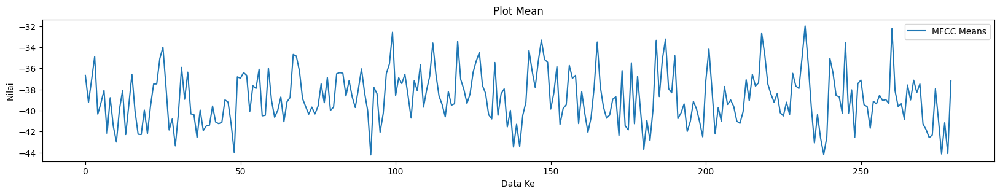

In [11]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_means.plot.line()

plt.title('Plot Mean')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

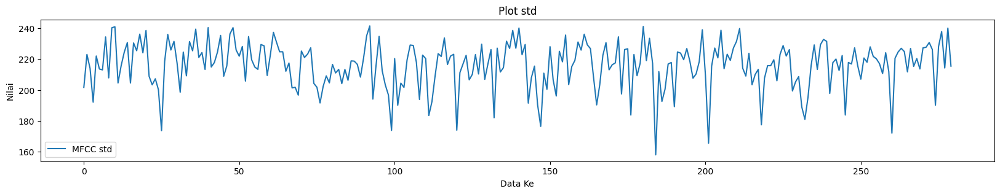

In [12]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_std.plot.line()

plt.title('Plot std')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

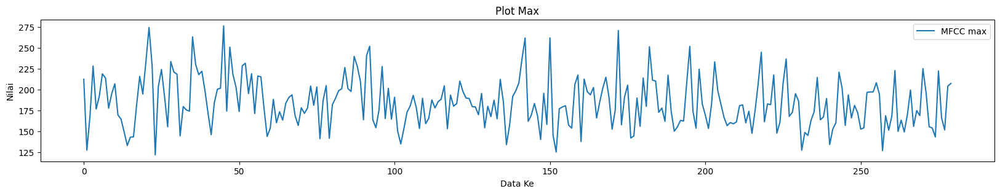

In [13]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_max.plot.line()

plt.title('Plot Max')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

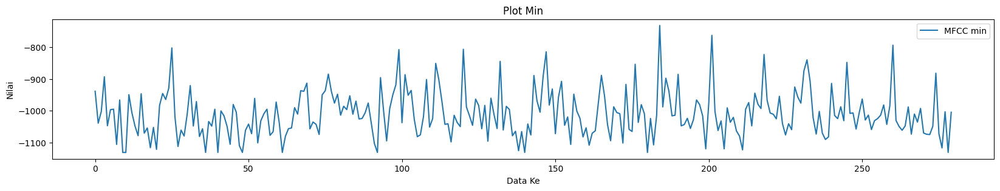

In [14]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_min.plot.line()

plt.title('Plot Min')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [15]:
mfcc_Med = []
for i in feature_mfcc_test:
  Med = np.median(i)
  mfcc_Med.append(Med)

Text(0.5, 0, 'Data Ke')

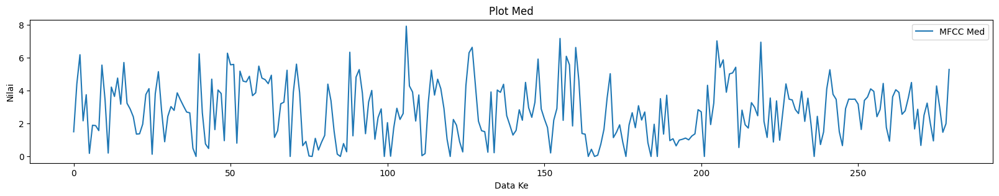

In [16]:
df_med = pd.DataFrame(mfcc_Med, columns=['MFCC Med']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_med.plot.line()

plt.title('Plot Med')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [17]:
mfcc_Var = []
for i in feature_mfcc_test:
  Var = np.var(i)
  mfcc_Var.append(Var)

Text(0.5, 0, 'Data Ke')

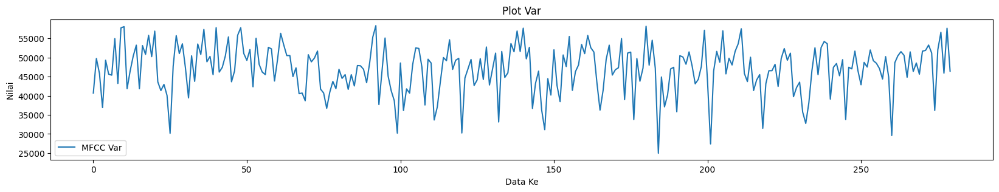

In [18]:
df_var = pd.DataFrame(mfcc_Var, columns=['MFCC Var']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_var.plot.line()

plt.title('Plot Var')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [19]:
from scipy.stats import skew

mfcc_Skew = []
for i in feature_mfcc_test:
  Skew = skew(i, axis=0, bias=True)
  mfcc_Skew.append(Skew)

In [20]:
skew_means = []
for i in mfcc_Skew:
  mean = np.mean(i)
  skew_means.append(mean)

Text(0.5, 0, 'Data Ke')

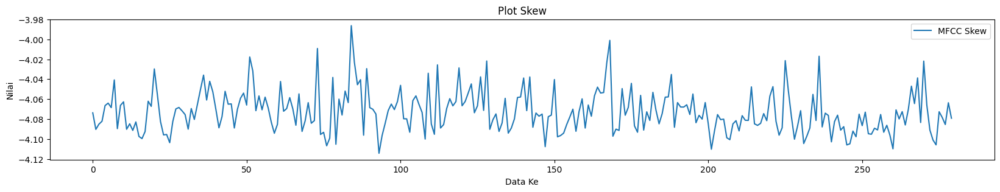

In [21]:
df_skew = pd.DataFrame(skew_means, columns=['MFCC Skew']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_skew.plot.line()

plt.title('Plot Skew')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [22]:
mfcc_Q1 = []
for i in feature_mfcc_test:
  Q1 = np.percentile(i, 25) 
  mfcc_Q1.append(Q1)

Text(0.5, 0, 'Data Ke')

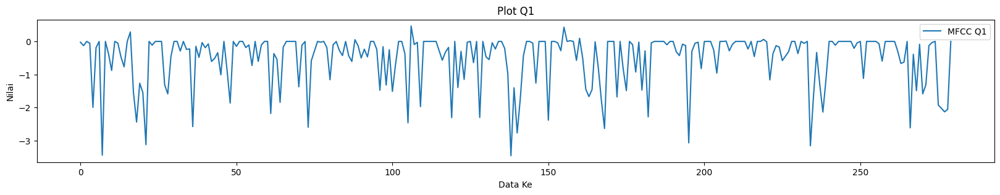

In [23]:
df_q1 = pd.DataFrame(mfcc_Q1, columns=['MFCC Q1']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_q1.plot.line()

plt.title('Plot Q1')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [24]:
mfcc_Q3 = []
for i in feature_mfcc_test:
  Q3 = np.percentile(i, 75) 
  mfcc_Q3.append(Q3)

Text(0.5, 0, 'Data Ke')

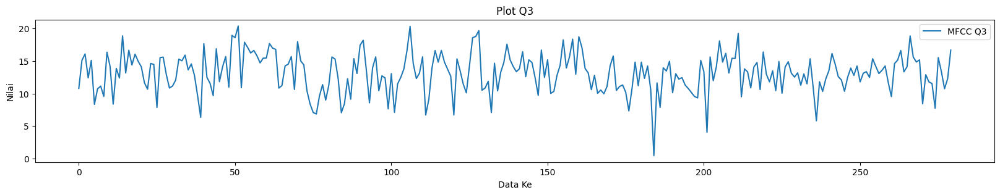

In [25]:
df_q3 = pd.DataFrame(mfcc_Q3, columns=['MFCC Q3']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_q3.plot.line()

plt.title('Plot Q3')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [26]:
mfcc_IQR = []
IQR = np.array(mfcc_Q3) - np.array(mfcc_Q1)
mfcc_IQR.append(IQR)

Text(0.5, 0, 'Data Ke')

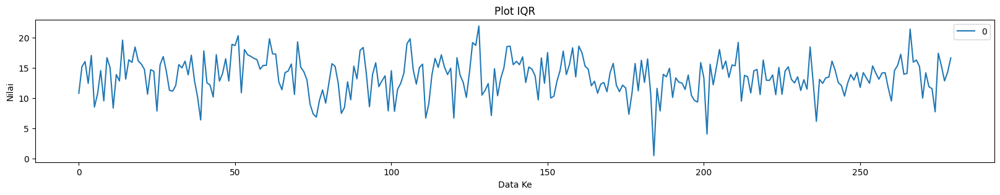

In [27]:
df_iqr = pd.DataFrame(mfcc_IQR)
df_iqr = df_iqr.transpose()
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_iqr.plot.line()

plt.title('Plot IQR')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [28]:
mfcc_range = []
Range = np.array(mfcc_max) - np.array(mfcc_min)
mfcc_range.append(Range)

Text(0.5, 0, 'Data Ke')

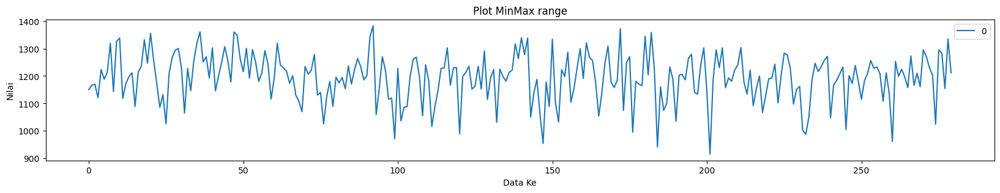

In [29]:
df_range = pd.DataFrame(mfcc_range)
df_range = df_range.transpose()
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_range.plot.line()

plt.title('Plot MinMax range')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [30]:
from scipy.stats import kurtosis

mfcc_Kurt = []
for i in feature_mfcc_test:
  Kurt = kurtosis(i, axis=0, bias=True)
  mfcc_Kurt.append(Kurt)

In [31]:
kurt_means = []
for i in mfcc_Kurt:
  mean = np.mean(i)
  kurt_means.append(mean)

Text(0.5, 0, 'Data Ke')

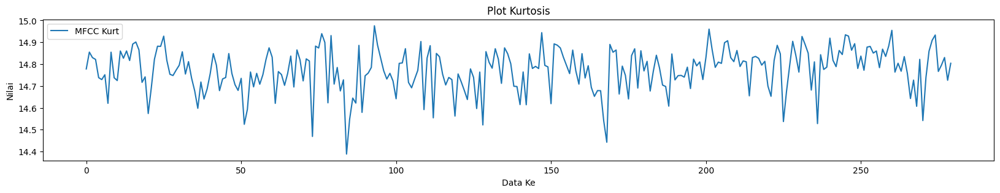

In [32]:
df_kurt = pd.DataFrame(kurt_means, columns=['MFCC Kurt']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_kurt.plot.line()

plt.title('Plot Kurtosis')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [33]:
df_mfcc_more = pd.DataFrame()

df_mfcc_more['Med_mfcc'] = df_med['MFCC Med']
df_mfcc_more['Var_mfcc'] = df_var['MFCC Var']
df_mfcc_more['Skew_mfcc'] = df_skew['MFCC Skew']
df_mfcc_more['Q1_mfcc'] = df_q1['MFCC Q1']
df_mfcc_more['Q3_mfcc'] = df_q3['MFCC Q3']
df_mfcc_more['IQR_mfcc'] = df_iqr[0]
df_mfcc_more['MinMax_mfcc'] = df_range[0]
df_mfcc_more['Kurt_mfcc'] = df_kurt['MFCC Kurt']
df_mfcc_more

,Med_mfcc,Var_mfcc,Skew_mfcc,Q1_mfcc,Q3_mfcc,IQR_mfcc,MinMax_mfcc,Kurt_mfcc
0,1.496959,40680.492188,-4.073761,-0.023774,10.781154,10.804928,1150.567993,14.778000
1,4.389492,49731.472656,-4.090363,-0.127517,15.089771,15.217288,1166.513794,14.854909
2,6.168247,45809.023438,-4.085119,0.000000,16.070771,16.070771,1170.359131,14.829740
3,2.161711,36902.257812,-4.082227,-0.054199,12.398919,12.453118,1120.957520,14.821513
4,3.742413,49277.964844,-4.066459,-1.993218,15.082847,17.076065,1223.821777,14.738121
...,...,...,...,...,...,...,...,...
275,4.274973,52014.468750,-4.072655,-1.924550,15.515649,17.440200,1295.316528,14.766532
276,2.974767,56573.382812,-4.078342,-2.022677,13.351013,15.373690,1283.219482,14.795278
277,1.466133,45899.976562,-4.085463,-2.129433,10.732589,12.862022,1154.620850,14.830208
278,1.983544,57641.683594,-4.063653,-2.052918,12.271097,14.324015,1335.279785,14.726191


### Entropy

In [34]:
from scipy.stats import entropy

def shannonenergycount(file_path):
    x,sample_rate = librosa.load(file_path, res_type='kaiser_fast')
    x_series = pd.Series(x)
    counts = x_series.value_counts()
    entropy_shanon = entropy(counts)
    return entropy_shanon

In [35]:
shanonenergy = []
shanonpath = MI_Denoised
for audio in os.listdir(shanonpath):
    audio_path = os.path.join(shanonpath, audio)
    results = shannonenergycount(audio_path)
    shanonenergy.append(results)

In [36]:
df_shanon_MI = pd.DataFrame({'Entropy' : shanonenergy})
df_shanon_MI.head(10)

,Entropy
0,13.400012
1,13.400133
2,13.399989
3,13.400480
4,13.399878
5,13.400107
6,13.400124
7,13.399989
8,13.399999
9,13.399978


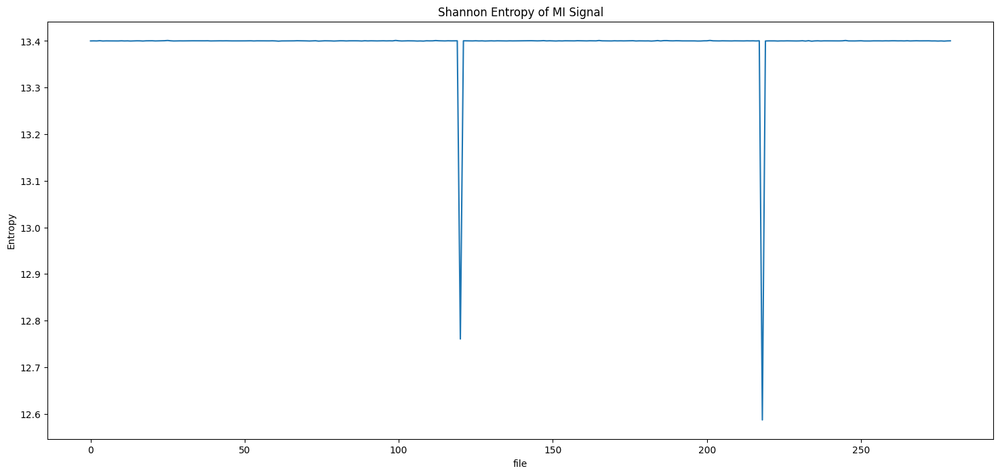

In [37]:
plt.figure(figsize=(18, 8))
plt.title("Shannon Entropy of MI Signal")
plt.plot(df_shanon_MI)
plt.ylabel('Entropy')
plt.xlabel('file')
plt.show()

### Wavelet

In [38]:
def wavelet_extraction(data, coeff, dwt, db, level):
    N = np.array(data).size
    a, ds = dwt[0], list(reversed(dwt[1:]))

    if coeff =='a':
        return pywt.upcoef('a', a, db, level=level)[:N]
    elif coeff == 'd':
        return pywt.upcoef('d', ds[level-1], db, level=level)[:N]
    else:
        raise ValueError("Invalid coefficients: {}".format(coeff))

In [39]:
features_wavelet = []
wavelet_file = []
count = 1
db = 'db2'
level = 4
directory = MI_Denoised
for audio in os.listdir(directory):
    audio_path = os.path.join(directory, audio)
    data_wave, sr = librosa.load(audio_path, res_type='kaiser_fast')
    coeffs = pywt.wavedec(data_wave, db, level=level)
    A4 = wavelet_extraction(data_wave, 'a', coeffs, db, level)
    D4 = wavelet_extraction(data_wave, 'd', coeffs, db, level)
    D3 = wavelet_extraction(data_wave, 'd', coeffs, db, 3)
    D2 = wavelet_extraction(data_wave, 'd', coeffs, db, 2)
    D1 = wavelet_extraction(data_wave, 'd', coeffs, db, 1)
    wavelets = A4 + D4 + D3 + D2 + D1
    file_name = "Extracted_wavelet_MI_%s.csv" % count
    pd.DataFrame(wavelets).to_csv(file_name)
    wavelet_file.append(file_name)
    features_wavelet.append(wavelets)
    count = count+1

In [40]:
import os
import shutil

# Definisikan base_path dan jalur folder tempat file hasil
base_path = r"C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection"

# Folder baru untuk memindahkan file
new_folder_name = "Feature_Extraction_Wavelete_MI"
new_folder_path = os.path.join(base_path, new_folder_name)

# Buat folder baru jika belum ada
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)

# Daftar file yang ingin dipindahkan
file_prefix = "Extracted_wavelet_MI_"
file_extension = ".csv"

# Iterasi melalui file dengan nama sesuai prefix
for i in range(1, 281):  # Asumsikan ada 280 file
    file_name = f"{file_prefix}{i}{file_extension}"
    file_path = os.path.join(base_path, file_name)
    
    # Periksa apakah file ada
    if os.path.isfile(file_path):
        # Tentukan jalur tujuan
        destination_path = os.path.join(new_folder_path, file_name)
        
        # Pindahkan file
        shutil.move(file_path, destination_path)
        print(f"Moved {file_path} to {destination_path}")
    else:
        print(f"File not found: {file_path}")

print("File move complete.")

Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_MI_1.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_MI\Extracted_wavelet_MI_1.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_MI_2.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_MI\Extracted_wavelet_MI_2.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_MI_3.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_MI\Extracted_wavelet_MI_3.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_MI_4.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_MI\Extracted_wavelet_MI_4.csv
Moved C:\Users\a

In [41]:
features_wavelet

[array([-9.6095260e-05, -1.6644188e-04, -1.8375475e-04, ...,
         1.2014619e-04,  1.4955610e-04,  1.3362583e-04], dtype=float32),
 array([-2.4125214e-04, -4.1786098e-04, -3.7182288e-04, ...,
        -3.6015612e-05, -4.3603104e-05, -7.3230265e-05], dtype=float32),
 array([-1.9640933e-05, -3.4019096e-05, -5.7602028e-05, ...,
         2.3821733e-05,  1.5946149e-05,  5.5041437e-05], dtype=float32),
 array([-4.1513165e-05, -7.1902927e-05, -8.5464235e-05, ...,
         2.1294614e-05,  1.1967618e-05, -6.4685996e-06], dtype=float32),
 array([-3.3131965e-07, -5.7386245e-07, -1.0114877e-07, ...,
         2.8294877e-05,  2.5649568e-05,  2.2389957e-05], dtype=float32),
 array([1.6513975e-05, 2.8603044e-05, 2.4733265e-05, ..., 2.6777058e-04,
        2.3077338e-04, 1.1331238e-04], dtype=float32),
 array([-1.4264105e-05, -2.4706158e-05, -3.4729455e-06, ...,
         1.9995274e-03,  1.8715132e-03,  1.4239444e-03], dtype=float32),
 array([-1.16168585e-05, -2.01209932e-05, -2.61693967e-05, ...,
    

In [42]:
path = os.path.join(MI_Denoised, audio)

In [43]:
data_wave, sr = librosa.load(path, res_type='kaiser_fast')
coeffs = pywt.wavedec(data_wave, db, level=level)
A4 = wavelet_extraction(data_wave, 'a', coeffs, db, level)
D4 = wavelet_extraction(data_wave, 'd', coeffs, db, level)
D3 = wavelet_extraction(data_wave, 'd', coeffs, db, 3)
D2 = wavelet_extraction(data_wave, 'd', coeffs, db, 2)
D1 = wavelet_extraction(data_wave, 'd', coeffs, db, 1)
wavelets = A4 + D4 + D3 + D2 + D1

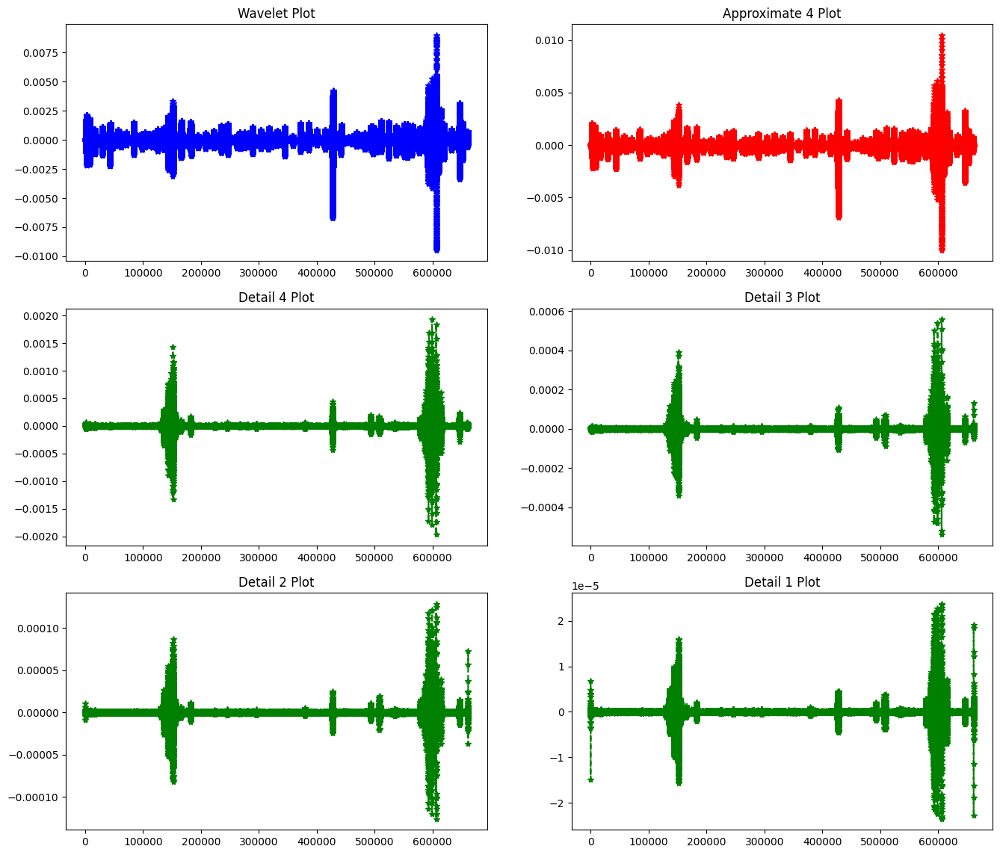

In [44]:
figure, axis = plt.subplots(3, 2, figsize=(16,14))
  
axis[0, 0].plot(wavelets, '--*b')
axis[0, 0].set_title("Wavelet Plot")
  
axis[0, 1].plot(A4, '--*r')
axis[0, 1].set_title("Approximate 4 Plot")
  
axis[1, 0].plot(D4, '--*g')
axis[1, 0].set_title("Detail 4 Plot")

axis[1, 1].plot(D3, '--*g')
axis[1, 1].set_title("Detail 3 Plot")

axis[2, 0].plot(D2, '--*g')
axis[2, 0].set_title("Detail 2 Plot")

axis[2, 1].plot(D1, '--*g')
axis[2, 1].set_title("Detail 1 Plot")

plt.show()

#### Wavelet Means

In [45]:
wavelet_means = []
for i in features_wavelet:
  mean = np.mean(i,dtype=np.float64)
  wavelet_means.append(mean)

df_wavelet_means = pd.DataFrame({'Wavelet Means' : wavelet_means})
df_wavelet_means.head(10)

,Wavelet Means
0,-7.728091e-08
1,-1.878137e-08
2,2.572571e-08
3,4.358653e-08
4,-2.001091e-08
5,-4.345530e-08
6,-1.638035e-07
7,1.804379e-08
8,3.079684e-09
9,2.384580e-08


#### Wavelet Std

In [46]:
wavelet_std = []
for i in features_wavelet:
  std = np.std(i)
  wavelet_std.append(std)

df_wavelet_std = pd.DataFrame({'Wavelet std' : wavelet_std})
df_wavelet_std.head(10)

,Wavelet std
0,0.000306
1,0.000246
2,0.000447
3,0.001195
4,0.000272
5,0.000363
6,0.000305
7,0.000200
8,0.000372
9,0.000095


#### Wavelet Max

In [47]:
wavelet_max = []
for i in features_wavelet:
  max = np.max(i)
  wavelet_max.append(max)

df_wavelet_max = pd.DataFrame({'Wavelet max' : wavelet_max})
df_wavelet_max.head(10)

,Wavelet max
0,0.011636
1,0.002946
2,0.005566
3,0.038946
4,0.004847
5,0.006203
6,0.008979
7,0.002742
8,0.009226
9,0.001392


#### Wavelet Min

In [55]:
wavelet_min = []
for i in features_wavelet:
  Min = np.min(i)
  wavelet_min.append(Min)

df_wavelet_min = pd.DataFrame({'Wavelet min' : wavelet_min})
df_wavelet_min.head(10)

,Wavelet min
0,-0.010880
1,-0.003826
2,-0.005214
3,-0.026688
4,-0.005081
5,-0.005954
6,-0.009689
7,-0.003223
8,-0.010344
9,-0.001437


In [56]:
wavelet_Med = []
for i in features_wavelet:
  Med = np.median(i)
  wavelet_Med.append(Med)

In [57]:
df_med = pd.DataFrame(wavelet_Med, columns=['Wav Med']) 
df_med

,Wav Med
0,-1.147631e-08
1,-3.155773e-09
2,1.332484e-08
3,2.578417e-09
4,5.775855e-09
...,...
275,1.826697e-08
276,-8.562095e-09
277,1.731472e-08
278,-1.295093e-09


In [58]:
wavelet_Var = []
for i in features_wavelet:
  Var = np.var(i)
  wavelet_Var.append(Var)

In [59]:
df_var = pd.DataFrame(wavelet_Var, columns=['Wav Var']) 
df_var

,Wav Var
0,9.356884e-08
1,6.055543e-08
2,2.000804e-07
3,1.427957e-06
4,7.417933e-08
...,...
275,2.481067e-08
276,1.785476e-08
277,3.796947e-08
278,1.205511e-08


In [60]:
from scipy.stats import skew

wavelet_Skew = []
for i in features_wavelet:
  Skew = skew(i, axis=0, bias=True)
  wavelet_Skew.append(Skew)

In [61]:
skew_means = []
for i in wavelet_Skew:
  mean = np.mean(i)
  skew_means.append(mean)

In [62]:
df_skew = pd.DataFrame(skew_means, columns=['Wav Skew']) 
df_skew

,Wav Skew
0,1.613227
1,-0.641351
2,-0.507514
3,3.953869
4,-0.002854
...,...
275,-1.830285
276,0.960469
277,2.413781
278,-0.337720


In [63]:
wavelet_Q1 = []
for i in features_wavelet:
  Q1 = np.percentile(i, 25) 
  wavelet_Q1.append(Q1)

In [64]:
df_q1 = pd.DataFrame(wavelet_Q1, columns=['Wav Q1']) 
df_q1

,Wav Q1
0,-0.000007
1,-0.000006
2,-0.000010
3,-0.000010
4,-0.000008
...,...
275,-0.000008
276,-0.000004
277,-0.000006
278,-0.000004


In [65]:
wavelet_Q3 = []
for i in features_wavelet:
  Q3 = np.percentile(i, 75) 
  wavelet_Q3.append(Q3)

In [66]:
df_q3 = pd.DataFrame(wavelet_Q3, columns=['Wav Q3']) 
df_q3

,Wav Q3
0,0.000007
1,0.000006
2,0.000010
3,0.000011
4,0.000008
...,...
275,0.000008
276,0.000004
277,0.000007
278,0.000004


In [67]:
wavelet_IQR = []
IQR = np.array(wavelet_Q3) - np.array(wavelet_Q1)
wavelet_IQR.append(IQR)

In [68]:
df_iqr = pd.DataFrame(wavelet_IQR)
df_iqr = df_iqr.transpose()

In [69]:
wavelet_range = []
Range = np.array(wavelet_max) - np.array(wavelet_min)
wavelet_range.append(Range)

In [70]:
df_range = pd.DataFrame(wavelet_range)
df_range = df_range.transpose()

In [71]:
from scipy.stats import kurtosis

wavelet_Kurt = []
for i in features_wavelet:
  Kurt = kurtosis(i, axis=0, bias=True)
  wavelet_Kurt.append(Kurt)

In [72]:
kurt_means = []
for i in wavelet_Kurt:
  mean = np.mean(i)
  kurt_means.append(mean)

In [73]:
df_kurt = pd.DataFrame(kurt_means, columns=['Wav Kurt']) 
df_kurt

,Wav Kurt
0,418.606333
1,41.560283
2,29.429487
3,236.341009
4,41.556179
...,...
275,65.836710
276,55.845105
277,375.537171
278,81.082611


In [74]:
df_wavelet = pd.DataFrame()

df_wavelet['Med_wavelet'] = df_med['Wav Med']
df_wavelet['Var_wavelet'] = df_var['Wav Var']
df_wavelet['Skew_wavelet'] = df_skew['Wav Skew']
df_wavelet['Q1_wavelet'] = df_q1['Wav Q1']
df_wavelet['Q3_wavelet'] = df_q3['Wav Q3']
df_wavelet['IQR_wavelet'] = df_iqr[0]
df_wavelet['MinMax_wavelet'] = df_range[0]
df_wavelet['Kurt_wavelet'] = df_kurt['Wav Kurt']
df_wavelet

,Med_wavelet,Var_wavelet,Skew_wavelet,Q1_wavelet,Q3_wavelet,IQR_wavelet,MinMax_wavelet,Kurt_wavelet
0,-1.147631e-08,9.356884e-08,1.613227,-0.000007,0.000007,0.000014,0.022515,418.606333
1,-3.155773e-09,6.055543e-08,-0.641351,-0.000006,0.000006,0.000012,0.006772,41.560283
2,1.332484e-08,2.000804e-07,-0.507514,-0.000010,0.000010,0.000020,0.010779,29.429487
3,2.578417e-09,1.427957e-06,3.953869,-0.000010,0.000011,0.000021,0.065634,236.341009
4,5.775855e-09,7.417933e-08,-0.002854,-0.000008,0.000008,0.000016,0.009928,41.556179
...,...,...,...,...,...,...,...,...
275,1.826697e-08,2.481067e-08,-1.830285,-0.000008,0.000008,0.000016,0.010824,65.836710
276,-8.562095e-09,1.785476e-08,0.960469,-0.000004,0.000004,0.000007,0.004879,55.845105
277,1.731472e-08,3.796947e-08,2.413781,-0.000006,0.000007,0.000013,0.013367,375.537171
278,-1.295093e-09,1.205511e-08,-0.337720,-0.000004,0.000004,0.000007,0.005612,81.082611


### Combine Features

In [75]:
label = []
annotation = []
for i in range (280):
  annotation.append(1)
  label.append("MI")

In [76]:
df_label = pd.DataFrame({'Label' : label})
df_label.head(10)

,Label
0,MI
1,MI
2,MI
3,MI
4,MI
5,MI
6,MI
7,MI
8,MI
9,MI


In [77]:
df_annotation = pd.DataFrame({'Annotation' : annotation})
df_annotation.head(10)

,Annotation
0,1
1,1
2,1
3,1
4,1
5,1
6,1
7,1
8,1
9,1


In [78]:
df_features_MI = pd.concat([df_mfcc_means, df_mfcc_std, df_mfcc_max,df_mfcc_min,
                                df_shanon_MI,
                                df_wavelet_means,df_wavelet_std,df_wavelet_max,df_wavelet_min,
                                df_mfcc_more,df_wavelet,
                                df_annotation,df_label], axis=1)

In [79]:
file_name = 'feature_MI_more.xlsx'
df_features_MI.to_excel(file_name)
print('DataFrame is written to Excel File successfully.')

DataFrame is written to Excel File successfully.


## NORMAL Dataset Feature Extraction

### MFCC

In [80]:
def feature_extraction(file_path):
    x, sample_rate = librosa.load(file_path, res_type='kaiser_fast')
    mfcc = librosa.feature.mfcc(y = x, sr = sample_rate)
    return mfcc

In [81]:
features = {}
feature_mfcc_test = []
directory = NORMAL_Denoised

for audio in os.listdir(directory):
    audio_path = os.path.join(directory, audio)  # Menggunakan os.path.join untuk menggabungkan direktori dan nama file
    if os.path.isfile(audio_path):
        features[audio_path] = feature_extraction(audio_path)
        feature_mfcc_test.append(feature_extraction(audio_path))
    else:
        print(f"File not found: {audio_path}")

In [82]:
label = []
annotation = []
for i in range (280):
  annotation.append(0)
  label.append("NORMAL")

#### MFCC Mean

In [83]:
mfcc_means = []
for i in feature_mfcc_test:
  mean = np.mean(i,dtype=np.float64)
  mfcc_means.append(mean)

df_mfcc_means = pd.DataFrame({'MFCC Means' : mfcc_means})
df_mfcc_means

,MFCC Means
0,-41.791308
1,-38.843580
2,-35.834444
3,-32.477081
4,-38.784350
...,...
275,-40.171440
276,-34.351629
277,-37.142624
278,-36.267398


#### MFCC Std

In [84]:
mfcc_std = []
for i in feature_mfcc_test:
  std = np.std(i)
  mfcc_std.append(std)

df_mfcc_std = pd.DataFrame({'MFCC std' : mfcc_std})
df_mfcc_std

,MFCC std
0,224.152893
1,207.677048
2,206.253281
3,190.572937
4,215.776031
...,...
275,212.366180
276,191.448502
277,206.061218
278,211.922684


#### MFCC Max

In [85]:
mfcc_max = []
for i in feature_mfcc_test:
  max = np.max(i)
  mfcc_max.append(max)

df_mfcc_max = pd.DataFrame({'MFCC max' : mfcc_max})
df_mfcc_max

,MFCC max
0,192.087341
1,211.392212
2,189.915009
3,169.023193
4,184.020935
...,...
275,177.526321
276,235.921875
277,203.988678
278,150.811371


#### MFCC Min

In [87]:
mfcc_min = []
for i in feature_mfcc_test:
  Min = np.min(i)
  mfcc_min.append(Min)

df_mfcc_min = pd.DataFrame({'MFCC min' : mfcc_min})
df_mfcc_min

,MFCC min
0,-1049.769653
1,-969.822021
2,-957.091431
3,-886.641296
4,-1014.367126
...,...
275,-984.905029
276,-897.360107
277,-967.146240
278,-994.028564


In [88]:
mfcc_Med = []
for i in feature_mfcc_test:
  Med = np.median(i)
  mfcc_Med.append(Med)

Text(0.5, 0, 'Data Ke')

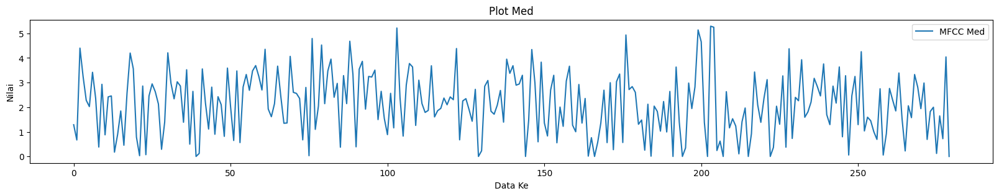

In [89]:
df_med = pd.DataFrame(mfcc_Med, columns=['MFCC Med']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_med.plot.line()

plt.title('Plot Med')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [90]:
mfcc_Var = []
for i in feature_mfcc_test:
  Var = np.var(i)
  mfcc_Var.append(Var)

Text(0.5, 0, 'Data Ke')

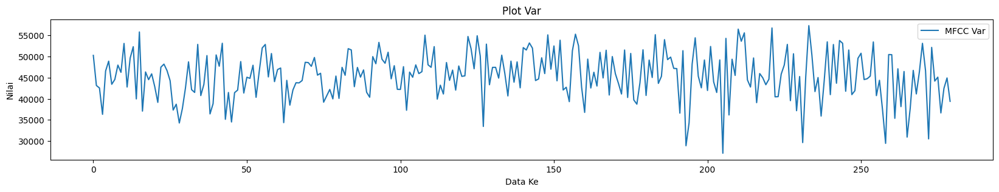

In [91]:
df_var = pd.DataFrame(mfcc_Var, columns=['MFCC Var']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_var.plot.line()

plt.title('Plot Var')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [92]:
from scipy.stats import skew

mfcc_Skew = []
for i in feature_mfcc_test:
  Skew = skew(i, axis=0, bias=True)
  mfcc_Skew.append(Skew)

In [93]:
skew_means = []
for i in mfcc_Skew:
  mean = np.mean(i)
  skew_means.append(mean)

Text(0.5, 0, 'Data Ke')

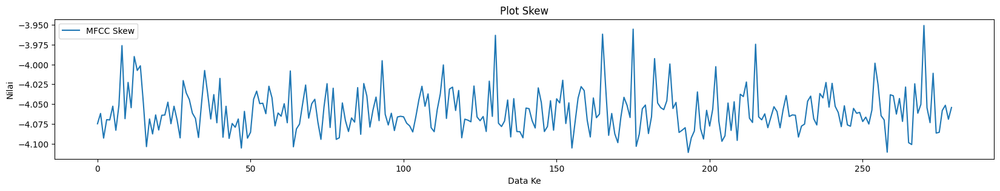

In [94]:
df_skew = pd.DataFrame(skew_means, columns=['MFCC Skew']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_skew.plot.line()

plt.title('Plot Skew')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [95]:
mfcc_Q1 = []
for i in feature_mfcc_test:
  Q1 = np.percentile(i, 25) 
  mfcc_Q1.append(Q1)

Text(0.5, 0, 'Data Ke')

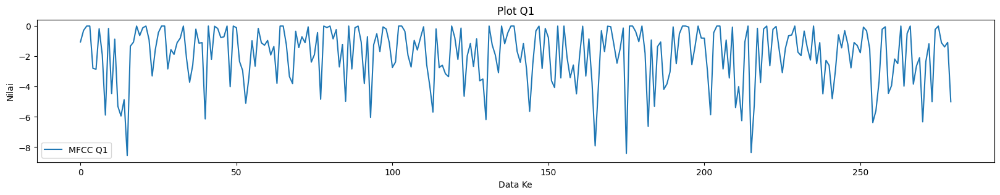

In [96]:
df_q1 = pd.DataFrame(mfcc_Q1, columns=['MFCC Q1']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_q1.plot.line()

plt.title('Plot Q1')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [97]:
mfcc_Q3 = []
for i in feature_mfcc_test:
  Q3 = np.percentile(i, 75) 
  mfcc_Q3.append(Q3)

Text(0.5, 0, 'Data Ke')

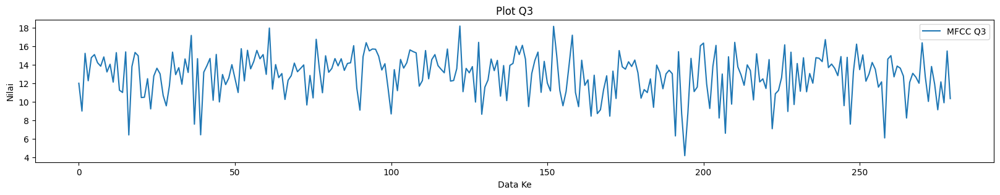

In [98]:
df_q3 = pd.DataFrame(mfcc_Q3, columns=['MFCC Q3']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_q3.plot.line()

plt.title('Plot Q3')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [99]:
mfcc_IQR = []
IQR = np.array(mfcc_Q3) - np.array(mfcc_Q1)
mfcc_IQR.append(IQR)

Text(0.5, 0, 'Data Ke')

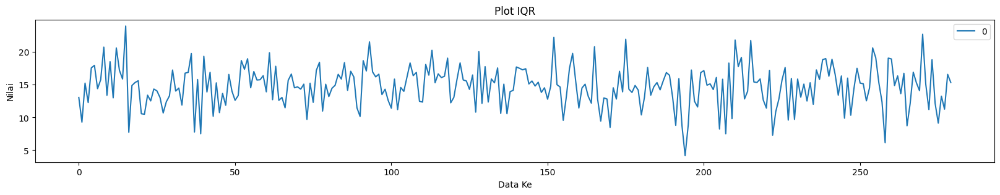

In [100]:
df_iqr = pd.DataFrame(mfcc_IQR)
df_iqr = df_iqr.transpose()
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_iqr.plot.line()

plt.title('Plot IQR')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [101]:
mfcc_range = []
Range = np.array(mfcc_max) - np.array(mfcc_min)
mfcc_range.append(Range)

Text(0.5, 0, 'Data Ke')

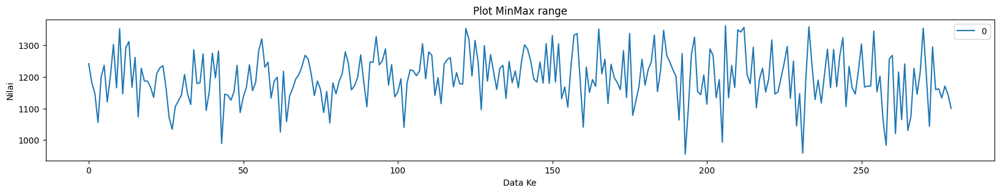

In [102]:
df_range = pd.DataFrame(mfcc_range)
df_range = df_range.transpose()
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_range.plot.line()

plt.title('Plot MinMax range')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [103]:
from scipy.stats import kurtosis

mfcc_Kurt = []
for i in feature_mfcc_test:
  Kurt = kurtosis(i, axis=0, bias=True)
  mfcc_Kurt.append(Kurt)

In [104]:
kurt_means = []
for i in mfcc_Kurt:
  mean = np.mean(i)
  kurt_means.append(mean)

Text(0.5, 0, 'Data Ke')

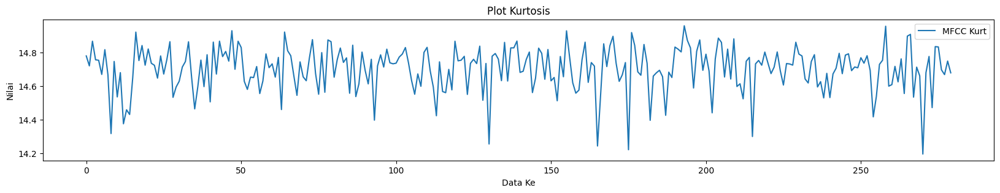

In [105]:
df_kurt = pd.DataFrame(kurt_means, columns=['MFCC Kurt']) 
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_kurt.plot.line()

plt.title('Plot Kurtosis')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

In [106]:
df_mfcc_more = pd.DataFrame()

df_mfcc_more['Med_mfcc'] = df_med['MFCC Med']
df_mfcc_more['Var_mfcc'] = df_var['MFCC Var']
df_mfcc_more['Skew_mfcc'] = df_skew['MFCC Skew']
df_mfcc_more['Q1_mfcc'] = df_q1['MFCC Q1']
df_mfcc_more['Q3_mfcc'] = df_q3['MFCC Q3']
df_mfcc_more['IQR_mfcc'] = df_iqr[0]
df_mfcc_more['MinMax_mfcc'] = df_range[0]
df_mfcc_more['Kurt_mfcc'] = df_kurt['MFCC Kurt']
df_mfcc_more

,Med_mfcc,Var_mfcc,Skew_mfcc,Q1_mfcc,Q3_mfcc,IQR_mfcc,MinMax_mfcc,Kurt_mfcc
0,1.288125,50244.519531,-4.074857,-1.049831,12.010599,13.060430,1241.856934,14.781048
1,0.669153,43129.757812,-4.061845,-0.290932,9.001309,9.292241,1181.214233,14.721545
2,4.399808,42540.414062,-4.092953,0.000000,15.245405,15.245405,1147.006470,14.868887
3,3.243650,36318.046875,-4.069677,0.000000,12.282128,12.282128,1055.664551,14.757767
4,2.281103,46559.292969,-4.070056,-2.792319,14.783343,17.575662,1198.388062,14.754958
...,...,...,...,...,...,...,...,...
275,0.121728,45099.394531,-4.085628,0.000000,9.139450,9.139450,1162.431396,14.834737
276,1.646094,36652.531250,-4.058027,-1.096500,12.158696,13.255196,1133.281982,14.698023
277,0.721306,42461.222656,-4.051522,-1.374540,9.898527,11.273068,1171.134888,14.669204
278,4.042179,44911.222656,-4.069168,-1.082121,15.501710,16.583831,1144.839966,14.750266


#### MFCC Plot

Text(0.5, 0, 'Data Ke')

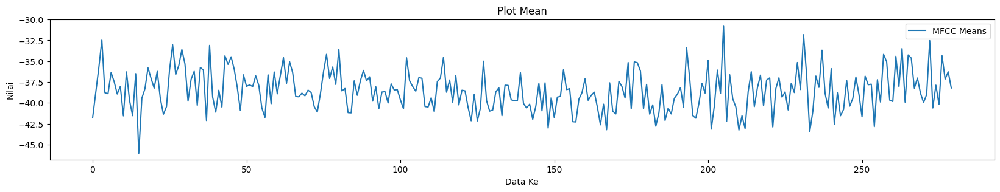

In [107]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_means.plot.line()

plt.title('Plot Mean')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

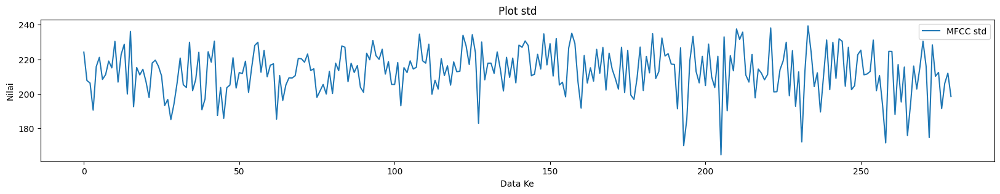

In [108]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_std.plot.line()

plt.title('Plot std')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

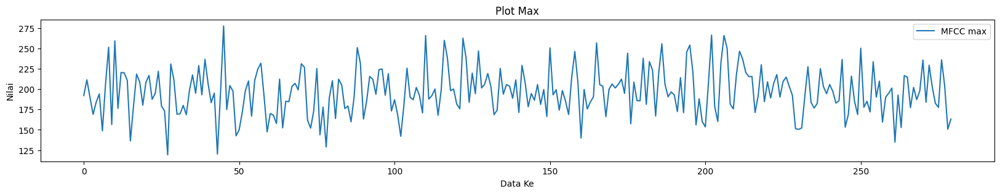

In [109]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_max.plot.line()

plt.title('Plot Max')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

Text(0.5, 0, 'Data Ke')

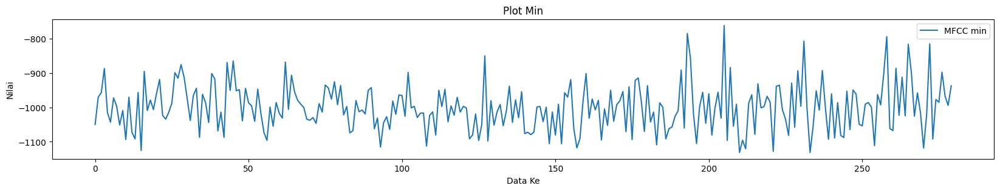

In [110]:
plt.rcParams["figure.figsize"] = (20,3)

lines1 = df_mfcc_min.plot.line()

plt.title('Plot Min')
plt.ylabel('Nilai')
plt.xlabel('Data Ke')

### Entropy

In [111]:
from scipy.stats import entropy

def shannonenergycount(file_path):
    x,sample_rate = librosa.load(file_path, res_type='kaiser_fast')
    x_series = pd.Series(x)
    counts = x_series.value_counts()
    entropy_shanon = entropy(counts)
    return entropy_shanon

In [112]:
shanonenergy = []
shanonpath = NORMAL_Denoised
for audio in os.listdir(shanonpath):
    audio_path = os.path.join(shanonpath, audio)
    results = shannonenergycount(audio_path)
    shanonenergy.append(results)

In [113]:
df_shanon_normal = pd.DataFrame({'Entropy' : shanonenergy})
df_shanon_normal.head(10)

,Entropy
0,13.400151
1,13.400158
2,13.400238
3,13.401101
4,13.399933
5,13.400186
6,13.400167
7,13.400267
8,13.399883
9,13.400370


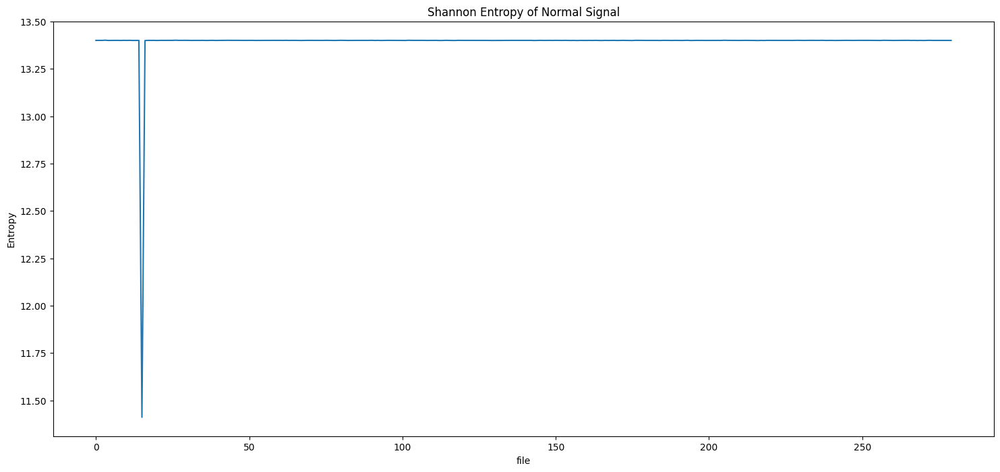

In [114]:
plt.figure(figsize=(18, 8))
plt.title("Shannon Entropy of Normal Signal")
plt.plot(df_shanon_normal)
plt.ylabel('Entropy')
plt.xlabel('file')
plt.show()

### Wavelete

In [115]:
def wavelet_extraction(data, coeff, dwt, db, level):
    N = np.array(data).size
    a, ds = dwt[0], list(reversed(dwt[1:]))

    if coeff =='a':
        return pywt.upcoef('a', a, db, level=level)[:N]
    elif coeff == 'd':
        return pywt.upcoef('d', ds[level-1], db, level=level)[:N]
    else:
        raise ValueError("Invalid coefficients: {}".format(coeff))

In [116]:
features_wavelet = []
wavelet_file = []
count = 1
db = 'db2'
level = 4
directory = NORMAL_Denoised
for audio in os.listdir(directory):
    audio_path = os.path.join(directory, audio)
    data_wave, sr = librosa.load(audio_path, res_type='kaiser_fast')
    coeffs = pywt.wavedec(data_wave, db, level=level)
    A4 = wavelet_extraction(data_wave, 'a', coeffs, db, level)
    D4 = wavelet_extraction(data_wave, 'd', coeffs, db, level)
    D3 = wavelet_extraction(data_wave, 'd', coeffs, db, 3)
    D2 = wavelet_extraction(data_wave, 'd', coeffs, db, 2)
    D1 = wavelet_extraction(data_wave, 'd', coeffs, db, 1)
    wavelets = A4 + D4 + D3 + D2 + D1
    file_name = "Extracted_wavelet_N_%s.csv" % count
    pd.DataFrame(wavelets).to_csv(file_name)
    wavelet_file.append(file_name)
    features_wavelet.append(wavelets)
    count = count+1

In [117]:
import os
import shutil

# Definisikan base_path dan jalur folder tempat file hasil
base_path = r"C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection"

# Folder baru untuk memindahkan file
new_folder_name = "Feature_Extraction_Wavelete_NORMAL"
new_folder_path = os.path.join(base_path, new_folder_name)

# Buat folder baru jika belum ada
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)

# Daftar file yang ingin dipindahkan
file_prefix = "Extracted_wavelet_N_"
file_extension = ".csv"

# Iterasi melalui file dengan nama sesuai prefix
for i in range(1, 281):  # Asumsikan ada 280 file
    file_name = f"{file_prefix}{i}{file_extension}"
    file_path = os.path.join(base_path, file_name)
    
    # Periksa apakah file ada
    if os.path.isfile(file_path):
        # Tentukan jalur tujuan
        destination_path = os.path.join(new_folder_path, file_name)
        
        # Pindahkan file
        shutil.move(file_path, destination_path)
        print(f"Moved {file_path} to {destination_path}")
    else:
        print(f"File not found: {file_path}")

print("File move complete.")

Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_N_1.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_NORMAL\Extracted_wavelet_N_1.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_N_2.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_NORMAL\Extracted_wavelet_N_2.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_N_3.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_NORMAL\Extracted_wavelet_N_3.csv
Moved C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Extracted_wavelet_N_4.csv to C:\Users\asus\Downloads\Proyek Riset\Proyek Myocardial Infarction Detection\Feature_Extraction_Wavelete_NORMAL\Extracted_wavelet_N_4.csv
Moved C:

In [118]:
features_wavelet

[array([-1.4959346e-05, -2.5910349e-05, -1.6352533e-06, ...,
         1.8148725e-07,  1.6892183e-07,  2.6186521e-07], dtype=float32),
 array([-7.26782673e-05, -1.25882449e-04, -1.76726520e-04, ...,
         3.80079996e-06,  1.26141895e-05,  2.64843820e-05], dtype=float32),
 array([-7.6167067e-05, -1.3192523e-04, -5.8912265e-05, ...,
         2.8090124e-06,  4.3527889e-06,  7.5139606e-06], dtype=float32),
 array([-2.2489186e-04, -3.8952412e-04, -2.1828960e-04, ...,
        -1.8304194e-05, -3.2453539e-05, -5.6375400e-05], dtype=float32),
 array([ 5.9220392e-06,  1.0257272e-05,  1.3939983e-05, ...,
        -2.7478577e-06, -4.0921313e-06, -5.9507265e-06], dtype=float32),
 array([-7.9830879e-06, -1.3827114e-05,  5.2358700e-08, ...,
        -2.7419206e-05, -2.5591571e-05, -4.1733649e-05], dtype=float32),
 array([-6.9647285e-05, -1.2063264e-04, -1.5695654e-04, ...,
         1.9827286e-05,  1.0861832e-05,  1.9861145e-05], dtype=float32),
 array([2.0551061e-05, 3.5595483e-05, 1.0916119e-07, ...

In [119]:
path = os.path.join(NORMAL_Denoised, audio)

In [120]:
data_wave, sr = librosa.load(path, res_type='kaiser_fast')
coeffs = pywt.wavedec(data_wave, db, level=level)
A4 = wavelet_extraction(data_wave, 'a', coeffs, db, level)
D4 = wavelet_extraction(data_wave, 'd', coeffs, db, level)
D3 = wavelet_extraction(data_wave, 'd', coeffs, db, 3)
D2 = wavelet_extraction(data_wave, 'd', coeffs, db, 2)
D1 = wavelet_extraction(data_wave, 'd', coeffs, db, 1)
wavelets = A4 + D4 + D3 + D2 + D1

Text(0.5, 1.0, 'Detail 1 Plot')

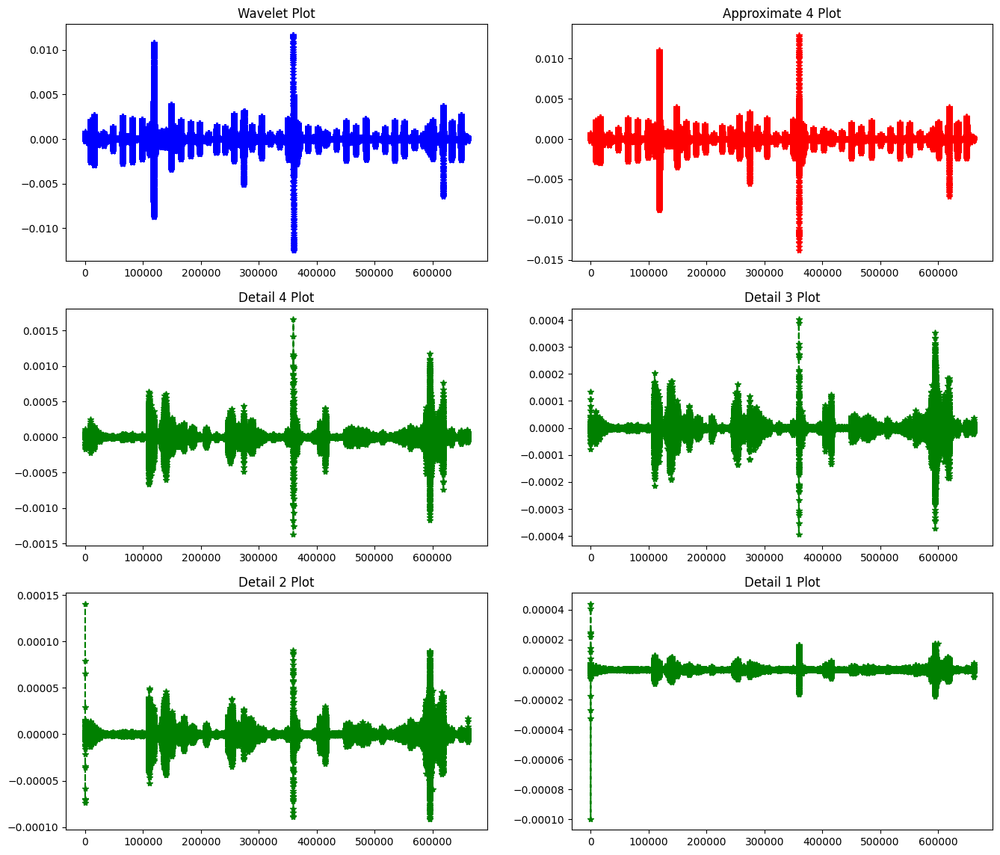

In [121]:
figure, axis = plt.subplots(3, 2, figsize=(16,14))
  
axis[0, 0].plot(wavelets, '--*b')
axis[0, 0].set_title("Wavelet Plot")
  
axis[0, 1].plot(A4, '--*r')
axis[0, 1].set_title("Approximate 4 Plot")
  
axis[1, 0].plot(D4, '--*g')
axis[1, 0].set_title("Detail 4 Plot")

axis[1, 1].plot(D3, '--*g')
axis[1, 1].set_title("Detail 3 Plot")

axis[2, 0].plot(D2, '--*g')
axis[2, 0].set_title("Detail 2 Plot")

axis[2, 1].plot(D1, '--*g')
axis[2, 1].set_title("Detail 1 Plot")

#### Wavelet Means

In [122]:
wavelet_means = []
for i in features_wavelet:
  mean = np.mean(i,dtype=np.float64)
  wavelet_means.append(mean)

df_wavelet_means = pd.DataFrame({'Wavelet Means' : wavelet_means})
df_wavelet_means.head(10)

,Wavelet Means
0,5.728823e-09
1,-2.098929e-09
2,-5.953638e-08
3,-2.032488e-07
4,-3.745872e-08
5,-1.845816e-08
6,-9.430086e-09
7,1.529748e-07
8,7.469474e-09
9,3.959629e-09


#### Wavelet Std

In [123]:
wavelet_std = []
for i in features_wavelet:
  std = np.std(i)
  wavelet_std.append(std)

df_wavelet_std = pd.DataFrame({'Wavelet std' : wavelet_std})
df_wavelet_std.head(10)

,Wavelet std
0,0.000222
1,0.000608
2,0.000962
3,0.001657
4,0.000423
5,0.000330
6,0.000858
7,0.000373
8,0.000290
9,0.000544


#### Wavelet Max

In [124]:
wavelet_max = []
for i in features_wavelet:
  max = np.max(i)
  wavelet_max.append(max)

df_wavelet_max = pd.DataFrame({'Wavelet max' : wavelet_max})
df_wavelet_max.head(10)

,Wavelet max
0,0.005881
1,0.018272
2,0.007964
3,0.015475
4,0.005626
5,0.006878
6,0.007549
7,0.008485
8,0.005340
9,0.004125


#### Wavelet Min

In [125]:
wavelet_min = []
for i in features_wavelet:
  Min = np.min(i)
  wavelet_min.append(Min)

df_wavelet_min = pd.DataFrame({'Wavelet min' : wavelet_min})
df_wavelet_min.head(10)

,Wavelet min
0,-0.007733
1,-0.024981
2,-0.008737
3,-0.017782
4,-0.005337
5,-0.008372
6,-0.008340
7,-0.006825
8,-0.005133
9,-0.005868


### Combine Features

In [131]:
label = []
annotation = []
for i in range (280):
  annotation.append(0)
  label.append("Normal")

In [127]:
df_label = pd.DataFrame({'Label' : label})
df_label.head(10)

,Label
0,Normal
1,Normal
2,Normal
3,Normal
4,Normal
5,Normal
6,Normal
7,Normal
8,Normal
9,Normal


In [128]:
df_annotation = pd.DataFrame({'Annotation' : annotation})
df_annotation.head(10)

,Annotation
0,0
1,0
2,0
3,0
4,0
5,0
6,0
7,0
8,0
9,0


In [129]:
df_features_normal = pd.concat([df_mfcc_means, df_mfcc_std, df_mfcc_max,df_mfcc_min,
                                df_shanon_normal,
                                df_wavelet_means,df_wavelet_std,df_wavelet_max,df_wavelet_min,
                                df_mfcc_more,df_wavelet,
                                df_annotation,df_label], axis=1)

In [130]:
file_name = 'feature_normal_more.xlsx'
df_features_normal.to_excel(file_name)
print('DataFrame is written to Excel File successfully.')

DataFrame is written to Excel File successfully.


## Split Data

In [2]:
df_combine = pd.read_excel('combine_feature.xlsx')
df_combine.drop('Unnamed: 0',inplace=True, axis =1)
df_combine

,MFCC Means,MFCC std,MFCC max,MFCC min,Entropy,Wavelet Means,Wavelet std,Wavelet max,Wavelet min,Med_mfcc,...,Med_wavelet,Var_wavelet,Skew_wavelet,Q1_wavelet,Q3_wavelet,IQR_wavelet,MinMax_wavelet,Kurt_wavelet,Annotation,Label
0,-36.678809,201.694061,212.236206,-938.331787,13.400012,-7.728091e-08,0.000306,0.011636,-0.010880,1.496959,...,-1.147631e-08,9.356884e-08,1.613227,-0.000007,0.000007,0.000014,0.022515,418.606333,1,MI
1,-39.232468,223.005539,127.303085,-1039.210693,13.400133,-1.878137e-08,0.000246,0.002946,-0.003826,4.389492,...,-3.155773e-09,6.055543e-08,-0.641351,-0.000006,0.000006,0.000012,0.006772,41.560283,1,MI
2,-37.112969,214.030426,167.961395,-1002.397705,13.399989,2.572571e-08,0.000447,0.005566,-0.005214,6.168247,...,1.332484e-08,2.000804e-07,-0.507514,-0.000010,0.000010,0.000020,0.010779,29.429487,1,MI
3,-34.888764,192.099609,228.022308,-892.935242,13.400480,4.358653e-08,0.001195,0.038946,-0.026688,2.161711,...,2.578417e-09,1.427957e-06,3.953869,-0.000010,0.000011,0.000021,0.065634,236.341009,1,MI
4,-40.347881,221.986404,176.611816,-1047.209961,13.399878,-2.001091e-08,0.000272,0.004847,-0.005081,3.742413,...,5.775855e-09,7.417933e-08,-0.002854,-0.000008,0.000008,0.000016,0.009928,41.556179,1,MI
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,-40.171440,212.366180,177.526321,-984.905029,13.400049,5.682776e-08,0.000409,0.008677,-0.010058,0.121728,...,1.826697e-08,2.481067e-08,-1.830285,-0.000008,0.000008,0.000016,0.010824,65.836710,0,Normal
556,-34.351629,191.448502,235.921875,-897.360107,13.400322,1.793516e-07,0.000917,0.062172,-0.051494,1.646094,...,-8.562095e-09,1.785476e-08,0.960469,-0.000004,0.000004,0.000007,0.004879,55.845105,0,Normal
557,-37.142624,206.061218,203.988678,-967.146240,13.400315,1.140980e-07,0.000874,0.006571,-0.008417,0.721306,...,1.731472e-08,3.796947e-08,2.413781,-0.000006,0.000007,0.000013,0.013367,375.537171,0,Normal
558,-36.267398,211.922684,150.811371,-994.028564,13.400025,4.139168e-08,0.000789,0.008981,-0.013399,4.042179,...,-1.295093e-09,1.205511e-08,-0.337720,-0.000004,0.000004,0.000007,0.005612,81.082611,0,Normal


In [3]:
feature_df = df_combine.drop(columns=['Annotation'])
feature_df

,MFCC Means,MFCC std,MFCC max,MFCC min,Entropy,Wavelet Means,Wavelet std,Wavelet max,Wavelet min,Med_mfcc,...,Kurt_mfcc,Med_wavelet,Var_wavelet,Skew_wavelet,Q1_wavelet,Q3_wavelet,IQR_wavelet,MinMax_wavelet,Kurt_wavelet,Label
0,-36.678809,201.694061,212.236206,-938.331787,13.400012,-7.728091e-08,0.000306,0.011636,-0.010880,1.496959,...,14.778000,-1.147631e-08,9.356884e-08,1.613227,-0.000007,0.000007,0.000014,0.022515,418.606333,MI
1,-39.232468,223.005539,127.303085,-1039.210693,13.400133,-1.878137e-08,0.000246,0.002946,-0.003826,4.389492,...,14.854909,-3.155773e-09,6.055543e-08,-0.641351,-0.000006,0.000006,0.000012,0.006772,41.560283,MI
2,-37.112969,214.030426,167.961395,-1002.397705,13.399989,2.572571e-08,0.000447,0.005566,-0.005214,6.168247,...,14.829740,1.332484e-08,2.000804e-07,-0.507514,-0.000010,0.000010,0.000020,0.010779,29.429487,MI
3,-34.888764,192.099609,228.022308,-892.935242,13.400480,4.358653e-08,0.001195,0.038946,-0.026688,2.161711,...,14.821513,2.578417e-09,1.427957e-06,3.953869,-0.000010,0.000011,0.000021,0.065634,236.341009,MI
4,-40.347881,221.986404,176.611816,-1047.209961,13.399878,-2.001091e-08,0.000272,0.004847,-0.005081,3.742413,...,14.738121,5.775855e-09,7.417933e-08,-0.002854,-0.000008,0.000008,0.000016,0.009928,41.556179,MI
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,-40.171440,212.366180,177.526321,-984.905029,13.400049,5.682776e-08,0.000409,0.008677,-0.010058,0.121728,...,14.834737,1.826697e-08,2.481067e-08,-1.830285,-0.000008,0.000008,0.000016,0.010824,65.836710,Normal
556,-34.351629,191.448502,235.921875,-897.360107,13.400322,1.793516e-07,0.000917,0.062172,-0.051494,1.646094,...,14.698023,-8.562095e-09,1.785476e-08,0.960469,-0.000004,0.000004,0.000007,0.004879,55.845105,Normal
557,-37.142624,206.061218,203.988678,-967.146240,13.400315,1.140980e-07,0.000874,0.006571,-0.008417,0.721306,...,14.669204,1.731472e-08,3.796947e-08,2.413781,-0.000006,0.000007,0.000013,0.013367,375.537171,Normal
558,-36.267398,211.922684,150.811371,-994.028564,13.400025,4.139168e-08,0.000789,0.008981,-0.013399,4.042179,...,14.750266,-1.295093e-09,1.205511e-08,-0.337720,-0.000004,0.000004,0.000007,0.005612,81.082611,Normal


In [4]:
# Memisahkan kolom fitur (numerik) dan label
feature_df = df_combine.drop(columns=['Annotation', 'Label'])
labels_df = df_combine[['Label']]

labels_df

,Label
0,MI
1,MI
2,MI
3,MI
4,MI
...,...
555,Normal
556,Normal
557,Normal
558,Normal


In [5]:
from sklearn.preprocessing import StandardScaler

# Memilih hanya kolom numerik untuk normalisasi
numeric_features = feature_df.select_dtypes(include=[float, int])

# Menggunakan StandardScaler untuk normalisasi
scaler = StandardScaler()
feature_df_scaled = pd.DataFrame(scaler.fit_transform(numeric_features), columns=numeric_features.columns)

# Menggabungkan kembali dengan kolom label
df_combine_scaled = pd.concat([feature_df_scaled, labels_df.reset_index(drop=True)], axis=1)

# Menampilkan dataframe yang sudah dinormalisasi
# print(df_combine_scaled.head())
# feature_df_scaled
df_combine_scaled

,MFCC Means,MFCC std,MFCC max,MFCC min,Entropy,Wavelet Means,Wavelet std,Wavelet max,Wavelet min,Med_mfcc,...,Kurt_mfcc,Med_wavelet,Var_wavelet,Skew_wavelet,Q1_wavelet,Q3_wavelet,IQR_wavelet,MinMax_wavelet,Kurt_wavelet,Label
0,0.805298,-0.893321,0.727190,0.942132,0.063608,-1.137174,-0.430682,0.024031,0.004692,-0.598371,...,0.334547,-0.889833,-0.218548,1.146071,-0.076698,0.026616,0.051833,0.226780,1.470453,MI
1,-0.228878,0.601932,-2.114222,-0.483793,0.064888,-0.388901,-0.565070,-0.549047,0.441349,1.257240,...,0.964492,-0.241600,-0.239203,-0.594643,0.178925,-0.172615,-0.176615,-0.536473,-0.367429,MI
2,0.629472,-0.027778,-0.754010,0.036559,0.063367,0.180394,-0.112938,-0.376300,0.355416,2.398342,...,0.758335,1.042363,-0.151908,-0.491310,-0.838081,0.944422,0.895745,-0.342184,-0.426560,MI
3,1.530227,-1.566485,1.255310,1.583813,0.068559,0.408853,1.567008,1.825143,-0.973889,-0.171921,...,0.690955,0.205136,0.616326,2.953232,-0.848416,0.973499,0.915575,2.317193,0.582014,MI
4,-0.680597,0.530428,-0.464613,-0.596863,0.062193,-0.404628,-0.506024,-0.423697,0.363664,0.842127,...,0.007908,0.454240,-0.230679,-0.101673,-0.313961,0.340572,0.328898,-0.383486,-0.367449,MI
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,-0.609142,-0.144545,-0.434018,0.283818,0.063993,0.578223,-0.198366,-0.171118,0.055580,-1.480606,...,0.799267,1.427391,-0.261567,-1.512594,-0.246284,0.377290,0.313500,-0.340024,-0.249096,Normal
556,1.747755,-1.612168,1.519587,1.521268,0.066883,2.145437,0.942271,3.356855,-2.509400,-0.502698,...,-0.320527,-0.662793,-0.265919,0.642089,0.719230,-0.792981,-0.759893,-0.628227,-0.297799,Normal
557,0.617463,-0.586913,0.451272,0.534839,0.066816,1.310772,0.844857,-0.309999,0.157151,-1.095966,...,-0.556578,1.353204,-0.253334,1.764162,0.088257,0.009107,-0.039621,-0.216743,1.260515,Normal
558,0.971910,-0.175661,-1.327759,0.154857,0.063749,0.380779,0.653838,-0.151057,-0.151286,1.034433,...,0.107386,-0.096640,-0.269548,-0.360215,0.775826,-0.773674,-0.778514,-0.592723,-0.174781,Normal


In [6]:
# X = feature_df.drop('Label', axis=1).values
# y = feature_df['Label'].values
X = df_combine_scaled.drop('Label', axis=1).values
y = df_combine_scaled['Label'].values
print(y)
print(y.shape)

['MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI' 'MI'
 'MI' 

In [7]:
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)
y = to_categorical(y)

print(y)
print(y.shape)

[[1. 0.]
 [1. 0.]
 [1. 0.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]
(560, 2)


In [8]:
print(X.shape)
print(y.shape)

(560, 25)
(560, 2)


In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Menampilkan jumlah data dalam setiap set
print("Jumlah data latih:", X_train.shape[0])
print("Jumlah data uji:", X_test.shape[0])

Jumlah data latih: 448
Jumlah data uji: 112


In [10]:
print(X_train.shape)
print(y_train.shape)

(448, 25)
(448, 2)


In [11]:
input_shape = (X_train.shape[1], 1)
input_shape

(25, 1)

In [82]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
label_encoded = label_encoder.fit_transform(df_combine_scaled['Label'])

# Cetak urutan label
print("Urutan label yang di-encode:", label_encoder.classes_)


Urutan label yang di-encode: ['MI' 'Normal']


## Models

### TabFPN

In [3]:
from tabpfn import TabPFNClassifier

OSError: [WinError 126] The specified module could not be found. Error loading "C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\torch\lib\fbgemm.dll" or one of its dependencies.

### CNN

In [122]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, GlobalAveragePooling1D, Dense, Dropout

def cnn_model(num_features):
    model = Sequential([
        # Lapisan Conv1D pertama
        Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(num_features, 1)),
        MaxPooling1D(pool_size=2),
        Dropout(0.5),
        
        # Lapisan Conv1D kedua
        Conv1D(filters=128, kernel_size=3, activation='relu'),
        MaxPooling1D(pool_size=2),
        Dropout(0.5),
        
        # Lapisan Conv1D ketiga
        Conv1D(filters=256, kernel_size=3, activation='relu'),
        MaxPooling1D(pool_size=2),
        Dropout(0.5),
        
        # Global Average Pooling
        GlobalAveragePooling1D(),
        
        # Lapisan Dense untuk klasifikasi
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(2, activation='softmax')  # Sesuaikan jumlah neuron dengan jumlah kelas
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model

num_features = 25
model_cnn = cnn_model(num_features)
model_cnn.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model_cnn.summary()

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_585 (Conv1D)             │ (None, 23, 64)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_33 (MaxPooling1D) │ (None, 11, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_274 (Dropout)           │ (None, 11, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_586 (Conv1D)             │ (None, 9, 128)         │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_34 (MaxPooling1D) │ (None, 4, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_275 (Dropout)           │ (None, 4, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_587 (Conv1D)             │ (None, 2, 256)         │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_35 (MaxPooling1D) │ (None, 1, 256)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_276 (Dropout)           │ (None, 1, 256)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_57     │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_277 (Dropout)           │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 156,674 (612.01 KB)

 Trainable params: 156,674 (612.01 KB)

 Non-trainable params: 0 (0.00 B)

In [123]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_cnn', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_cnn = cnn_model(num_features)
    
    # model_cnn.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    # Melatih model
    cnn = model_cnn.fit(X_train_fold, y_train_fold, batch_size=8, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_cnn.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_cnn.metrics_names[0]} of {scores[0]}; {model_cnn.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_cnn/model_cnn_fold_{fold_no}.h5'
    model_cnn.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/50
45/45 - 4s - 84ms/step - accuracy: 0.5168 - loss: 0.7142 - val_accuracy: 0.5778 - val_loss: 0.6792
Epoch 2/50
45/45 - 1s - 12ms/step - accuracy: 0.5196 - loss: 0.7087 - val_accuracy: 0.6444 - val_loss: 0.6704
Epoch 3/50
45/45 - 1s - 12ms/step - accuracy: 0.5084 - loss: 0.7107 - val_accuracy: 0.6444 - val_loss: 0.6694
Epoch 4/50
45/45 - 0s - 9ms/step - accuracy: 0.5391 - loss: 0.6784 - val_accuracy: 0.6778 - val_loss: 0.6628
Epoch 5/50
45/45 - 0s - 11ms/step - accuracy: 0.5531 - loss: 0.6833 - val_accuracy: 0.5556 - val_loss: 0.6509
Epoch 6/50
45/45 - 0s - 10ms/step - accuracy: 0.5615 - loss: 0.6810 - val_accuracy: 0.6556 - val_loss: 0.6453
Epoch 7/50
45/45 - 1s - 13ms/step - accuracy: 0.5838 - loss: 0.6455 - val_accuracy: 0.7333 - val_loss: 0.6275
Epoch 8/50
45/45 - 0s - 9ms/step - accuracy: 0.5698 - loss: 0.6613 - val_accuracy: 0.6222 - val_loss: 0.6556
Epoch 9/50
45/45 - 0s - 10ms/step - accuracy: 0.6034 - loss: 0.6483 - val_accuracy: 0.6444 - val_loss: 0.6249
Epoch

Score for fold 1: loss of 0.6846553087234497; compile_metrics of 69.9999988079071%
Model for fold 1 saved as models_cnn/model_cnn_fold_1.h5
Fold 2
Epoch 1/50
45/45 - 3s - 74ms/step - accuracy: 0.5112 - loss: 0.7341 - val_accuracy: 0.6000 - val_loss: 0.6907
Epoch 2/50
45/45 - 0s - 8ms/step - accuracy: 0.5251 - loss: 0.6981 - val_accuracy: 0.4778 - val_loss: 0.6886
Epoch 3/50
45/45 - 0s - 8ms/step - accuracy: 0.5251 - loss: 0.7007 - val_accuracy: 0.5222 - val_loss: 0.6740
Epoch 4/50
45/45 - 0s - 7ms/step - accuracy: 0.5363 - loss: 0.6795 - val_accuracy: 0.5111 - val_loss: 0.6631
Epoch 5/50
45/45 - 0s - 8ms/step - accuracy: 0.5782 - loss: 0.6587 - val_accuracy: 0.5667 - val_loss: 0.6386
Epoch 6/50
45/45 - 0s - 7ms/step - accuracy: 0.5615 - loss: 0.6655 - val_accuracy: 0.6444 - val_loss: 0.6337
Epoch 7/50
45/45 - 0s - 7ms/step - accuracy: 0.6034 - loss: 0.6338 - val_accuracy: 0.6333 - val_loss: 0.6172
Epoch 8/50
45/45 - 0s - 7ms/step - accuracy: 0.5978 - loss: 0.6312 - val_accuracy: 0.6333

Score for fold 2: loss of 0.5495033264160156; compile_metrics of 72.22222089767456%
Model for fold 2 saved as models_cnn/model_cnn_fold_2.h5
Fold 3
Epoch 1/50
45/45 - 2s - 54ms/step - accuracy: 0.4581 - loss: 0.7555 - val_accuracy: 0.5333 - val_loss: 0.6843
Epoch 2/50
45/45 - 0s - 10ms/step - accuracy: 0.5223 - loss: 0.6969 - val_accuracy: 0.5444 - val_loss: 0.6803
Epoch 3/50
45/45 - 0s - 7ms/step - accuracy: 0.5475 - loss: 0.6891 - val_accuracy: 0.6111 - val_loss: 0.6719
Epoch 4/50
45/45 - 0s - 7ms/step - accuracy: 0.5196 - loss: 0.6918 - val_accuracy: 0.5444 - val_loss: 0.6696
Epoch 5/50
45/45 - 0s - 7ms/step - accuracy: 0.5698 - loss: 0.6739 - val_accuracy: 0.5889 - val_loss: 0.6487
Epoch 6/50
45/45 - 0s - 7ms/step - accuracy: 0.5531 - loss: 0.6771 - val_accuracy: 0.5778 - val_loss: 0.6311
Epoch 7/50
45/45 - 0s - 7ms/step - accuracy: 0.5950 - loss: 0.6417 - val_accuracy: 0.6556 - val_loss: 0.6264
Epoch 8/50
45/45 - 0s - 7ms/step - accuracy: 0.6369 - loss: 0.6360 - val_accuracy: 0.64

Score for fold 3: loss of 0.5234456658363342; compile_metrics of 65.55555462837219%
Model for fold 3 saved as models_cnn/model_cnn_fold_3.h5
Fold 4
Epoch 1/50
45/45 - 3s - 56ms/step - accuracy: 0.4791 - loss: 0.7497 - val_accuracy: 0.4831 - val_loss: 0.6766
Epoch 2/50
45/45 - 0s - 7ms/step - accuracy: 0.5070 - loss: 0.7041 - val_accuracy: 0.6292 - val_loss: 0.6777
Epoch 3/50
45/45 - 0s - 7ms/step - accuracy: 0.5432 - loss: 0.6948 - val_accuracy: 0.6404 - val_loss: 0.6761
Epoch 4/50
45/45 - 0s - 7ms/step - accuracy: 0.5460 - loss: 0.6858 - val_accuracy: 0.6404 - val_loss: 0.6722
Epoch 5/50
45/45 - 0s - 7ms/step - accuracy: 0.5738 - loss: 0.6792 - val_accuracy: 0.5843 - val_loss: 0.6577
Epoch 6/50
45/45 - 0s - 7ms/step - accuracy: 0.6100 - loss: 0.6647 - val_accuracy: 0.6180 - val_loss: 0.6365
Epoch 7/50
45/45 - 0s - 7ms/step - accuracy: 0.5877 - loss: 0.6376 - val_accuracy: 0.6517 - val_loss: 0.6190
Epoch 8/50
45/45 - 0s - 7ms/step - accuracy: 0.6100 - loss: 0.6452 - val_accuracy: 0.685

Score for fold 4: loss of 0.5147214531898499; compile_metrics of 75.28089880943298%
Model for fold 4 saved as models_cnn/model_cnn_fold_4.h5
Fold 5
Epoch 1/50
45/45 - 2s - 52ms/step - accuracy: 0.5014 - loss: 0.7472 - val_accuracy: 0.6067 - val_loss: 0.6844
Epoch 2/50
45/45 - 0s - 7ms/step - accuracy: 0.5237 - loss: 0.7230 - val_accuracy: 0.5506 - val_loss: 0.6739
Epoch 3/50
45/45 - 0s - 7ms/step - accuracy: 0.4986 - loss: 0.7269 - val_accuracy: 0.6180 - val_loss: 0.6769
Epoch 4/50
45/45 - 0s - 7ms/step - accuracy: 0.5460 - loss: 0.6883 - val_accuracy: 0.5843 - val_loss: 0.6720
Epoch 5/50
45/45 - 0s - 8ms/step - accuracy: 0.5794 - loss: 0.6992 - val_accuracy: 0.5393 - val_loss: 0.6716
Epoch 6/50
45/45 - 0s - 7ms/step - accuracy: 0.5432 - loss: 0.6843 - val_accuracy: 0.5730 - val_loss: 0.6619
Epoch 7/50
45/45 - 0s - 7ms/step - accuracy: 0.5627 - loss: 0.6806 - val_accuracy: 0.5506 - val_loss: 0.6467
Epoch 8/50
45/45 - 0s - 7ms/step - accuracy: 0.6072 - loss: 0.6573 - val_accuracy: 0.595

Score for fold 5: loss of 0.5148701667785645; compile_metrics of 73.03370833396912%
Model for fold 5 saved as models_cnn/model_cnn_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.6846553087234497 - Accuracy: 69.9999988079071%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.5495033264160156 - Accuracy: 72.22222089767456%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.5234456658363342 - Accuracy: 65.55555462837219%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.5147214531898499 - Accuracy: 75.28089880943298%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.5148701667785645 - Accuracy: 73.03370833396912%
------------------------------------------------------------------------

In [124]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 69.9999988079071%
Fold 2: 72.22222089767456%
Fold 3: 65.55555462837219%
Fold 4: 75.28089880943298%
Fold 5: 73.03370833396912%


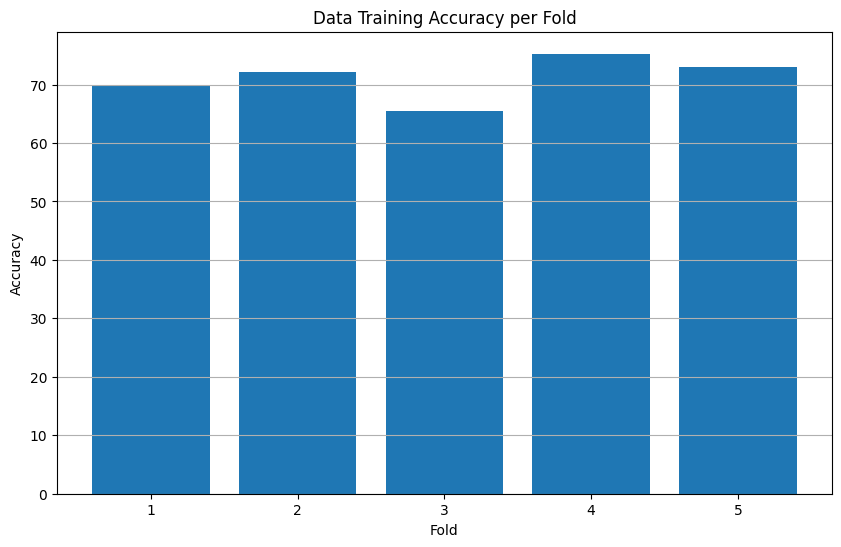

In [125]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

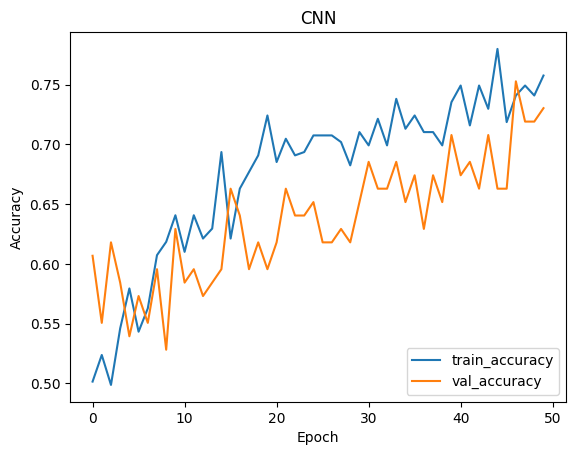

In [126]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(cnn)

In [127]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_cnn/model_cnn_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model1.h5')
    print(f'Model with the best accuracy saved as model1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 0.48225751519203186 - Accuracy: 74.10714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


Model Evaluate Accuracy Score for fold 1: 74.10714285714286%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.77      0.76      0.76        62
           1       0.71      0.72      0.71        50

    accuracy                           0.74       112
   macro avg       0.74      0.74      0.74       112
weighted avg       0.74      0.74      0.74       112

Fold 2 - Loss: 0.5309955477714539 - Accuracy: 73.21428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Model Evaluate Accuracy Score for fold 2: 73.21428571428571%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.78      0.73      0.75        62
           1       0.69      0.74      0.71        50

    accuracy                           0.73       112
   macro avg       0.73      0.73      0.73       112
weighted avg       0.74      0.73      0.73       112

Fold 3 - Loss: 0.4290804862976074 - Accuracy: 77.67857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


Model Evaluate Accuracy Score for fold 3: 77.67857142857143%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.78      0.82      0.80        62
           1       0.77      0.72      0.74        50

    accuracy                           0.78       112
   macro avg       0.78      0.77      0.77       112
weighted avg       0.78      0.78      0.78       112

Fold 4 - Loss: 0.4930438995361328 - Accuracy: 76.78571343421936%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


Model Evaluate Accuracy Score for fold 4: 76.78571428571429%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.79      0.79      0.79        62
           1       0.74      0.74      0.74        50

    accuracy                           0.77       112
   macro avg       0.77      0.77      0.77       112
weighted avg       0.77      0.77      0.77       112

Fold 5 - Loss: 0.5045828223228455 - Accuracy: 75.89285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Model Evaluate Accuracy Score for fold 5: 75.89285714285714%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.76      0.82      0.79        62
           1       0.76      0.68      0.72        50

    accuracy                           0.76       112
   macro avg       0.76      0.75      0.75       112
weighted avg       0.76      0.76      0.76       112

---------------------------------------------------

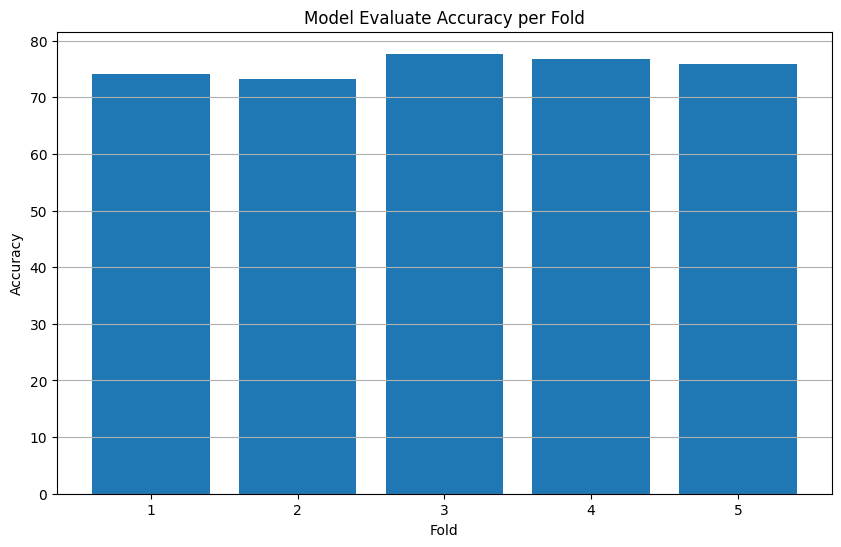

In [128]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

In [129]:
from sklearn.preprocessing import LabelEncoder

# Ekstrak kolom label dari dataset
labels = df_combine_scaled['Label'].values

# Fit label encoder dengan label asli
label_encoder = LabelEncoder()
label_encoded = label_encoder.fit_transform(labels)

# Cetak label yang terasosiasi dengan angka 0 dan 1
print("Label untuk Class 0:", label_encoder.classes_[0])
print("Label untuk Class 1:", label_encoder.classes_[1])

Label untuk Class 0: MI
Label untuk Class 1: Normal


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


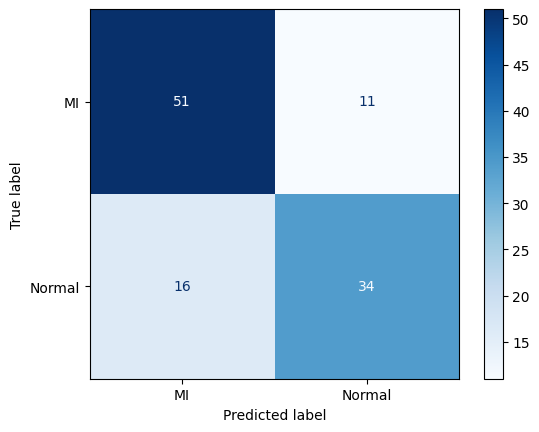

In [130]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Lakukan prediksi pada data test
y_pred = model_cnn.predict(X_test)

# Konversi prediksi menjadi label kelas
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

# Buat confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Tampilkan confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()


In [19]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, GlobalAveragePooling1D, Dense, Dropout

# Menghitung jumlah fitur
num_features = 25  # Sesuaikan dengan jumlah fitur pada dataset

model = Sequential([
    # Lapisan Conv1D pertama
    Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(num_features, 1)),
    MaxPooling1D(pool_size=2),
    Dropout(0.5),
    
    # Lapisan Conv1D kedua
    Conv1D(filters=128, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Dropout(0.5),
    
    # Lapisan Conv1D ketiga
    Conv1D(filters=256, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Dropout(0.5),
    
    # Global Average Pooling
    GlobalAveragePooling1D(),
    
    # Lapisan Dense untuk klasifikasi
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(2, activation='softmax')  # Sesuaikan jumlah neuron dengan jumlah kelas
])

# Kompilasi model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',  # Gunakan 'sparse_categorical_crossentropy' untuk label integer
              metrics=['accuracy'])

# Ringkasan model
model.summary()

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_18 (Conv1D)              │ (None, 23, 64)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_18 (MaxPooling1D) │ (None, 11, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 11, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_19 (Conv1D)              │ (None, 9, 128)         │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_19 (MaxPooling1D) │ (None, 4, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 4, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_20 (Conv1D)              │ (None, 2, 256)         │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_20 (MaxPooling1D) │ (None, 1, 256)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (None, 1, 256)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_6      │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 156,674 (612.01 KB)

 Trainable params: 156,674 (612.01 KB)

 Non-trainable params: 0 (0.00 B)

In [106]:
history = model.fit(X_train, y_train, epochs=50, batch_size=8, validation_data=(X_test, y_test))

Epoch 1/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.4842 - loss: 0.7292 - val_accuracy: 0.6429 - val_loss: 0.6791
Epoch 2/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5293 - loss: 0.7001 - val_accuracy: 0.6161 - val_loss: 0.6711
Epoch 3/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5482 - loss: 0.6811 - val_accuracy: 0.6071 - val_loss: 0.6597
Epoch 4/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4845 - loss: 0.6957 - val_accuracy: 0.6875 - val_loss: 0.6290
Epoch 5/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6146 - loss: 0.6576 - val_accuracy: 0.6250 - val_loss: 0.5974
Epoch 6/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6638 - loss: 0.6293 - val_accuracy: 0.7411 - val_loss: 0.5726
Epoch 7/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6039 - loss: 0.6584 - val_accuracy: 0.7589 - val_loss: 0.5579
Epoch 8/50
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6384 - loss: 0.6320 - val_accuracy: 0.7589 - val_lo

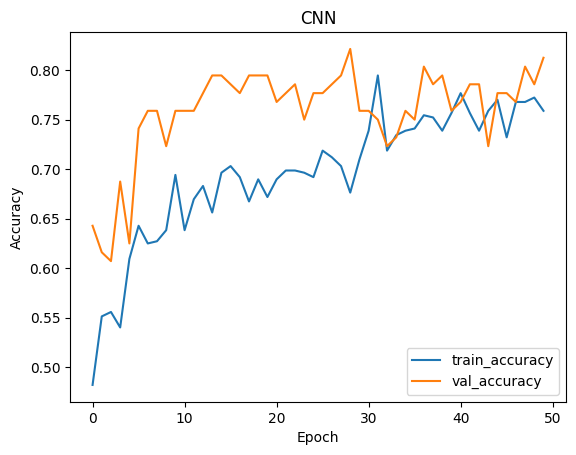

In [107]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(history)

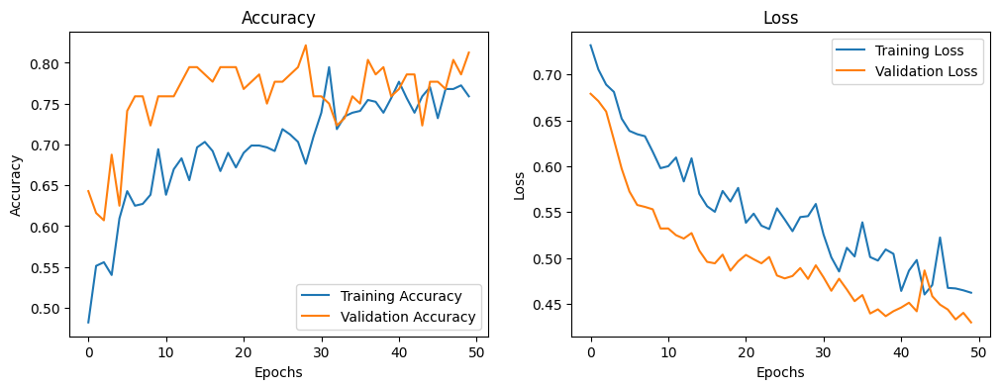

In [109]:
import matplotlib.pyplot as plt

# Menampilkan grafik akurasi dan loss
plt.figure(figsize=(12, 4))

# Grafik akurasi
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Grafik loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

In [108]:
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Accuracy on test data: {accuracy * 100:.2f}%')

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8229 - loss: 0.4418  
Accuracy on test data: 81.25%


### CNN Tuning

In [37]:
from scikeras.wrappers import KerasClassifier

# model = KerasClassifier(build_fn=cnn_model, input_shape=input_shape, num_classes=3, verbose=2)
# model = KerasClassifier(build_fn=lambda: cnn_model(input_shape=(num_features, 1), num_classes=2), verbose=2)
model = KerasClassifier(build_fn=cnn_model, num_features=num_features, verbose=2)


In [21]:
param_grid = {
    'batch_size': [32, 64, 128],
    'epochs': [10, 50, 70]
}

In [159]:
from sklearn.model_selection import GridSearchCV

grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1)
grid_result = grid.fit(X_train, y_train)

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\scikeras\wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/70
7/7 - 5s - 775ms/step - accuracy: 0.5134 - loss: 0.7304
Epoch 2/70
7/7 - 0s - 24ms/step - accuracy: 0.4933 - loss: 0.7116
Epoch 3/70
7/7 - 0s - 20ms/step - accuracy: 0.4978 - loss: 0.7085
Epoch 4/70
7/7 - 0s - 21ms/step - accuracy: 0.5670 - loss: 0.6867
Epoch 5/70
7/7 - 0s - 18ms/step - accuracy: 0.5580 - loss: 0.6791
Epoch 6/70
7/7 - 0s - 20ms/step - accuracy: 0.5580 - loss: 0.6750
Epoch 7/70
7/7 - 0s - 18ms/step - accuracy: 0.5580 - loss: 0.6751
Epoch 8/70
7/7 - 0s - 15ms/step - accuracy: 0.5960 - loss: 0.6769
Epoch 9/70
7/7 - 0s - 16ms/step - accuracy: 0.5871 - loss: 0.6725
Epoch 10/70
7/7 - 0s - 16ms/step - accuracy: 0.5379 - loss: 0.6747
Epoch 11/70
7/7 - 0s - 18ms/step - accuracy: 0.5893 - loss: 0.6659
Epoch 12/70
7/7 - 0s - 16ms/step - accuracy: 0.5469 - loss: 0.6614
Epoch 13/70
7/7 - 0s - 17ms/step - accuracy: 0.6250 - loss: 0.6289
Epoch 14/70
7/7 - 0s - 18ms/step - accuracy: 0.6228 - loss: 0.6335
Epoch 15/70
7/7 - 0s - 20ms/step - accuracy: 0.6295 - loss: 0.6283
Epo

In [160]:
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, std, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, std, param))

Best: 0.707441 using {'batch_size': 64, 'epochs': 70}
0.589388 (0.053698) with: {'batch_size': 32, 'epochs': 10}
0.689663 (0.033144) with: {'batch_size': 32, 'epochs': 50}
0.698652 (0.023461) with: {'batch_size': 32, 'epochs': 70}
0.578352 (0.082178) with: {'batch_size': 64, 'epochs': 10}
0.680799 (0.024992) with: {'batch_size': 64, 'epochs': 50}
0.707441 (0.037391) with: {'batch_size': 64, 'epochs': 70}
0.542297 (0.044497) with: {'batch_size': 128, 'epochs': 10}
0.649688 (0.039035) with: {'batch_size': 128, 'epochs': 50}
0.680674 (0.040593) with: {'batch_size': 128, 'epochs': 70}


In [161]:
best_params=grid_result.best_params_ 
accuracy=grid_result.best_score_ 

print(best_params)
print(accuracy)

{'batch_size': 64, 'epochs': 70}
0.7074406991260924


In [131]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_cnn_tuning', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_cnn = cnn_model(num_features)
    
    # Melatih model
    cnn = model_cnn.fit(X_train_fold, y_train_fold, batch_size=64, epochs=70, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_cnn.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_cnn.metrics_names[0]} of {scores[0]}; {model_cnn.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_cnn_tuning/model_cnn_tuning_fold_{fold_no}.h5'
    model_cnn.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

Fold 1
Epoch 1/70


C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 - 28s - 5s/step - accuracy: 0.5028 - loss: 0.7277 - val_accuracy: 0.6000 - val_loss: 0.6852
Epoch 2/70
6/6 - 0s - 68ms/step - accuracy: 0.5335 - loss: 0.7136 - val_accuracy: 0.5667 - val_loss: 0.6832
Epoch 3/70
6/6 - 0s - 39ms/step - accuracy: 0.5140 - loss: 0.6990 - val_accuracy: 0.6222 - val_loss: 0.6846
Epoch 4/70
6/6 - 0s - 37ms/step - accuracy: 0.5168 - loss: 0.7009 - val_accuracy: 0.6333 - val_loss: 0.6835
Epoch 5/70
6/6 - 0s - 38ms/step - accuracy: 0.5251 - loss: 0.7016 - val_accuracy: 0.6667 - val_loss: 0.6784
Epoch 6/70
6/6 - 0s - 34ms/step - accuracy: 0.5475 - loss: 0.6930 - val_accuracy: 0.6889 - val_loss: 0.6738
Epoch 7/70
6/6 - 0s - 27ms/step - accuracy: 0.5307 - loss: 0.6870 - val_accuracy: 0.7000 - val_loss: 0.6710
Epoch 8/70
6/6 - 0s - 30ms/step - accuracy: 0.5503 - loss: 0.6878 - val_accuracy: 0.6222 - val_loss: 0.6703
Epoch 9/70
6/6 - 0s - 23ms/step - accuracy: 0.5587 - loss: 0.6891 - val_accuracy: 0.6556 - val_loss: 0.6702
Epoch 10/70
6/6 - 0s - 20ms/step - accur

Score for fold 1: loss of 0.5811839699745178; compile_metrics of 72.22222089767456%
Model for fold 1 saved as models_cnn_tuning/model_cnn_tuning_fold_1.h5
Fold 2
Epoch 1/70
6/6 - 3s - 464ms/step - accuracy: 0.5112 - loss: 0.7269 - val_accuracy: 0.5333 - val_loss: 0.6874
Epoch 2/70
6/6 - 0s - 19ms/step - accuracy: 0.5531 - loss: 0.6872 - val_accuracy: 0.5556 - val_loss: 0.6869
Epoch 3/70
6/6 - 0s - 19ms/step - accuracy: 0.5391 - loss: 0.6975 - val_accuracy: 0.4778 - val_loss: 0.6847
Epoch 4/70
6/6 - 0s - 19ms/step - accuracy: 0.5307 - loss: 0.7173 - val_accuracy: 0.5444 - val_loss: 0.6841
Epoch 5/70
6/6 - 0s - 20ms/step - accuracy: 0.5419 - loss: 0.6955 - val_accuracy: 0.5222 - val_loss: 0.6842
Epoch 6/70
6/6 - 0s - 19ms/step - accuracy: 0.5112 - loss: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6823
Epoch 7/70
6/6 - 0s - 26ms/step - accuracy: 0.5363 - loss: 0.6928 - val_accuracy: 0.4889 - val_loss: 0.6826
Epoch 8/70
6/6 - 0s - 18ms/step - accuracy: 0.5279 - loss: 0.6914 - val_accuracy:

Score for fold 2: loss of 0.5677045583724976; compile_metrics of 73.33333492279053%
Model for fold 2 saved as models_cnn_tuning/model_cnn_tuning_fold_2.h5
Fold 3
Epoch 1/70
6/6 - 2s - 377ms/step - accuracy: 0.5028 - loss: 0.7222 - val_accuracy: 0.5333 - val_loss: 0.6906
Epoch 2/70
6/6 - 0s - 19ms/step - accuracy: 0.5419 - loss: 0.7031 - val_accuracy: 0.6222 - val_loss: 0.6875
Epoch 3/70
6/6 - 0s - 19ms/step - accuracy: 0.5168 - loss: 0.7134 - val_accuracy: 0.5778 - val_loss: 0.6858
Epoch 4/70
6/6 - 0s - 18ms/step - accuracy: 0.5335 - loss: 0.6994 - val_accuracy: 0.5889 - val_loss: 0.6832
Epoch 5/70
6/6 - 0s - 19ms/step - accuracy: 0.5112 - loss: 0.7049 - val_accuracy: 0.5889 - val_loss: 0.6818
Epoch 6/70
6/6 - 0s - 19ms/step - accuracy: 0.5335 - loss: 0.6827 - val_accuracy: 0.5667 - val_loss: 0.6823
Epoch 7/70
6/6 - 0s - 18ms/step - accuracy: 0.5168 - loss: 0.6999 - val_accuracy: 0.6333 - val_loss: 0.6796
Epoch 8/70
6/6 - 0s - 18ms/step - accuracy: 0.5838 - loss: 0.6805 - val_accuracy:

Score for fold 3: loss of 0.5608630180358887; compile_metrics of 65.55555462837219%
Model for fold 3 saved as models_cnn_tuning/model_cnn_tuning_fold_3.h5
Fold 4
Epoch 1/70
6/6 - 2s - 382ms/step - accuracy: 0.4457 - loss: 0.7500 - val_accuracy: 0.5281 - val_loss: 0.7012
Epoch 2/70
6/6 - 0s - 20ms/step - accuracy: 0.4680 - loss: 0.7260 - val_accuracy: 0.5506 - val_loss: 0.6925
Epoch 3/70
6/6 - 0s - 20ms/step - accuracy: 0.5014 - loss: 0.7083 - val_accuracy: 0.5843 - val_loss: 0.6868
Epoch 4/70
6/6 - 0s - 20ms/step - accuracy: 0.5125 - loss: 0.7049 - val_accuracy: 0.5393 - val_loss: 0.6883
Epoch 5/70
6/6 - 0s - 18ms/step - accuracy: 0.5432 - loss: 0.6978 - val_accuracy: 0.6517 - val_loss: 0.6881
Epoch 6/70
6/6 - 0s - 28ms/step - accuracy: 0.5292 - loss: 0.6867 - val_accuracy: 0.6180 - val_loss: 0.6872
Epoch 7/70
6/6 - 0s - 21ms/step - accuracy: 0.5543 - loss: 0.6867 - val_accuracy: 0.5955 - val_loss: 0.6822
Epoch 8/70
6/6 - 0s - 20ms/step - accuracy: 0.5404 - loss: 0.6829 - val_accuracy:

Score for fold 4: loss of 0.51819908618927; compile_metrics of 73.03370833396912%
Model for fold 4 saved as models_cnn_tuning/model_cnn_tuning_fold_4.h5
Fold 5
Epoch 1/70
6/6 - 2s - 384ms/step - accuracy: 0.5376 - loss: 0.7101 - val_accuracy: 0.4494 - val_loss: 0.7137
Epoch 2/70
6/6 - 0s - 18ms/step - accuracy: 0.5237 - loss: 0.6976 - val_accuracy: 0.5056 - val_loss: 0.6858
Epoch 3/70
6/6 - 0s - 19ms/step - accuracy: 0.5292 - loss: 0.7221 - val_accuracy: 0.5281 - val_loss: 0.6813
Epoch 4/70
6/6 - 0s - 20ms/step - accuracy: 0.5014 - loss: 0.7121 - val_accuracy: 0.4607 - val_loss: 0.6932
Epoch 5/70
6/6 - 0s - 19ms/step - accuracy: 0.5237 - loss: 0.6982 - val_accuracy: 0.4719 - val_loss: 0.6927
Epoch 6/70
6/6 - 0s - 28ms/step - accuracy: 0.5042 - loss: 0.6982 - val_accuracy: 0.5281 - val_loss: 0.6816
Epoch 7/70
6/6 - 0s - 18ms/step - accuracy: 0.5432 - loss: 0.6843 - val_accuracy: 0.5618 - val_loss: 0.6753
Epoch 8/70
6/6 - 0s - 19ms/step - accuracy: 0.5265 - loss: 0.6890 - val_accuracy: 0

Model for fold 5 saved as models_cnn_tuning/model_cnn_tuning_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.5811839699745178 - Accuracy: 72.22222089767456%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.5677045583724976 - Accuracy: 73.33333492279053%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.5608630180358887 - Accuracy: 65.55555462837219%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.51819908618927 - Accuracy: 73.03370833396912%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.5793584585189819 - Accuracy: 67.41573214530945%
------------------------------------------------------------------------
Average scores for all folds:
> Accuracy: 70.31211018562317 (+- 3.1999

In [132]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 72.22222089767456%
Fold 2: 73.33333492279053%
Fold 3: 65.55555462837219%
Fold 4: 73.03370833396912%
Fold 5: 67.41573214530945%


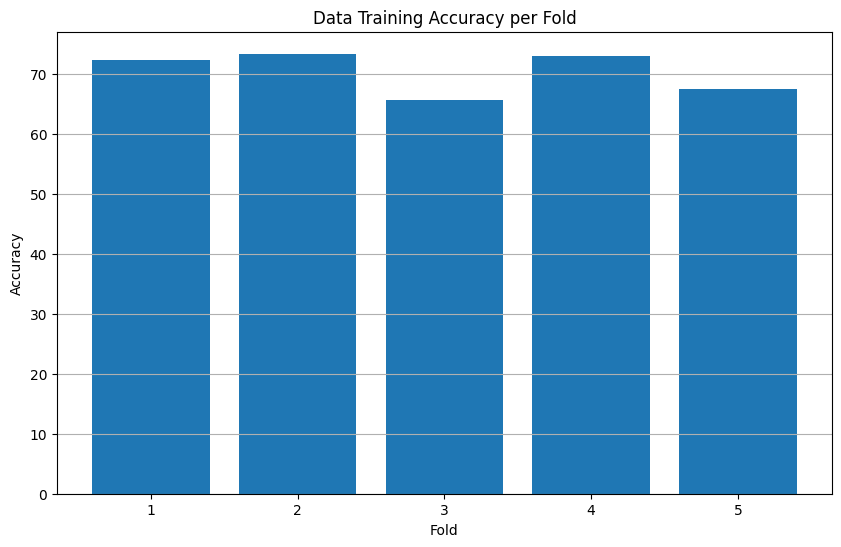

In [133]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

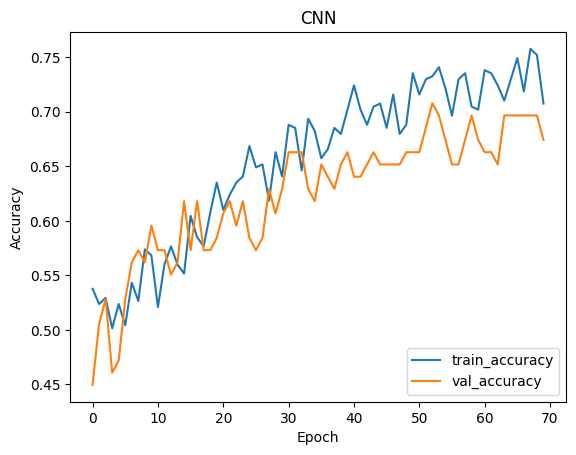

In [134]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(cnn)

In [139]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_cnn_tuning/model_cnn_tuning_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model1.h5')
    print(f'Model with the best accuracy saved as model1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 0.48544421792030334 - Accuracy: 77.67857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


Model Evaluate Accuracy Score for fold 1: 77.67857142857143%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.85      0.73      0.78        62
           1       0.71      0.84      0.77        50

    accuracy                           0.78       112
   macro avg       0.78      0.78      0.78       112
weighted avg       0.79      0.78      0.78       112

Fold 2 - Loss: 0.48226413130760193 - Accuracy: 79.46428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


Model Evaluate Accuracy Score for fold 2: 79.46428571428571%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.83      0.79      0.81        62
           1       0.75      0.80      0.78        50

    accuracy                           0.79       112
   macro avg       0.79      0.80      0.79       112
weighted avg       0.80      0.79      0.80       112

Fold 3 - Loss: 0.41571474075317383 - Accuracy: 82.14285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


Model Evaluate Accuracy Score for fold 3: 82.14285714285714%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.85      0.82      0.84        62
           1       0.79      0.82      0.80        50

    accuracy                           0.82       112
   macro avg       0.82      0.82      0.82       112
weighted avg       0.82      0.82      0.82       112

Fold 4 - Loss: 0.4480871856212616 - Accuracy: 80.35714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


Model Evaluate Accuracy Score for fold 4: 80.35714285714286%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.79      0.89      0.83        62
           1       0.83      0.70      0.76        50

    accuracy                           0.80       112
   macro avg       0.81      0.79      0.80       112
weighted avg       0.81      0.80      0.80       112

Fold 5 - Loss: 0.46648451685905457 - Accuracy: 79.46428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Model Evaluate Accuracy Score for fold 5: 79.46428571428571%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.79      0.85      0.82        62
           1       0.80      0.72      0.76        50

    accuracy                           0.79       112
   macro avg       0.80      0.79      0.79       112
weighted avg       0.80      0.79      0.79       112

--------------------------------------------------

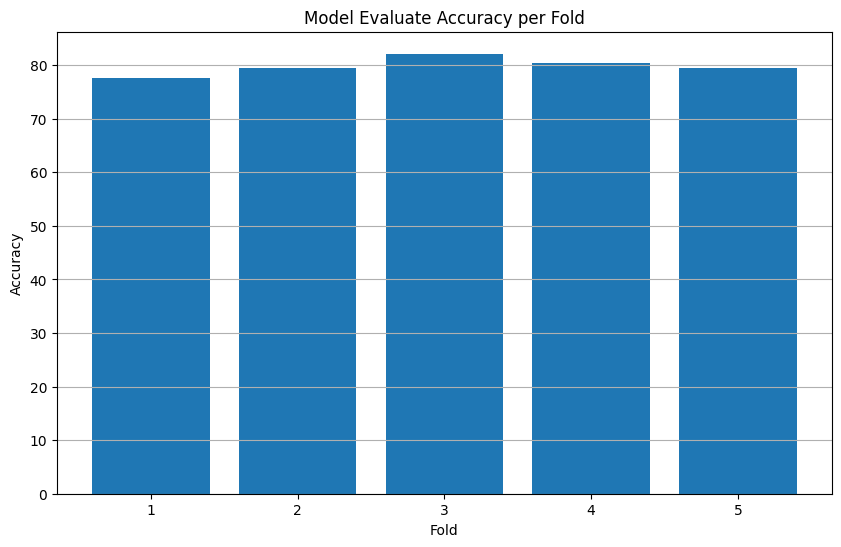

In [140]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

In [141]:
from sklearn.preprocessing import LabelEncoder

# Ekstrak kolom label dari dataset
labels = df_combine_scaled['Label'].values

# Fit label encoder dengan label asli
label_encoder = LabelEncoder()
label_encoded = label_encoder.fit_transform(labels)

# Cetak label yang terasosiasi dengan angka 0 dan 1
print("Label untuk Class 0:", label_encoder.classes_[0])
print("Label untuk Class 1:", label_encoder.classes_[1])

Label untuk Class 0: MI
Label untuk Class 1: Normal


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


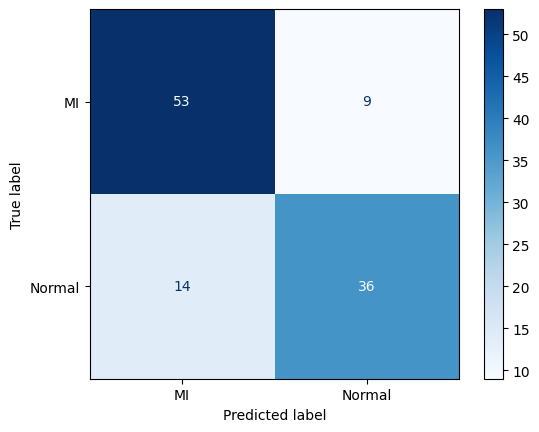

In [142]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Lakukan prediksi pada data test
y_pred = model_cnn.predict(X_test)

# Konversi prediksi menjadi label kelas
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

# Buat confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Tampilkan confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()


### ResNet

In [165]:
from tensorflow.keras.layers import Conv1D, GlobalAveragePooling1D, Dense, Input, BatchNormalization, Activation, Add, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
import tensorflow as tf

def residual_block_1d(x, filters, kernel_size=3, stride=1, l2_reg=0.001, dropout_rate=0.5):
    shortcut = x

    x = Conv1D(filters, kernel_size=kernel_size, strides=stride, padding='same',
               kernel_regularizer=l2(l2_reg))(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv1D(filters, kernel_size=kernel_size, strides=1, padding='same',
               kernel_regularizer=l2(l2_reg))(x)
    x = BatchNormalization()(x)
    
    # Adjust shortcut if the dimensions do not match
    if stride != 1 or shortcut.shape[-1] != filters:
        shortcut = Conv1D(filters, kernel_size=1, strides=stride, padding='same',
                          kernel_regularizer=l2(l2_reg))(shortcut)
        shortcut = BatchNormalization()(shortcut)
    
    x = Add()([x, shortcut])
    x = Activation('relu')(x)
    
    # Add dropout layer
    x = Dropout(dropout_rate)(x)
    
    return x

def resnet_1d(num_features):
    inputs = Input(shape=(num_features, 1))
    
    # Initial conv layer
    x = Conv1D(64, kernel_size=7, strides=2, padding='same', kernel_regularizer=l2(0.001))(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    # Residual blocks with L2 regularization and Dropout
    x = residual_block_1d(x, filters=64, stride=1)
    x = residual_block_1d(x, filters=128, stride=2)
    x = residual_block_1d(x, filters=256, stride=2)
    # x = residual_block_1d(x, filters=512, stride=2)
    # x = residual_block_1d(x, filters=32, stride=1)
    # x = residual_block_1d(x, filters=64, stride=1)
    # x = residual_block_1d(x, filters=128, stride=1)


    
    # Global Average Pooling
    x = GlobalAveragePooling1D()(x)
    
    # Fully connected layer with L2 regularization and Dropout
    # x = Dense(512, activation='relu', kernel_regularizer=l2(0.001))(x)
    x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
    x = Dropout(0.5)(x)
    x = Dense(2, activation='softmax')(x)
    
    model = Model(inputs, x)
    
    # Compile the model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

model_resnet = resnet_1d(num_features)
model_resnet.summary()


Model: "functional_474"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_85      │ (None, 25, 1)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_810 (Conv1D) │ (None, 13, 64)    │        512 │ input_layer_85[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ conv1d_810[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_555      │ (None, 13, 64)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_811 (Conv1D) │ (None, 13, 64)    │     12,352 │ activation_555[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ conv1d_811[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_556      │ (None, 13, 64)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_812 (Conv1D) │ (None, 13, 64)    │     12,352 │ activation_556[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ conv1d_812[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_246 (Add)       │ (None, 13, 64)    │          0 │ batch_normalizat… │
│                     │                   │            │ activation_555[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_557      │ (None, 13, 64)    │          0 │ add_246[0][0]     │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_397         │ (None, 13, 64)    │          0 │ activation_557[0… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_813 (Conv1D) │ (None, 7, 128)    │     24,704 │ dropout_397[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 7, 128)    │        512 │ conv1d_813[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_558      │ (None, 7, 128)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_814 (Conv1D) │ (None, 7, 128)    │     49,280 │ activation_558[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_815 (Conv1D) │ (None, 7, 128)    │      8,320 │ dropout_397[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 7, 128)    │        512 │ conv1d_814[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 7, 128)    │        512 │ conv1d_815[0][0]

 Total params: 457,922 (1.75 MB)

 Trainable params: 455,234 (1.74 MB)

 Non-trainable params: 2,688 (10.50 KB)

In [166]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_resnet', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_resnet = resnet_1d(num_features)
    
    # model_cnn.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    # Melatih model
    cnn = model_resnet.fit(X_train_fold, y_train_fold, batch_size=8, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_resnet.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_resnet.metrics_names[0]} of {scores[0]}; {model_resnet.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_resnet/model_resnet_fold_{fold_no}.h5'
    model_resnet.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/50
45/45 - 13s - 282ms/step - accuracy: 0.5112 - loss: 2.2786 - val_accuracy: 0.5667 - val_loss: 1.8160
Epoch 2/50
45/45 - 1s - 25ms/step - accuracy: 0.5084 - loss: 1.9805 - val_accuracy: 0.4778 - val_loss: 1.8357
Epoch 3/50
45/45 - 1s - 25ms/step - accuracy: 0.5754 - loss: 1.8528 - val_accuracy: 0.4778 - val_loss: 1.8717
Epoch 4/50
45/45 - 1s - 26ms/step - accuracy: 0.6313 - loss: 1.7919 - val_accuracy: 0.5556 - val_loss: 1.7972
Epoch 5/50
45/45 - 1s - 24ms/step - accuracy: 0.6173 - loss: 1.7964 - val_accuracy: 0.5444 - val_loss: 1.8305
Epoch 6/50
45/45 - 1s - 24ms/step - accuracy: 0.6425 - loss: 1.7645 - val_accuracy: 0.6000 - val_loss: 1.7366
Epoch 7/50
45/45 - 1s - 28ms/step - accuracy: 0.6676 - loss: 1.7323 - val_accuracy: 0.6333 - val_loss: 1.7104
Epoch 8/50
45/45 - 1s - 28ms/step - accuracy: 0.6313 - loss: 1.7363 - val_accuracy: 0.6222 - val_loss: 1.6824
Epoch 9/50
45/45 - 1s - 25ms/step - accuracy: 0.6564 - loss: 1.6699 - val_accuracy: 0.6444 - val_loss: 1.6703
E

Score for fold 1: loss of 1.2574560642242432; compile_metrics of 72.22222089767456%
Model for fold 1 saved as models_resnet/model_resnet_fold_1.h5
Fold 2
Epoch 1/50
45/45 - 10s - 213ms/step - accuracy: 0.5112 - loss: 2.0597 - val_accuracy: 0.4778 - val_loss: 1.8228
Epoch 2/50
45/45 - 1s - 25ms/step - accuracy: 0.5447 - loss: 1.9216 - val_accuracy: 0.4778 - val_loss: 1.8233
Epoch 3/50
45/45 - 1s - 25ms/step - accuracy: 0.5335 - loss: 1.8501 - val_accuracy: 0.4778 - val_loss: 1.8228
Epoch 4/50
45/45 - 1s - 26ms/step - accuracy: 0.6061 - loss: 1.8322 - val_accuracy: 0.4778 - val_loss: 1.8784
Epoch 5/50
45/45 - 1s - 25ms/step - accuracy: 0.6089 - loss: 1.7772 - val_accuracy: 0.4889 - val_loss: 1.7997
Epoch 6/50
45/45 - 1s - 25ms/step - accuracy: 0.6229 - loss: 1.7414 - val_accuracy: 0.6000 - val_loss: 1.7295
Epoch 7/50
45/45 - 1s - 26ms/step - accuracy: 0.6788 - loss: 1.6688 - val_accuracy: 0.6333 - val_loss: 1.7337
Epoch 8/50
45/45 - 1s - 25ms/step - accuracy: 0.6536 - loss: 1.6863 - val_

Score for fold 2: loss of 0.972119152545929; compile_metrics of 76.66666507720947%
Model for fold 2 saved as models_resnet/model_resnet_fold_2.h5
Fold 3
Epoch 1/50
45/45 - 45s - 992ms/step - accuracy: 0.5419 - loss: 2.0079 - val_accuracy: 0.5222 - val_loss: 1.8214
Epoch 2/50
45/45 - 1s - 31ms/step - accuracy: 0.5279 - loss: 1.8907 - val_accuracy: 0.5667 - val_loss: 1.8243
Epoch 3/50
45/45 - 1s - 29ms/step - accuracy: 0.6006 - loss: 1.8452 - val_accuracy: 0.6111 - val_loss: 1.8021
Epoch 4/50
45/45 - 1s - 29ms/step - accuracy: 0.6089 - loss: 1.7817 - val_accuracy: 0.5333 - val_loss: 1.8064
Epoch 5/50
45/45 - 1s - 33ms/step - accuracy: 0.6564 - loss: 1.7346 - val_accuracy: 0.5778 - val_loss: 1.8058
Epoch 6/50
45/45 - 2s - 34ms/step - accuracy: 0.6397 - loss: 1.7489 - val_accuracy: 0.5778 - val_loss: 1.8185
Epoch 7/50
45/45 - 2s - 34ms/step - accuracy: 0.6955 - loss: 1.6519 - val_accuracy: 0.6000 - val_loss: 1.7396
Epoch 8/50
45/45 - 1s - 30ms/step - accuracy: 0.6648 - loss: 1.6936 - val_a

Score for fold 3: loss of 1.038780689239502; compile_metrics of 80.0000011920929%
Model for fold 3 saved as models_resnet/model_resnet_fold_3.h5
Fold 4
Epoch 1/50
45/45 - 16s - 365ms/step - accuracy: 0.5348 - loss: 1.9679 - val_accuracy: 0.4719 - val_loss: 1.8238
Epoch 2/50
45/45 - 1s - 32ms/step - accuracy: 0.5850 - loss: 1.8339 - val_accuracy: 0.6067 - val_loss: 1.8042
Epoch 3/50
45/45 - 1s - 27ms/step - accuracy: 0.6184 - loss: 1.7847 - val_accuracy: 0.6404 - val_loss: 1.7903
Epoch 4/50
45/45 - 1s - 27ms/step - accuracy: 0.6295 - loss: 1.7995 - val_accuracy: 0.6180 - val_loss: 1.7746
Epoch 5/50
45/45 - 1s - 28ms/step - accuracy: 0.6574 - loss: 1.7281 - val_accuracy: 0.6292 - val_loss: 1.7255
Epoch 6/50
45/45 - 1s - 29ms/step - accuracy: 0.6435 - loss: 1.7188 - val_accuracy: 0.6742 - val_loss: 1.6792
Epoch 7/50
45/45 - 1s - 27ms/step - accuracy: 0.6797 - loss: 1.6634 - val_accuracy: 0.6517 - val_loss: 1.6792
Epoch 8/50
45/45 - 1s - 28ms/step - accuracy: 0.6880 - loss: 1.6130 - val_ac

Score for fold 4: loss of 0.9033035039901733; compile_metrics of 80.89887499809265%
Model for fold 4 saved as models_resnet/model_resnet_fold_4.h5
Fold 5
Epoch 1/50
45/45 - 13s - 299ms/step - accuracy: 0.4875 - loss: 2.0959 - val_accuracy: 0.5506 - val_loss: 1.8193
Epoch 2/50
45/45 - 1s - 32ms/step - accuracy: 0.5376 - loss: 1.8891 - val_accuracy: 0.6180 - val_loss: 1.8110
Epoch 3/50
45/45 - 1s - 32ms/step - accuracy: 0.6100 - loss: 1.8096 - val_accuracy: 0.5955 - val_loss: 1.7864
Epoch 4/50
45/45 - 1s - 33ms/step - accuracy: 0.6295 - loss: 1.7920 - val_accuracy: 0.5618 - val_loss: 1.8359
Epoch 5/50
45/45 - 2s - 38ms/step - accuracy: 0.6435 - loss: 1.7373 - val_accuracy: 0.5955 - val_loss: 1.7726
Epoch 6/50
45/45 - 2s - 34ms/step - accuracy: 0.6407 - loss: 1.7120 - val_accuracy: 0.6854 - val_loss: 1.6777
Epoch 7/50
45/45 - 1s - 28ms/step - accuracy: 0.6602 - loss: 1.7170 - val_accuracy: 0.6854 - val_loss: 1.6774
Epoch 8/50
45/45 - 1s - 32ms/step - accuracy: 0.6351 - loss: 1.7194 - val_

Score for fold 5: loss of 1.0384548902511597; compile_metrics of 74.15730357170105%
Model for fold 5 saved as models_resnet/model_resnet_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 1.2574560642242432 - Accuracy: 72.22222089767456%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.972119152545929 - Accuracy: 76.66666507720947%
------------------------------------------------------------------------
> Fold 3 - Loss: 1.038780689239502 - Accuracy: 80.0000011920929%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.9033035039901733 - Accuracy: 80.89887499809265%
------------------------------------------------------------------------
> Fold 5 - Loss: 1.0384548902511597 - Accuracy: 74.15730357170105%
--------------------------------------------------------------------

In [167]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 72.22222089767456%
Fold 2: 76.66666507720947%
Fold 3: 80.0000011920929%
Fold 4: 80.89887499809265%
Fold 5: 74.15730357170105%


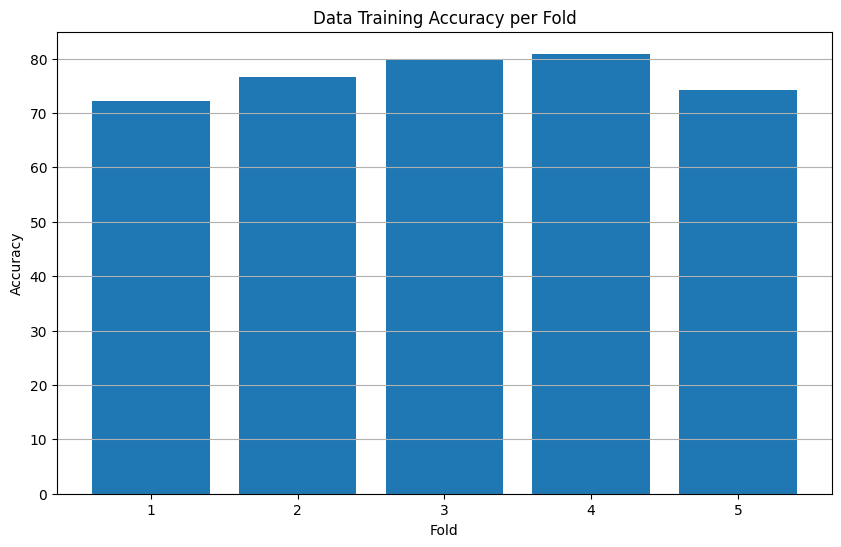

In [168]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

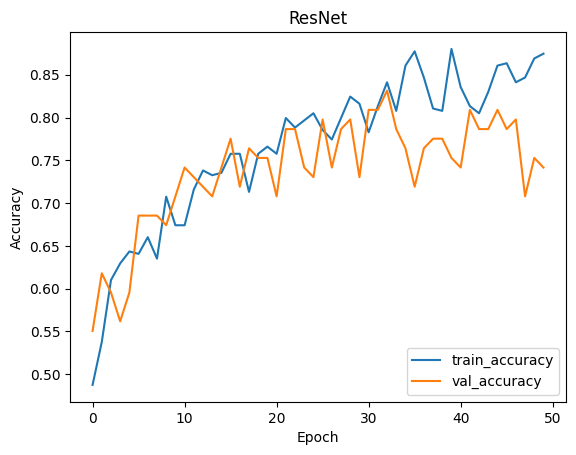

In [169]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('ResNet')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(cnn)

In [170]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_resnet/model_resnet_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model1.h5')
    print(f'Model with the best accuracy saved as model1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 1.0948630571365356 - Accuracy: 81.25%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 215ms/step
Model Evaluate Accuracy Score for fold 1: 81.25%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.83      0.84      0.83        62
           1       0.80      0.78      0.79        50

    accuracy                           0.81       112
   macro avg       0.81      0.81      0.81       112
weighted avg       0.81      0.81      0.81       112



Fold 2 - Loss: 1.2228370904922485 - Accuracy: 69.64285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 217ms/step
Model Evaluate Accuracy Score for fold 2: 69.64285714285714%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.78      0.63      0.70        62
           1       0.63      0.78      0.70        50

    accuracy                           0.70       112
   macro avg       0.70      0.70      0.70       112
weighted avg       0.71      0.70      0.70       112



Fold 3 - Loss: 1.0675908327102661 - Accuracy: 76.78571343421936%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 158ms/step
Model Evaluate Accuracy Score for fold 3: 76.78571428571429%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.88      0.68      0.76        62
           1       0.69      0.88      0.77        50

    accuracy                           0.77       112
   macro avg       0.78      0.78      0.77       112
weighted avg       0.79      0.77      0.77       112



Fold 4 - Loss: 0.9289926886558533 - Accuracy: 81.25%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 167ms/step
Model Evaluate Accuracy Score for fold 4: 81.25%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.82      0.85      0.83        62
           1       0.81      0.76      0.78        50

    accuracy                           0.81       112
   macro avg       0.81      0.81      0.81       112
weighted avg       0.81      0.81      0.81       112



Fold 5 - Loss: 0.9082211256027222 - Accuracy: 80.35714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 189ms/step
Model Evaluate Accuracy Score for fold 5: 80.35714285714286%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.87      0.76      0.81        62
           1       0.74      0.86      0.80        50

    accuracy                           0.80       112
   macro avg       0.81      0.81      0.80       112
weighted avg       0.81      0.80      0.80       112

------------------------------------------------------------------------
Score per fold
> Fold 1 - Loss: 1.0948630571365356 - Accuracy: 81.25%
> Fold 2 - Loss: 1.2228370904922485 - Accuracy: 69.64285969734192%
> Fold 3 - Loss: 1.0675908327102661 - Accuracy: 76.78571343421936%
> Fold 4 - Loss: 0.9289926886558533 - Accuracy: 81.25%
> Fold 5 - Loss: 0.9082211256027222 - Accuracy: 80.35714030265808%
------------------------------------------------------------------------
A

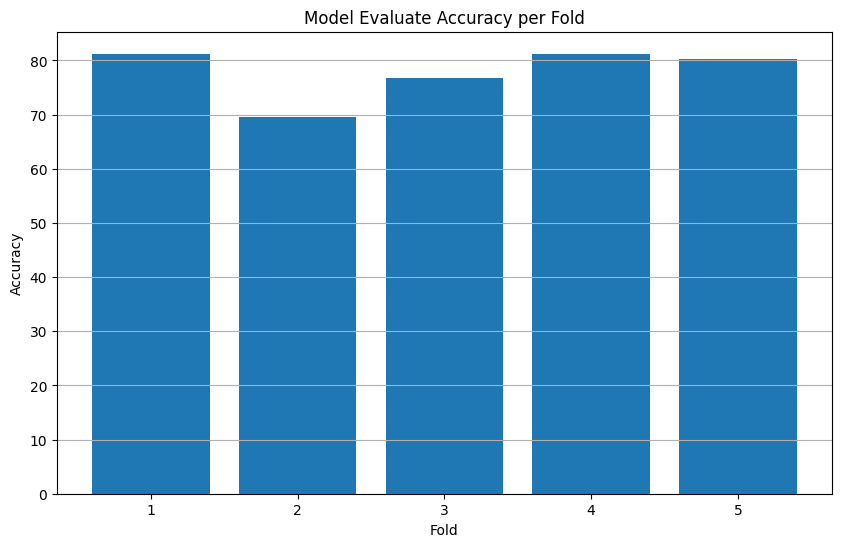

In [171]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

In [172]:
from sklearn.preprocessing import LabelEncoder

# Ekstrak kolom label dari dataset
labels = df_combine_scaled['Label'].values

# Fit label encoder dengan label asli
label_encoder = LabelEncoder()
label_encoded = label_encoder.fit_transform(labels)

# Cetak label yang terasosiasi dengan angka 0 dan 1
print("Label untuk Class 0:", label_encoder.classes_[0])
print("Label untuk Class 1:", label_encoder.classes_[1])

Label untuk Class 0: MI
Label untuk Class 1: Normal


4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 206ms/step


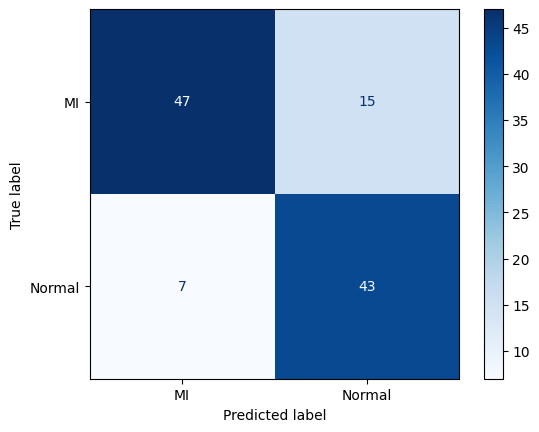

In [173]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Lakukan prediksi pada data test
y_pred = model_resnet.predict(X_test)

# Konversi prediksi menjadi label kelas
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

# Buat confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Tampilkan confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()


### RestNet Tuning

In [66]:
from scikeras.wrappers import KerasClassifier

# model = KerasClassifier(build_fn=cnn_model, input_shape=input_shape, num_classes=3, verbose=2)
# model = KerasClassifier(build_fn=lambda: cnn_model(input_shape=(num_features, 1), num_classes=2), verbose=2)
model2 = KerasClassifier(build_fn=resnet_1d, num_features=num_features, verbose=2)

In [67]:
param_grid = {
    'batch_size': [32, 64, 128],
    'epochs': [10, 50, 70]
}

In [69]:
from sklearn.model_selection import GridSearchCV

grid = GridSearchCV(estimator=model2, param_grid=param_grid, n_jobs=-1)
grid_result = grid.fit(X_train, y_train)

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\joblib\externals\loky\process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\scikeras\wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Epoch 1/50
14/14 - 13s - 940ms/step - accuracy: 0.5469 - loss: 3.7079
Epoch 2/50
14/14 - 1s - 80ms/step - accuracy: 0.5112 - loss: 3.7518
Epoch 3/50
14/14 - 1s - 84ms/step - accuracy: 0.5223 - loss: 3.6663
Epoch 4/50
14/14 - 1s - 72ms/step - accuracy: 0.5424 - loss: 3.5775
Epoch 5/50
14/14 - 1s - 71ms/step - accuracy: 0.5558 - loss: 3.4603
Epoch 6/50
14/14 - 1s - 73ms/step - accuracy: 0.6295 - loss: 3.3810
Epoch 7/50
14/14 - 1s - 71ms/step - accuracy: 0.6473 - loss: 3.3344
Epoch 8/50
14/14 - 1s - 73ms/step - accuracy: 0.6429 - loss: 3.3261
Epoch 9/50
14/14 - 1s - 72ms/step - accuracy: 0.6295 - loss: 3.2349
Epoch 10/50
14/14 - 1s - 72ms/step - accuracy: 0.6808 - loss: 3.1578
Epoch 11/50
14/14 - 1s - 72ms/step - accuracy: 0.6652 - loss: 3.1507
Epoch 12/50
14/14 - 1s - 72ms/step - accuracy: 0.7388 - loss: 3.0443
Epoch 13/50
14/14 - 1s - 72ms/step - accuracy: 0.6987 - loss: 3.0584
Epoch 14/50
14/14 - 1s - 72ms/step - accuracy: 0.7188 - loss: 2.9896
Epoch 15/50
14/14 - 1s - 73ms/step - accu

In [70]:
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, std, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, std, param))

Best: 0.763021 using {'batch_size': 32, 'epochs': 50}
0.571111 (0.097150) with: {'batch_size': 32, 'epochs': 10}
0.763021 (0.070720) with: {'batch_size': 32, 'epochs': 50}
0.761074 (0.038846) with: {'batch_size': 32, 'epochs': 70}
0.593258 (0.101713) with: {'batch_size': 64, 'epochs': 10}
0.718602 (0.027416) with: {'batch_size': 64, 'epochs': 50}
0.754182 (0.068183) with: {'batch_size': 64, 'epochs': 70}
0.582672 (0.035361) with: {'batch_size': 128, 'epochs': 10}
0.627266 (0.047129) with: {'batch_size': 128, 'epochs': 50}
0.606966 (0.098597) with: {'batch_size': 128, 'epochs': 70}


In [71]:
best_params=grid_result.best_params_ 
accuracy=grid_result.best_score_ 

print(best_params)
print(accuracy)

{'batch_size': 32, 'epochs': 50}
0.7630212234706617


In [152]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_resnet_tuning', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_resnet = resnet_1d(num_features)
    
    # model_cnn.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    # Melatih model
    resnet = model_resnet.fit(X_train_fold, y_train_fold, batch_size=32, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_resnet.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_resnet.metrics_names[0]} of {scores[0]}; {model_resnet.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_resnet_tuning/model_resnet_tuning_fold_{fold_no}.h5'
    model_resnet.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/50
12/12 - 14s - 1s/step - accuracy: 0.4972 - loss: 3.8474 - val_accuracy: 0.5333 - val_loss: 3.4281
Epoch 2/50
12/12 - 1s - 123ms/step - accuracy: 0.4972 - loss: 3.8564 - val_accuracy: 0.4778 - val_loss: 3.4434
Epoch 3/50
12/12 - 1s - 104ms/step - accuracy: 0.5419 - loss: 3.6623 - val_accuracy: 0.4778 - val_loss: 3.4379
Epoch 4/50
12/12 - 1s - 99ms/step - accuracy: 0.5698 - loss: 3.6794 - val_accuracy: 0.5000 - val_loss: 3.4253
Epoch 5/50
12/12 - 1s - 96ms/step - accuracy: 0.6145 - loss: 3.4935 - val_accuracy: 0.4667 - val_loss: 3.4251
Epoch 6/50
12/12 - 1s - 93ms/step - accuracy: 0.5810 - loss: 3.5657 - val_accuracy: 0.4778 - val_loss: 3.4143
Epoch 7/50
12/12 - 1s - 97ms/step - accuracy: 0.5810 - loss: 3.5093 - val_accuracy: 0.4778 - val_loss: 3.4259
Epoch 8/50
12/12 - 1s - 105ms/step - accuracy: 0.6564 - loss: 3.3659 - val_accuracy: 0.6667 - val_loss: 3.3373
Epoch 9/50
12/12 - 1s - 94ms/step - accuracy: 0.5922 - loss: 3.5667 - val_accuracy: 0.4778 - val_loss: 3.3990
E

Score for fold 1: loss of 2.306382179260254; compile_metrics of 75.55555701255798%
Model for fold 1 saved as models_resnet_tuning/model_resnet_tuning_fold_1.h5
Fold 2
Epoch 1/50
12/12 - 34s - 3s/step - accuracy: 0.5307 - loss: 3.7044 - val_accuracy: 0.5444 - val_loss: 3.4259
Epoch 2/50
12/12 - 1s - 104ms/step - accuracy: 0.5335 - loss: 3.7070 - val_accuracy: 0.4778 - val_loss: 3.4276
Epoch 3/50
12/12 - 1s - 106ms/step - accuracy: 0.5559 - loss: 3.6089 - val_accuracy: 0.6111 - val_loss: 3.4105
Epoch 4/50
12/12 - 1s - 107ms/step - accuracy: 0.5168 - loss: 3.7381 - val_accuracy: 0.4889 - val_loss: 3.4059
Epoch 5/50
12/12 - 1s - 103ms/step - accuracy: 0.6061 - loss: 3.6489 - val_accuracy: 0.4778 - val_loss: 3.4037
Epoch 6/50
12/12 - 1s - 100ms/step - accuracy: 0.5922 - loss: 3.5309 - val_accuracy: 0.6556 - val_loss: 3.3672
Epoch 7/50
12/12 - 1s - 101ms/step - accuracy: 0.6089 - loss: 3.4412 - val_accuracy: 0.5111 - val_loss: 3.3607
Epoch 8/50
12/12 - 1s - 102ms/step - accuracy: 0.6257 - lo

Score for fold 2: loss of 2.1319687366485596; compile_metrics of 81.11110925674438%
Model for fold 2 saved as models_resnet_tuning/model_resnet_tuning_fold_2.h5
Fold 3
Epoch 1/50
12/12 - 13s - 1s/step - accuracy: 0.5447 - loss: 3.7883 - val_accuracy: 0.4556 - val_loss: 3.4326
Epoch 2/50
12/12 - 1s - 100ms/step - accuracy: 0.5279 - loss: 3.8171 - val_accuracy: 0.5000 - val_loss: 3.4312
Epoch 3/50
12/12 - 1s - 97ms/step - accuracy: 0.5642 - loss: 3.5719 - val_accuracy: 0.6556 - val_loss: 3.4221
Epoch 4/50
12/12 - 1s - 119ms/step - accuracy: 0.6285 - loss: 3.5016 - val_accuracy: 0.5333 - val_loss: 3.4093
Epoch 5/50
12/12 - 1s - 117ms/step - accuracy: 0.6034 - loss: 3.5178 - val_accuracy: 0.5556 - val_loss: 3.3922
Epoch 6/50
12/12 - 1s - 100ms/step - accuracy: 0.6704 - loss: 3.4828 - val_accuracy: 0.5556 - val_loss: 3.3690
Epoch 7/50
12/12 - 1s - 97ms/step - accuracy: 0.6201 - loss: 3.3590 - val_accuracy: 0.5778 - val_loss: 3.3447
Epoch 8/50
12/12 - 1s - 96ms/step - accuracy: 0.6592 - loss

Score for fold 3: loss of 2.1618857383728027; compile_metrics of 77.77777910232544%
Model for fold 3 saved as models_resnet_tuning/model_resnet_tuning_fold_3.h5
Fold 4
Epoch 1/50
12/12 - 13s - 1s/step - accuracy: 0.4819 - loss: 3.9746 - val_accuracy: 0.4719 - val_loss: 3.4348
Epoch 2/50
12/12 - 1s - 101ms/step - accuracy: 0.5599 - loss: 3.6806 - val_accuracy: 0.5281 - val_loss: 3.4471
Epoch 3/50
12/12 - 1s - 105ms/step - accuracy: 0.5348 - loss: 3.7415 - val_accuracy: 0.5281 - val_loss: 3.4299
Epoch 4/50
12/12 - 1s - 98ms/step - accuracy: 0.5460 - loss: 3.5720 - val_accuracy: 0.5056 - val_loss: 3.4193
Epoch 5/50
12/12 - 1s - 97ms/step - accuracy: 0.5905 - loss: 3.5246 - val_accuracy: 0.5281 - val_loss: 3.4119
Epoch 6/50
12/12 - 1s - 98ms/step - accuracy: 0.6128 - loss: 3.4955 - val_accuracy: 0.5281 - val_loss: 3.3859
Epoch 7/50
12/12 - 1s - 103ms/step - accuracy: 0.6128 - loss: 3.3749 - val_accuracy: 0.5618 - val_loss: 3.3632
Epoch 8/50
12/12 - 1s - 98ms/step - accuracy: 0.5989 - loss:

Score for fold 4: loss of 2.2059969902038574; compile_metrics of 74.15730357170105%
Model for fold 4 saved as models_resnet_tuning/model_resnet_tuning_fold_4.h5
Fold 5
Epoch 1/50
12/12 - 13s - 1s/step - accuracy: 0.5209 - loss: 3.8674 - val_accuracy: 0.6292 - val_loss: 3.4243
Epoch 2/50
12/12 - 1s - 108ms/step - accuracy: 0.5181 - loss: 3.7945 - val_accuracy: 0.4607 - val_loss: 3.4388
Epoch 3/50
12/12 - 1s - 102ms/step - accuracy: 0.5181 - loss: 3.7462 - val_accuracy: 0.6180 - val_loss: 3.4266
Epoch 4/50
12/12 - 1s - 94ms/step - accuracy: 0.5794 - loss: 3.6517 - val_accuracy: 0.5730 - val_loss: 3.4151
Epoch 5/50
12/12 - 1s - 94ms/step - accuracy: 0.5710 - loss: 3.5179 - val_accuracy: 0.6067 - val_loss: 3.3991
Epoch 6/50
12/12 - 1s - 97ms/step - accuracy: 0.5794 - loss: 3.5121 - val_accuracy: 0.6517 - val_loss: 3.3872
Epoch 7/50
12/12 - 1s - 96ms/step - accuracy: 0.5682 - loss: 3.4642 - val_accuracy: 0.5506 - val_loss: 3.3572
Epoch 8/50
12/12 - 1s - 95ms/step - accuracy: 0.6184 - loss: 

Score for fold 5: loss of 2.2665317058563232; compile_metrics of 75.28089880943298%
Model for fold 5 saved as models_resnet_tuning/model_resnet_tuning_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 2.306382179260254 - Accuracy: 75.55555701255798%
------------------------------------------------------------------------
> Fold 2 - Loss: 2.1319687366485596 - Accuracy: 81.11110925674438%
------------------------------------------------------------------------
> Fold 3 - Loss: 2.1618857383728027 - Accuracy: 77.77777910232544%
------------------------------------------------------------------------
> Fold 4 - Loss: 2.2059969902038574 - Accuracy: 74.15730357170105%
------------------------------------------------------------------------
> Fold 5 - Loss: 2.2665317058563232 - Accuracy: 75.28089880943298%
----------------------------------------------------

In [153]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 75.55555701255798%
Fold 2: 81.11110925674438%
Fold 3: 77.77777910232544%
Fold 4: 74.15730357170105%
Fold 5: 75.28089880943298%


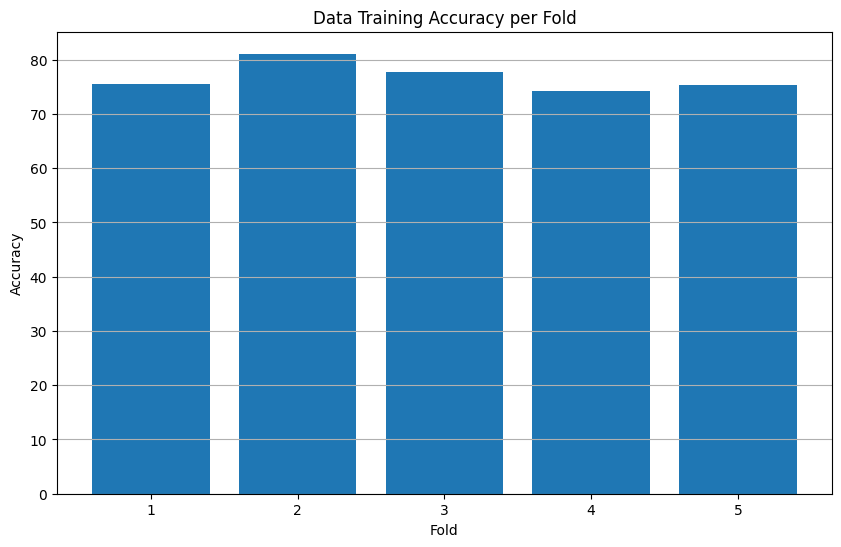

In [154]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

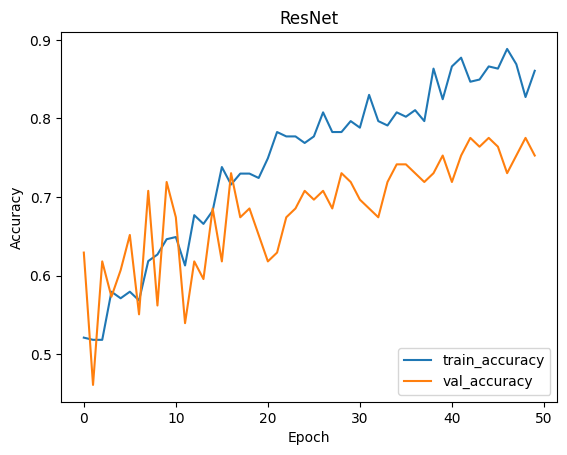

In [155]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('ResNet')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(resnet)

In [156]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_resnet_tuning/model_resnet_tuning_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model1.h5')
    print(f'Model with the best accuracy saved as model1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 2.1898343563079834 - Accuracy: 79.46428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 206ms/step
Model Evaluate Accuracy Score for fold 1: 79.46428571428571%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.84      0.77      0.81        62
           1       0.75      0.82      0.78        50

    accuracy                           0.79       112
   macro avg       0.79      0.80      0.79       112
weighted avg       0.80      0.79      0.80       112



Fold 2 - Loss: 2.2139999866485596 - Accuracy: 75.89285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 162ms/step
Model Evaluate Accuracy Score for fold 2: 75.89285714285714%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.84      0.69      0.76        62
           1       0.69      0.84      0.76        50

    accuracy                           0.76       112
   macro avg       0.77      0.77      0.76       112
weighted avg       0.77      0.76      0.76       112



Fold 3 - Loss: 2.0382230281829834 - Accuracy: 84.82142686843872%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step
Model Evaluate Accuracy Score for fold 3: 84.82142857142857%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.89      0.82      0.86        62
           1       0.80      0.88      0.84        50

    accuracy                           0.85       112
   macro avg       0.85      0.85      0.85       112
weighted avg       0.85      0.85      0.85       112



Fold 4 - Loss: 2.1056363582611084 - Accuracy: 80.35714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 182ms/step
Model Evaluate Accuracy Score for fold 4: 80.35714285714286%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.83      0.81      0.82        62
           1       0.77      0.80      0.78        50

    accuracy                           0.80       112
   macro avg       0.80      0.80      0.80       112
weighted avg       0.80      0.80      0.80       112



Fold 5 - Loss: 2.0595874786376953 - Accuracy: 85.71428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 161ms/step
Model Evaluate Accuracy Score for fold 5: 85.71428571428571%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.85      0.90      0.88        62
           1       0.87      0.80      0.83        50

    accuracy                           0.86       112
   macro avg       0.86      0.85      0.85       112
weighted avg       0.86      0.86      0.86       112

------------------------------------------------------------------------
Score per fold
> Fold 1 - Loss: 2.1898343563079834 - Accuracy: 79.46428656578064%
> Fold 2 - Loss: 2.2139999866485596 - Accuracy: 75.89285969734192%
> Fold 3 - Loss: 2.0382230281829834 - Accuracy: 84.82142686843872%
> Fold 4 - Loss: 2.1056363582611084 - Accuracy: 80.35714030265808%
> Fold 5 - Loss: 2.0595874786376953 - Accuracy: 85.71428656578064%
--------------------------------------------------

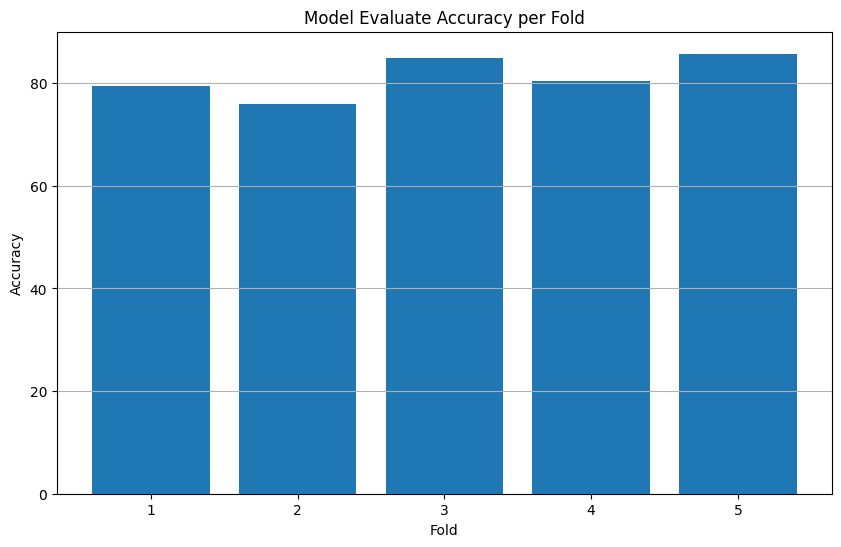

In [157]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

In [158]:
from sklearn.preprocessing import LabelEncoder

# Ekstrak kolom label dari dataset
labels = df_combine_scaled['Label'].values

# Fit label encoder dengan label asli
label_encoder = LabelEncoder()
label_encoded = label_encoder.fit_transform(labels)

# Cetak label yang terasosiasi dengan angka 0 dan 1
print("Label untuk Class 0:", label_encoder.classes_[0])
print("Label untuk Class 1:", label_encoder.classes_[1])

Label untuk Class 0: MI
Label untuk Class 1: Normal


4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 255ms/step


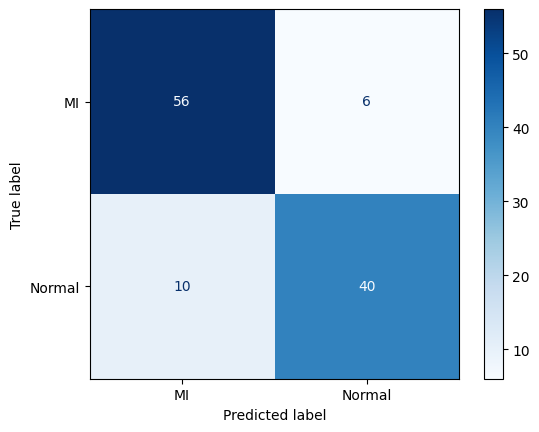

In [159]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Lakukan prediksi pada data test
y_pred = model_resnet.predict(X_test)

# Konversi prediksi menjadi label kelas
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

# Buat confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Tampilkan confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()

### VGG16

In [77]:
from tensorflow.keras.layers import SeparableConv1D, Conv1D, BatchNormalization, Activation, Add, MaxPooling1D, GlobalAveragePooling1D, Dense, Dropout, Input
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

def xception_block(x, filters, kernel_size=3, strides=1):
    residual = x
    
    x = SeparableConv1D(filters, kernel_size, strides=strides, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = SeparableConv1D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = SeparableConv1D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)

    if residual.shape[-1] != x.shape[-1]:
        residual = Conv1D(filters, 1, strides=strides, padding='same')(residual)
        residual = BatchNormalization()(residual)

    x = Add()([x, residual])
    x = Activation('relu')(x)

    return x

def build_xception_1d(input_shape, num_classes):
    inputs = Input(shape=input_shape)
    
    x = Conv1D(32, 3, strides=2, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = xception_block(x, 64)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)  # Dropout to prevent overfitting
    
    x = xception_block(x, 128)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)  # Dropout to prevent overfitting
    
    x = xception_block(x, 256)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)  # Dropout to prevent overfitting
    
    x = xception_block(x, 728)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    
    x = GlobalAveragePooling1D()(x)
    outputs = Dense(num_classes, activation='softmax', kernel_regularizer=l2(0.01))(x)  # Regularization added
    
    model = Model(inputs, outputs)
    return model

# import tensorflow as tf
# from tensorflow.keras import layers, models

# # Definisikan model VGG16 1D
# def VGG16_1D(input_shape):
#     model = models.Sequential()

#     # Block 1
#     model.add(layers.Conv1D(64, 3, activation='relu', padding='same', input_shape=input_shape))
#     model.add(layers.Conv1D(64, 3, activation='relu', padding='same'))
#     model.add(layers.MaxPooling1D(2, padding='same'))

#     # Block 2
#     model.add(layers.Conv1D(128, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(128, 3, activation='relu', padding='same'))

#     # Block 3 (Remove MaxPooling1D to avoid negative dimension error)
#     model.add(layers.Conv1D(256, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(256, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(256, 3, activation='relu', padding='same'))

#     # Block 4
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))

#     # Block 5
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))
#     model.add(layers.Conv1D(512, 3, activation='relu', padding='same'))

#     # Fully Connected Layers
#     model.add(layers.Flatten())
#     model.add(layers.Dense(4096, activation='relu'))
#     model.add(layers.Dense(4096, activation='relu'))
#     model.add(layers.Dense(2, activation='softmax'))  # Mengganti lapisan terakhir


#     return model

In [78]:
# Bentuk input (jumlah fitur, 1)
input_shape = (25, 1)  # Sesuaikan dengan data Anda
num_classes = 2  # Binary classification

In [79]:
# Buat model
# model = VGG16_1D(input_shape)
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model = build_xception_1d(input_shape, num_classes)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Tampilkan ringkasan model
model.summary()

Model: "functional_131"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_13      │ (None, 25, 1)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_102 (Conv1D) │ (None, 13, 32)    │        128 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 32)    │        128 │ conv1d_102[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_58       │ (None, 13, 32)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv1d_53 │ (None, 13, 64)    │      2,208 │ activation_58[0]… │
│ (SeparableConv1D)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ separable_conv1d… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_59       │ (None, 13, 64)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv1d_54 │ (None, 13, 64)    │      4,352 │ activation_59[0]… │
│ (SeparableConv1D)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ separable_conv1d… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_60       │ (None, 13, 64)    │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv1d_55 │ (None, 13, 64)    │      4,352 │ activation_60[0]… │
│ (SeparableConv1D)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_103 (Conv1D) │ (None, 13, 64)    │      2,112 │ activation_58[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ separable_conv1d… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 13, 64)    │        256 │ conv1d_103[0][0]  │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_17 (Add)        │ (None, 13, 64)    │          0 │ batch_normalizat… │
│                     │                   │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_61       │ (None, 13, 64)    │          0 │ add_17[0][0]      │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_39    │ (None, 7, 64)     │          0 │ activation_61[0]… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 1,724,482 (6.58 MB)

 Trainable params: 1,715,010 (6.54 MB)

 Non-trainable params: 9,472 (37.00 KB)

In [91]:
import tensorflow as tf
from tensorflow.keras import layers, models

def create_transfer_learning_model(input_shape):
    # Input layer
    inputs = layers.Input(shape=input_shape)

    # Base model dari arsitektur transfer learning yang dimodifikasi untuk 1D
    # Blok Konvolusi 1
    x = layers.Conv1D(64, kernel_size=7, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.MaxPooling1D(pool_size=3, strides=2, padding="same")(x)

    # Blok Konvolusi 2
    x = layers.Conv1D(128, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv1D(128, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.MaxPooling1D(pool_size=3, strides=2, padding="same")(x)

    # Blok Konvolusi 3
    x = layers.Conv1D(256, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv1D(256, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.MaxPooling1D(pool_size=3, strides=2, padding="same")(x)

    # Blok Konvolusi 4
    x = layers.Conv1D(512, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv1D(512, kernel_size=3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.MaxPooling1D(pool_size=3, strides=2, padding="same")(x)

    # Lapisan GlobalAveragePooling1D untuk mengurangi dimensi
    x = layers.GlobalAveragePooling1D()(x)

    # Fully Connected Layers
    x = layers.Dense(256, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    x = layers.Dense(128, activation='relu')(x)
    x = layers.Dropout(0.5)(x)

    # Output layer
    outputs = layers.Dense(2, activation='softmax')(x)

    # Buat model
    model = models.Model(inputs=inputs, outputs=outputs)

    return model

# Misalnya, jika input data memiliki bentuk (5000, 1)
model = create_transfer_learning_model(input_shape=(5000, 1))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()


Model: "functional_147"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_24 (InputLayer)     │ (None, 5000, 1)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_149 (Conv1D)             │ (None, 2500, 64)       │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 2500, 64)       │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 2500, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_71 (MaxPooling1D) │ (None, 1250, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_150 (Conv1D)             │ (None, 1250, 128)      │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 1250, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 1250, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_151 (Conv1D)             │ (None, 1250, 128)      │        49,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 1250, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 1250, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_72 (MaxPooling1D) │ (None, 625, 128)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_152 (Conv1D)             │ (None, 625, 256)       │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 625, 256)       │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 625, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_153 (Conv1D)             │ (None, 625, 256)       │       196,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 625, 256)       │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 625, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_73 (MaxPooling1D) │ (None, 313, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_154 (Conv1D)             │ (None, 313, 512)       │       393,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 313, 512)       │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 313, 512)       │             

 Total params: 1,722,498 (6.57 MB)

 Trainable params: 1,718,786 (6.56 MB)

 Non-trainable params: 3,712 (14.50 KB)

In [92]:
# KFold Cross Validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_xception', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Menambahkan dimensi ekstra untuk menyesuaikan input dengan Conv1D
    X_train_fold = np.expand_dims(X_train_fold, axis=-1)
    X_val_fold = np.expand_dims(X_val_fold, axis=-1)
    
    # Membuat model baru
    model_xception = create_transfer_learning_model(input_shape=X_train_fold.shape[1:])
    
    # Compile model
    model_xception.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Callback untuk early stopping
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    
    # Melatih model
    history = model_xception.fit(X_train_fold, y_train_fold, batch_size=64, epochs=25, 
                                 validation_data=(X_val_fold, y_val_fold), verbose=2, callbacks=[early_stopping])
    
        # Evaluasi model pada data validasi fold
    scores = model_xception.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_xception.metrics_names[0]} of {scores[0]}; {model_xception.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_xception/model_xception_fold_{fold_no}.h5'
    model_xception.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

Fold 1
Epoch 1/25
6/6 - 11s - 2s/step - accuracy: 0.5391 - loss: 0.9522 - val_accuracy: 0.5000 - val_loss: 0.6890
Epoch 2/25
6/6 - 1s - 103ms/step - accuracy: 0.6173 - loss: 0.8853 - val_accuracy: 0.6333 - val_loss: 0.6923
Epoch 3/25
6/6 - 1s - 111ms/step - accuracy: 0.6536 - loss: 0.8124 - val_accuracy: 0.6778 - val_loss: 0.6924
Epoch 4/25
6/6 - 1s - 101ms/step - accuracy: 0.7235 - loss: 0.6026 - val_accuracy: 0.7111 - val_loss: 0.6679
Epoch 5/25
6/6 - 1s - 96ms/step - accuracy: 0.8184 - loss: 0.4306 - val_accuracy: 0.6000 - val_loss: 0.6542
Epoch 6/25
6/6 - 1s - 96ms/step - accuracy: 0.8687 - loss: 0.3828 - val_accuracy: 0.5889 - val_loss: 0.6412
Epoch 7/25
6/6 - 1s - 92ms/step - accuracy: 0.8855 - loss: 0.3055 - val_accuracy: 0.5667 - val_loss: 0.6482
Epoch 8/25
6/6 - 1s - 89ms/step - accuracy: 0.9134 - loss: 0.3056 - val_accuracy: 0.6000 - val_loss: 0.6553
Epoch 9/25
6/6 - 1s - 91ms/step - accuracy: 0.9050 - loss: 0.2594 - val_accuracy: 0.5778 - val_loss: 0.6491
Epoch 10/25
6/6 - 1


Model for fold 1 saved as models_xception/model_xception_fold_1.h5
Fold 2
Epoch 1/25
6/6 - 8s - 1s/step - accuracy: 0.5419 - loss: 1.0816 - val_accuracy: 0.4778 - val_loss: 0.6904
Epoch 2/25
6/6 - 1s - 93ms/step - accuracy: 0.6313 - loss: 0.7420 - val_accuracy: 0.5889 - val_loss: 0.6878
Epoch 3/25
6/6 - 1s - 99ms/step - accuracy: 0.6089 - loss: 0.7134 - val_accuracy: 0.6444 - val_loss: 0.6890
Epoch 4/25
6/6 - 1s - 88ms/step - accuracy: 0.7039 - loss: 0.7155 - val_accuracy: 0.6000 - val_loss: 0.6684
Epoch 5/25
6/6 - 1s - 86ms/step - accuracy: 0.7318 - loss: 0.5411 - val_accuracy: 0.6111 - val_loss: 0.6635
Epoch 6/25
6/6 - 1s - 111ms/step - accuracy: 0.7709 - loss: 0.4795 - val_accuracy: 0.6889 - val_loss: 0.6413
Epoch 7/25
6/6 - 1s - 93ms/step - accuracy: 0.8184 - loss: 0.4235 - val_accuracy: 0.5667 - val_loss: 0.6564
Epoch 8/25
6/6 - 0s - 71ms/step - accuracy: 0.8855 - loss: 0.3233 - val_accuracy: 0.5778 - val_loss: 0.6533
Epoch 9/25
6/6 - 0s - 74ms/step - accuracy: 0.8771 - loss: 0.2

Score for fold 2: loss of 0.5736656188964844; compile_metrics of 71.11111283302307%
Model for fold 2 saved as models_xception/model_xception_fold_2.h5
Fold 3
Epoch 1/25
6/6 - 6s - 990ms/step - accuracy: 0.5196 - loss: 1.2554 - val_accuracy: 0.5333 - val_loss: 0.6933
Epoch 2/25
6/6 - 0s - 73ms/step - accuracy: 0.6173 - loss: 0.8157 - val_accuracy: 0.5444 - val_loss: 0.6916
Epoch 3/25
6/6 - 0s - 77ms/step - accuracy: 0.6844 - loss: 0.7258 - val_accuracy: 0.6111 - val_loss: 0.6829
Epoch 4/25
6/6 - 0s - 75ms/step - accuracy: 0.6927 - loss: 0.5838 - val_accuracy: 0.5444 - val_loss: 0.6861
Epoch 5/25
6/6 - 0s - 77ms/step - accuracy: 0.7374 - loss: 0.6892 - val_accuracy: 0.5444 - val_loss: 0.6738
Epoch 6/25
6/6 - 0s - 73ms/step - accuracy: 0.7793 - loss: 0.5341 - val_accuracy: 0.5444 - val_loss: 0.6693
Epoch 7/25
6/6 - 0s - 75ms/step - accuracy: 0.8883 - loss: 0.3473 - val_accuracy: 0.5444 - val_loss: 0.7065
Epoch 8/25
6/6 - 0s - 76ms/step - accuracy: 0.9134 - loss: 0.2800 - val_accuracy: 0.5

Score for fold 3: loss of 0.6693338751792908; compile_metrics of 54.44444417953491%
Model for fold 3 saved as models_xception/model_xception_fold_3.h5
Fold 4
Epoch 1/25
6/6 - 19s - 3s/step - accuracy: 0.5933 - loss: 0.8090 - val_accuracy: 0.5281 - val_loss: 0.7008
Epoch 2/25
6/6 - 1s - 102ms/step - accuracy: 0.6184 - loss: 1.0206 - val_accuracy: 0.5281 - val_loss: 0.6959
Epoch 3/25
6/6 - 1s - 101ms/step - accuracy: 0.6240 - loss: 0.7648 - val_accuracy: 0.5393 - val_loss: 0.6977
Epoch 4/25
6/6 - 1s - 103ms/step - accuracy: 0.6880 - loss: 0.6279 - val_accuracy: 0.6180 - val_loss: 0.6888
Epoch 5/25
6/6 - 1s - 96ms/step - accuracy: 0.7465 - loss: 0.4821 - val_accuracy: 0.5730 - val_loss: 0.6725
Epoch 6/25
6/6 - 1s - 95ms/step - accuracy: 0.8440 - loss: 0.3682 - val_accuracy: 0.5506 - val_loss: 0.6726
Epoch 7/25
6/6 - 1s - 103ms/step - accuracy: 0.8802 - loss: 0.2789 - val_accuracy: 0.5618 - val_loss: 0.6651
Epoch 8/25
6/6 - 1s - 89ms/step - accuracy: 0.9443 - loss: 0.1712 - val_accuracy: 0

Score for fold 4: loss of 0.6451669931411743; compile_metrics of 70.78651785850525%
Model for fold 4 saved as models_xception/model_xception_fold_4.h5
Fold 5
Epoch 1/25
6/6 - 7s - 1s/step - accuracy: 0.5209 - loss: 1.0271 - val_accuracy: 0.5169 - val_loss: 0.6929
Epoch 2/25
6/6 - 1s - 91ms/step - accuracy: 0.7047 - loss: 0.7393 - val_accuracy: 0.4831 - val_loss: 0.6917
Epoch 3/25
6/6 - 1s - 91ms/step - accuracy: 0.6741 - loss: 0.6965 - val_accuracy: 0.6629 - val_loss: 0.6841
Epoch 4/25
6/6 - 1s - 88ms/step - accuracy: 0.7604 - loss: 0.5601 - val_accuracy: 0.5730 - val_loss: 0.6846
Epoch 5/25
6/6 - 1s - 91ms/step - accuracy: 0.8134 - loss: 0.4641 - val_accuracy: 0.5618 - val_loss: 0.6657
Epoch 6/25
6/6 - 1s - 92ms/step - accuracy: 0.8719 - loss: 0.3022 - val_accuracy: 0.6404 - val_loss: 0.6519
Epoch 7/25
6/6 - 1s - 93ms/step - accuracy: 0.8969 - loss: 0.2757 - val_accuracy: 0.5506 - val_loss: 0.6611
Epoch 8/25
6/6 - 1s - 91ms/step - accuracy: 0.9415 - loss: 0.1827 - val_accuracy: 0.5506

Score for fold 5: loss of 0.5903036594390869; compile_metrics of 71.91011309623718%
Model for fold 5 saved as models_xception/model_xception_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.6170195937156677 - Accuracy: 69.9999988079071%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.5736656188964844 - Accuracy: 71.11111283302307%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.6693338751792908 - Accuracy: 54.44444417953491%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.6451669931411743 - Accuracy: 70.78651785850525%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.5903036594390869 - Accuracy: 71.91011309623718%
--------------------------------------------------------------

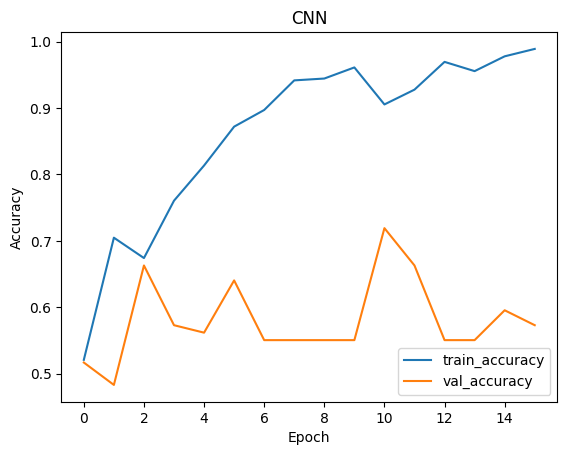

In [93]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(history)

In [86]:
from sklearn.model_selection import KFold
import numpy as np
import os
from tensorflow.keras.layers import SeparableConv1D, Conv1D, BatchNormalization, Activation, Add, MaxPooling1D, GlobalAveragePooling1D, Dense, Dropout, Input
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

# Fungsi untuk membangun model Xception 1D
def xception_block(x, filters, kernel_size=3, strides=1):
    residual = x
    
    x = SeparableConv1D(filters, kernel_size, strides=strides, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = SeparableConv1D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = SeparableConv1D(filters, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)

    if residual.shape[-1] != x.shape[-1]:
        residual = Conv1D(filters, 1, strides=strides, padding='same')(residual)
        residual = BatchNormalization()(residual)

    x = Add()([x, residual])
    x = Activation('relu')(x)

    return x

def build_xception_1d(input_shape, num_classes):
    inputs = Input(shape=input_shape)
    
    x = Conv1D(32, 3, strides=2, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = xception_block(x, 64)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)
    
    x = xception_block(x, 128)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)
    
    x = xception_block(x, 256)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    x = Dropout(0.5)(x)
    
    x = xception_block(x, 728)
    x = MaxPooling1D(3, strides=2, padding='same')(x)
    
    x = GlobalAveragePooling1D()(x)
    outputs = Dense(num_classes, activation='softmax', kernel_regularizer=l2(0.01))(x)
    
    model = Model(inputs, outputs)
    return model

# KFold Cross Validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_xception', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Menambahkan dimensi ekstra untuk menyesuaikan input dengan Conv1D
    X_train_fold = np.expand_dims(X_train_fold, axis=-1)
    X_val_fold = np.expand_dims(X_val_fold, axis=-1)
    
    # Membuat model baru
    model_xception = build_xception_1d(input_shape=X_train_fold.shape[1:], num_classes=2)
    
    # Compile model
    model_xception.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Callback untuk early stopping
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    
    # Melatih model
    history = model_xception.fit(X_train_fold, y_train_fold, batch_size=64, epochs=25, 
                                 validation_data=(X_val_fold, y_val_fold), verbose=2, callbacks=[early_stopping])
    
    # Evaluasi model pada data validasi fold
    scores = model_xception.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_xception.metrics_names[0]} of {scores[0]}; {model_xception.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_xception/model_xception_fold_{fold_no}.h5'
    model_xception.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/25
6/6 - 19s - 3s/step - accuracy: 0.5140 - loss: 1.1778 - val_accuracy: 0.4333 - val_loss: 0.7370
Epoch 2/25
6/6 - 2s - 322ms/step - accuracy: 0.4944 - loss: 1.2224 - val_accuracy: 0.4667 - val_loss: 0.7300
Epoch 3/25
6/6 - 2s - 388ms/step - accuracy: 0.5447 - loss: 1.0842 - val_accuracy: 0.4667 - val_loss: 0.7374
Epoch 4/25
6/6 - 3s - 420ms/step - accuracy: 0.5196 - loss: 1.2301 - val_accuracy: 0.4667 - val_loss: 0.7287
Epoch 5/25
6/6 - 2s - 315ms/step - accuracy: 0.5782 - loss: 0.9395 - val_accuracy: 0.4667 - val_loss: 0.7316
Epoch 6/25
6/6 - 2s - 259ms/step - accuracy: 0.5615 - loss: 0.9685 - val_accuracy: 0.4667 - val_loss: 0.7313
Epoch 7/25
6/6 - 2s - 252ms/step - accuracy: 0.5279 - loss: 1.0113 - val_accuracy: 0.4556 - val_loss: 0.7303
Epoch 8/25
6/6 - 2s - 281ms/step - accuracy: 0.5838 - loss: 0.8477 - val_accuracy: 0.4667 - val_loss: 0.7315
Epoch 9/25
6/6 - 2s - 256ms/step - accuracy: 0.6006 - loss: 0.8193 - val_accuracy: 0.5000 - val_loss: 0.7294


Score for fold 1: loss of 0.7287150025367737; compile_metrics of 46.666666865348816%
Model for fold 1 saved as models_xception/model_xception_fold_1.h5
Fold 2
Epoch 1/25
6/6 - 19s - 3s/step - accuracy: 0.4888 - loss: 1.0482 - val_accuracy: 0.3889 - val_loss: 0.7383
Epoch 2/25
6/6 - 2s - 269ms/step - accuracy: 0.5503 - loss: 1.0262 - val_accuracy: 0.5111 - val_loss: 0.7409
Epoch 3/25
6/6 - 2s - 257ms/step - accuracy: 0.5419 - loss: 1.1858 - val_accuracy: 0.5222 - val_loss: 0.7333
Epoch 4/25
6/6 - 1s - 237ms/step - accuracy: 0.5559 - loss: 1.1387 - val_accuracy: 0.5222 - val_loss: 0.7366
Epoch 5/25
6/6 - 2s - 261ms/step - accuracy: 0.5419 - loss: 0.9654 - val_accuracy: 0.5222 - val_loss: 0.7403
Epoch 6/25
6/6 - 1s - 239ms/step - accuracy: 0.5307 - loss: 0.9928 - val_accuracy: 0.5222 - val_loss: 0.7348
Epoch 7/25
6/6 - 1s - 224ms/step - accuracy: 0.5335 - loss: 1.0419 - val_accuracy: 0.5222 - val_loss: 0.7388
Epoch 8/25
6/6 - 1s - 243ms/step - accuracy: 0.5279 - loss: 0.9825 - val_accurac

Score for fold 2: loss of 0.7332568764686584; compile_metrics of 52.222222089767456%
Model for fold 2 saved as models_xception/model_xception_fold_2.h5
Fold 3
Epoch 1/25
6/6 - 15s - 3s/step - accuracy: 0.5196 - loss: 1.0162 - val_accuracy: 0.5222 - val_loss: 0.7322
Epoch 2/25
6/6 - 2s - 278ms/step - accuracy: 0.5391 - loss: 1.0321 - val_accuracy: 0.4667 - val_loss: 0.7320
Epoch 3/25
6/6 - 2s - 275ms/step - accuracy: 0.5251 - loss: 1.1278 - val_accuracy: 0.5222 - val_loss: 0.7300
Epoch 4/25
6/6 - 2s - 293ms/step - accuracy: 0.5279 - loss: 1.0742 - val_accuracy: 0.5444 - val_loss: 0.7285
Epoch 5/25
6/6 - 2s - 279ms/step - accuracy: 0.5251 - loss: 0.9784 - val_accuracy: 0.5111 - val_loss: 0.7289
Epoch 6/25
6/6 - 2s - 266ms/step - accuracy: 0.5698 - loss: 0.8863 - val_accuracy: 0.5556 - val_loss: 0.7258
Epoch 7/25
6/6 - 2s - 269ms/step - accuracy: 0.5447 - loss: 0.9139 - val_accuracy: 0.5667 - val_loss: 0.7254
Epoch 8/25
6/6 - 2s - 254ms/step - accuracy: 0.6034 - loss: 0.8380 - val_accurac

Score for fold 3: loss of 0.7192965149879456; compile_metrics of 53.33333611488342%
Model for fold 3 saved as models_xception/model_xception_fold_3.h5
Fold 4
Epoch 1/25
6/6 - 14s - 2s/step - accuracy: 0.4986 - loss: 1.2389 - val_accuracy: 0.4719 - val_loss: 0.7362
Epoch 2/25
6/6 - 1s - 219ms/step - accuracy: 0.5153 - loss: 1.5262 - val_accuracy: 0.4157 - val_loss: 0.7330
Epoch 3/25
6/6 - 1s - 233ms/step - accuracy: 0.5710 - loss: 1.0825 - val_accuracy: 0.5506 - val_loss: 0.7266
Epoch 4/25
6/6 - 1s - 233ms/step - accuracy: 0.5014 - loss: 1.0603 - val_accuracy: 0.4719 - val_loss: 0.7297
Epoch 5/25
6/6 - 1s - 216ms/step - accuracy: 0.5125 - loss: 1.0545 - val_accuracy: 0.5506 - val_loss: 0.7295
Epoch 6/25
6/6 - 1s - 224ms/step - accuracy: 0.5237 - loss: 0.9901 - val_accuracy: 0.4494 - val_loss: 0.7309
Epoch 7/25
6/6 - 1s - 236ms/step - accuracy: 0.5404 - loss: 0.9756 - val_accuracy: 0.4607 - val_loss: 0.7304
Epoch 8/25
6/6 - 1s - 213ms/step - accuracy: 0.5209 - loss: 0.9342 - val_accuracy

Score for fold 4: loss of 0.7266491055488586; compile_metrics of 55.0561785697937%
Model for fold 4 saved as models_xception/model_xception_fold_4.h5
Fold 5
Epoch 1/25
6/6 - 19s - 3s/step - accuracy: 0.5738 - loss: 1.0310 - val_accuracy: 0.4494 - val_loss: 0.7456
Epoch 2/25
6/6 - 1s - 219ms/step - accuracy: 0.5292 - loss: 1.2410 - val_accuracy: 0.5281 - val_loss: 0.7287
Epoch 3/25
6/6 - 1s - 219ms/step - accuracy: 0.4652 - loss: 1.0788 - val_accuracy: 0.4494 - val_loss: 0.7306
Epoch 4/25
6/6 - 1s - 222ms/step - accuracy: 0.5265 - loss: 1.0699 - val_accuracy: 0.5618 - val_loss: 0.7269
Epoch 5/25
6/6 - 1s - 233ms/step - accuracy: 0.5237 - loss: 0.9582 - val_accuracy: 0.5618 - val_loss: 0.7276
Epoch 6/25
6/6 - 1s - 233ms/step - accuracy: 0.5292 - loss: 1.0399 - val_accuracy: 0.5506 - val_loss: 0.7245
Epoch 7/25
6/6 - 1s - 222ms/step - accuracy: 0.5599 - loss: 0.9715 - val_accuracy: 0.5506 - val_loss: 0.7241
Epoch 8/25
6/6 - 1s - 225ms/step - accuracy: 0.5404 - loss: 0.8616 - val_accuracy:

Score for fold 5: loss of 0.7178319692611694; compile_metrics of 55.0561785697937%
Model for fold 5 saved as models_xception/model_xception_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.7287150025367737 - Accuracy: 46.666666865348816%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.7332568764686584 - Accuracy: 52.222222089767456%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.7192965149879456 - Accuracy: 53.33333611488342%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.7266491055488586 - Accuracy: 55.0561785697937%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.7178319692611694 - Accuracy: 55.0561785697937%
--------------------------------------------------------------

In [87]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 46.666666865348816%
Fold 2: 52.222222089767456%
Fold 3: 53.33333611488342%
Fold 4: 55.0561785697937%
Fold 5: 55.0561785697937%


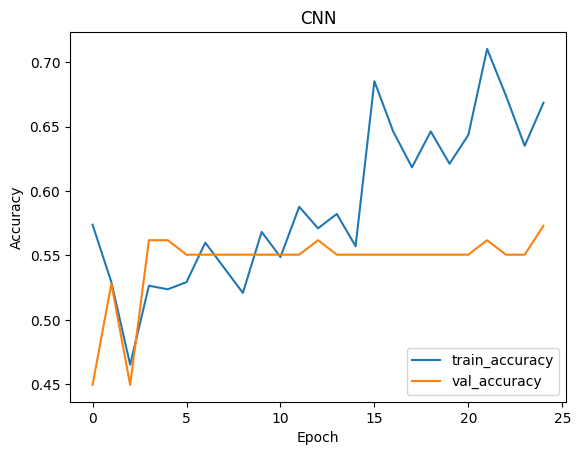

In [88]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(history)

In [80]:
# history = model.fit(X_train, y_train, epochs=25, validation_data=(X_test, y_test), batch_size=32)
history = model.fit(X_train, y_train, epochs=25, validation_data=(X_test, y_test), batch_size=32, callbacks=[early_stopping])

Epoch 1/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 17s 247ms/step - accuracy: 0.4964 - loss: 0.9344 - val_accuracy: 0.5536 - val_loss: 0.7307
Epoch 2/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 190ms/step - accuracy: 0.5280 - loss: 0.9251 - val_accuracy: 0.5536 - val_loss: 0.7287
Epoch 3/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 184ms/step - accuracy: 0.5056 - loss: 0.9478 - val_accuracy: 0.5536 - val_loss: 0.7251
Epoch 4/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 180ms/step - accuracy: 0.5351 - loss: 0.8330 - val_accuracy: 0.5536 - val_loss: 0.7245
Epoch 5/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 176ms/step - accuracy: 0.5772 - loss: 0.8247 - val_accuracy: 0.5536 - val_loss: 0.7219
Epoch 6/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 171ms/step - accuracy: 0.5543 - loss: 0.8297 - val_accuracy: 0.5357 - val_loss: 0.7247
Epoch 7/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 168ms/step - accuracy: 0.5821 - loss: 0.7640 - val_accuracy: 0.4375 - val_loss: 0.7269
Epoch 8/25
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 176ms/step - accuracy: 0.6092 - loss: 0.7510 - val_accuracy: 0

In [81]:
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Accuracy on test data: {accuracy * 100:.2f}%')

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5443 - loss: 0.7034
Accuracy on test data: 55.36%


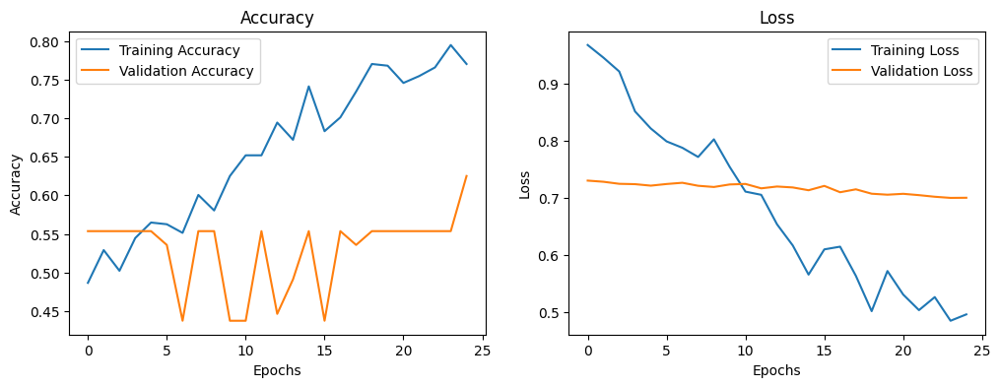

In [82]:
import matplotlib.pyplot as plt

# Menampilkan grafik akurasi dan loss
plt.figure(figsize=(12, 4))

# Grafik akurasi
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Grafik loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

loss, accuracy = model.evaluate(X_test, y_test)
print(f'Accuracy on test data: {accuracy * 100:.2f}%')


### CNN

In [190]:
import tensorflow as tf

def create_cnn_model(input_shape, num_classes):
    model = tf.keras.Sequential([
        tf.keras.layers.Conv1D(32, 3, activation='relu', input_shape=input_shape),
        tf.keras.layers.MaxPooling1D(2),
        tf.keras.layers.Conv1D(64, 3, activation='relu'),
        tf.keras.layers.MaxPooling1D(2),
        tf.keras.layers.Conv1D(128, 3, activation='relu'),
        tf.keras.layers.GlobalAveragePooling1D(),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

model_cnn = create_cnn_model(input_shape, 2)
model_cnn.summary()

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_78 (Conv1D)              │ (None, 23, 32)         │           128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_52 (MaxPooling1D) │ (None, 11, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_79 (Conv1D)              │ (None, 9, 64)          │         6,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_53 (MaxPooling1D) │ (None, 4, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_80 (Conv1D)              │ (None, 2, 128)         │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_26     │ (None, 128)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 39,426 (154.01 KB)

 Trainable params: 39,426 (154.01 KB)

 Non-trainable params: 0 (0.00 B)

In [191]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_cnn', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_cnn = create_cnn_model(input_shape, 2)
    
    # Melatih model
    cnn = model_cnn.fit(X_train_fold, y_train_fold, batch_size=64, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_cnn.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_cnn.metrics_names[0]} of {scores[0]}; {model_cnn.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_cnn/model_cnn_fold_{fold_no}.h5'
    model_cnn.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/50
6/6 - 3s - 494ms/step - accuracy: 0.5475 - loss: 0.6856 - val_accuracy: 0.5111 - val_loss: 0.6765
Epoch 2/50
6/6 - 0s - 28ms/step - accuracy: 0.5559 - loss: 0.6695 - val_accuracy: 0.6222 - val_loss: 0.6558
Epoch 3/50
6/6 - 0s - 31ms/step - accuracy: 0.6453 - loss: 0.6442 - val_accuracy: 0.6778 - val_loss: 0.6372
Epoch 4/50
6/6 - 0s - 43ms/step - accuracy: 0.6872 - loss: 0.6125 - val_accuracy: 0.6111 - val_loss: 0.6198
Epoch 5/50
6/6 - 0s - 28ms/step - accuracy: 0.6425 - loss: 0.5896 - val_accuracy: 0.6333 - val_loss: 0.6117
Epoch 6/50
6/6 - 0s - 26ms/step - accuracy: 0.6844 - loss: 0.5717 - val_accuracy: 0.6444 - val_loss: 0.5890
Epoch 7/50
6/6 - 0s - 22ms/step - accuracy: 0.6844 - loss: 0.5680 - val_accuracy: 0.6444 - val_loss: 0.6025
Epoch 8/50
6/6 - 0s - 21ms/step - accuracy: 0.6955 - loss: 0.5356 - val_accuracy: 0.6778 - val_loss: 0.5733
Epoch 9/50
6/6 - 0s - 19ms/step - accuracy: 0.7207 - loss: 0.5287 - val_accuracy: 0.7222 - val_loss: 0.5731
Epoch 10/50
6/6 - 0s

Score for fold 1: loss of 0.850732147693634; compile_metrics of 77.77777910232544%
Model for fold 1 saved as models_cnn/model_cnn_fold_1.h5
Fold 2
Epoch 1/50
6/6 - 2s - 352ms/step - accuracy: 0.5251 - loss: 0.6857 - val_accuracy: 0.5556 - val_loss: 0.6807
Epoch 2/50
6/6 - 0s - 18ms/step - accuracy: 0.6341 - loss: 0.6502 - val_accuracy: 0.4889 - val_loss: 0.6574
Epoch 3/50
6/6 - 0s - 21ms/step - accuracy: 0.6676 - loss: 0.6181 - val_accuracy: 0.5222 - val_loss: 0.6535
Epoch 4/50
6/6 - 0s - 21ms/step - accuracy: 0.6872 - loss: 0.5952 - val_accuracy: 0.5333 - val_loss: 0.6327
Epoch 5/50
6/6 - 0s - 24ms/step - accuracy: 0.6899 - loss: 0.5698 - val_accuracy: 0.5000 - val_loss: 0.6321
Epoch 6/50
6/6 - 0s - 28ms/step - accuracy: 0.6955 - loss: 0.5482 - val_accuracy: 0.5556 - val_loss: 0.6189
Epoch 7/50
6/6 - 0s - 23ms/step - accuracy: 0.7151 - loss: 0.5265 - val_accuracy: 0.6222 - val_loss: 0.5994
Epoch 8/50
6/6 - 0s - 22ms/step - accuracy: 0.7318 - loss: 0.5163 - val_accuracy: 0.6333 - val_l

Score for fold 2: loss of 0.9262166619300842; compile_metrics of 66.66666865348816%
Model for fold 2 saved as models_cnn/model_cnn_fold_2.h5
Fold 3
Epoch 1/50
6/6 - 3s - 455ms/step - accuracy: 0.5475 - loss: 0.6855 - val_accuracy: 0.6111 - val_loss: 0.6696
Epoch 2/50
6/6 - 0s - 29ms/step - accuracy: 0.6229 - loss: 0.6526 - val_accuracy: 0.6667 - val_loss: 0.6537
Epoch 3/50
6/6 - 0s - 25ms/step - accuracy: 0.6760 - loss: 0.6280 - val_accuracy: 0.6000 - val_loss: 0.6314
Epoch 4/50
6/6 - 0s - 24ms/step - accuracy: 0.6648 - loss: 0.6049 - val_accuracy: 0.6667 - val_loss: 0.6172
Epoch 5/50
6/6 - 0s - 23ms/step - accuracy: 0.6955 - loss: 0.5840 - val_accuracy: 0.6667 - val_loss: 0.6068
Epoch 6/50
6/6 - 0s - 23ms/step - accuracy: 0.7179 - loss: 0.5591 - val_accuracy: 0.6444 - val_loss: 0.5992
Epoch 7/50
6/6 - 0s - 22ms/step - accuracy: 0.7263 - loss: 0.5351 - val_accuracy: 0.6444 - val_loss: 0.5989
Epoch 8/50
6/6 - 0s - 22ms/step - accuracy: 0.7430 - loss: 0.5234 - val_accuracy: 0.6667 - val_

Score for fold 3: loss of 0.9607495069503784; compile_metrics of 76.66666507720947%
Model for fold 3 saved as models_cnn/model_cnn_fold_3.h5
Fold 4
Epoch 1/50
6/6 - 4s - 585ms/step - accuracy: 0.5292 - loss: 0.6803 - val_accuracy: 0.6742 - val_loss: 0.6659
Epoch 2/50
6/6 - 0s - 31ms/step - accuracy: 0.6267 - loss: 0.6509 - val_accuracy: 0.6517 - val_loss: 0.6528
Epoch 3/50
6/6 - 0s - 17ms/step - accuracy: 0.6407 - loss: 0.6189 - val_accuracy: 0.6742 - val_loss: 0.6241
Epoch 4/50
6/6 - 0s - 21ms/step - accuracy: 0.6602 - loss: 0.5966 - val_accuracy: 0.7079 - val_loss: 0.6054
Epoch 5/50
6/6 - 0s - 15ms/step - accuracy: 0.6908 - loss: 0.5789 - val_accuracy: 0.7191 - val_loss: 0.6219
Epoch 6/50
6/6 - 0s - 19ms/step - accuracy: 0.6880 - loss: 0.5552 - val_accuracy: 0.7079 - val_loss: 0.5901
Epoch 7/50
6/6 - 0s - 15ms/step - accuracy: 0.6992 - loss: 0.5436 - val_accuracy: 0.7079 - val_loss: 0.6168
Epoch 8/50
6/6 - 0s - 15ms/step - accuracy: 0.7131 - loss: 0.5362 - val_accuracy: 0.7079 - val_

Model for fold 4 saved as models_cnn/model_cnn_fold_4.h5
Fold 5
Epoch 1/50
6/6 - 2s - 335ms/step - accuracy: 0.5153 - loss: 0.6889 - val_accuracy: 0.5393 - val_loss: 0.6673
Epoch 2/50
6/6 - 0s - 22ms/step - accuracy: 0.5961 - loss: 0.6648 - val_accuracy: 0.5730 - val_loss: 0.6483
Epoch 3/50
6/6 - 0s - 15ms/step - accuracy: 0.6240 - loss: 0.6417 - val_accuracy: 0.5730 - val_loss: 0.6261
Epoch 4/50
6/6 - 0s - 21ms/step - accuracy: 0.6323 - loss: 0.6182 - val_accuracy: 0.6067 - val_loss: 0.6268
Epoch 5/50
6/6 - 0s - 17ms/step - accuracy: 0.6462 - loss: 0.5962 - val_accuracy: 0.6292 - val_loss: 0.5992
Epoch 6/50
6/6 - 0s - 21ms/step - accuracy: 0.7047 - loss: 0.5629 - val_accuracy: 0.6517 - val_loss: 0.5950
Epoch 7/50
6/6 - 0s - 17ms/step - accuracy: 0.7242 - loss: 0.5436 - val_accuracy: 0.6629 - val_loss: 0.5904
Epoch 8/50
6/6 - 0s - 20ms/step - accuracy: 0.7298 - loss: 0.5253 - val_accuracy: 0.6629 - val_loss: 0.5713
Epoch 9/50
6/6 - 0s - 15ms/step - accuracy: 0.7521 - loss: 0.4987 - val

Score for fold 5: loss of 0.7419063448905945; compile_metrics of 75.28089880943298%
Model for fold 5 saved as models_cnn/model_cnn_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.850732147693634 - Accuracy: 77.77777910232544%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.9262166619300842 - Accuracy: 66.66666865348816%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.9607495069503784 - Accuracy: 76.66666507720947%
------------------------------------------------------------------------
> Fold 4 - Loss: 1.0160918235778809 - Accuracy: 74.15730357170105%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.7419063448905945 - Accuracy: 75.28089880943298%
------------------------------------------------------------------------

In [192]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 77.77777910232544%
Fold 2: 66.66666865348816%
Fold 3: 76.66666507720947%
Fold 4: 74.15730357170105%
Fold 5: 75.28089880943298%


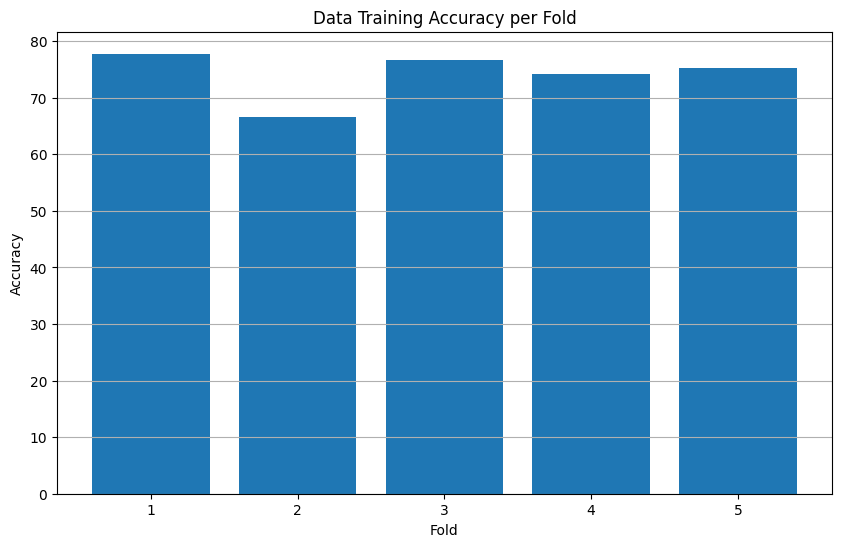

In [193]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

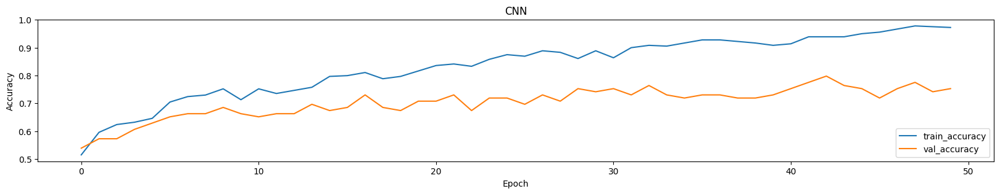

In [194]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(cnn)

In [195]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_cnn/model_cnn_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model1.h5')
    print(f'Model with the best accuracy saved as model1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 0.6339269876480103 - Accuracy: 75.89285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Model Evaluate Accuracy Score for fold 1: 75.89285714285714%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.84      0.69      0.76        62
           1       0.69      0.84      0.76        50

    accuracy                           0.76       112
   macro avg       0.77      0.77      0.76       112
weighted avg       0.77      0.76      0.76       112



Fold 2 - Loss: 0.7993602752685547 - Accuracy: 73.21428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Model Evaluate Accuracy Score for fold 2: 73.21428571428571%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.81      0.68      0.74        62
           1       0.67      0.80      0.73        50

    accuracy                           0.73       112
   macro avg       0.74      0.74      0.73       112
weighted avg       0.74      0.73      0.73       112



Fold 3 - Loss: 0.49130651354789734 - Accuracy: 83.03571343421936%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


Model Evaluate Accuracy Score for fold 3: 83.03571428571429%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.85      0.84      0.85        62
           1       0.80      0.82      0.81        50

    accuracy                           0.83       112
   macro avg       0.83      0.83      0.83       112
weighted avg       0.83      0.83      0.83       112

Fold 4 - Loss: 0.9713843464851379 - Accuracy: 74.10714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


Model Evaluate Accuracy Score for fold 4: 74.10714285714286%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.78      0.74      0.76        62
           1       0.70      0.74      0.72        50

    accuracy                           0.74       112
   macro avg       0.74      0.74      0.74       112
weighted avg       0.74      0.74      0.74       112

Fold 5 - Loss: 0.7050052285194397 - Accuracy: 70.53571343421936%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Model Evaluate Accuracy Score for fold 5: 70.53571428571429%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.81      0.61      0.70        62
           1       0.63      0.82      0.71        50

    accuracy                           0.71       112
   macro avg       0.72      0.72      0.71       112
weighted avg       0.73      0.71      0.70       112

---------------------------------------------------

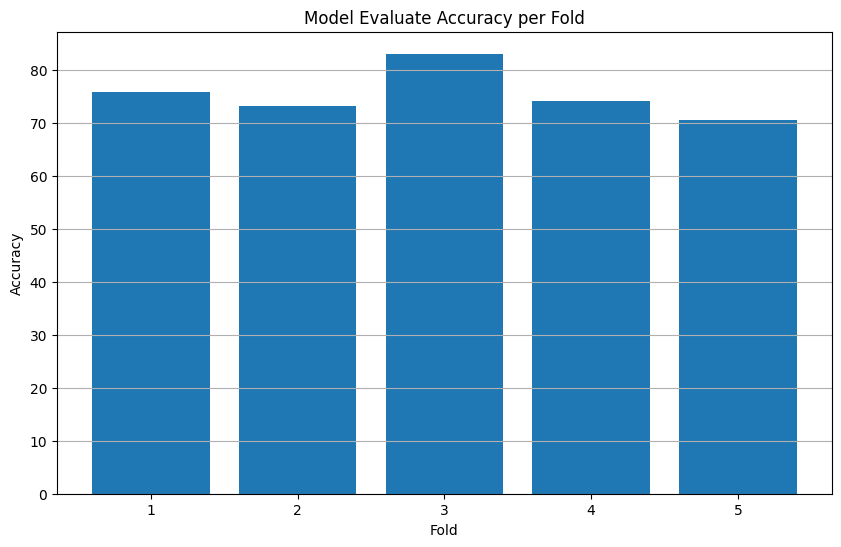

In [196]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

### LSTM

In [197]:
import tensorflow as tf

def create_lstm_model(input_shape, num_classes):
    model = tf.keras.Sequential([
        tf.keras.layers.LSTM(64, return_sequences=True, input_shape=input_shape),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.LSTM(64),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

model_lstm = create_lstm_model(input_shape, 2)

model_lstm.summary()

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 25, 64)         │        16,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 25, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 54,210 (211.76 KB)

 Trainable params: 54,210 (211.76 KB)

 Non-trainable params: 0 (0.00 B)

In [198]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_lstm', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_lstm = create_lstm_model(input_shape, 2)
    
    # Melatih model
    lstm = model_lstm.fit(X_train_fold, y_train_fold, batch_size=64, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_lstm.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_lstm.metrics_names[0]} of {scores[0]}; {model_lstm.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_lstm/model_lstm_fold_{fold_no}.h5'
    model_lstm.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


Fold 1
Epoch 1/50
6/6 - 5s - 766ms/step - accuracy: 0.4860 - loss: 0.6916 - val_accuracy: 0.4778 - val_loss: 0.6935
Epoch 2/50
6/6 - 0s - 52ms/step - accuracy: 0.5335 - loss: 0.6847 - val_accuracy: 0.4778 - val_loss: 0.6916
Epoch 3/50
6/6 - 0s - 55ms/step - accuracy: 0.5419 - loss: 0.6811 - val_accuracy: 0.4667 - val_loss: 0.6886
Epoch 4/50
6/6 - 0s - 48ms/step - accuracy: 0.5447 - loss: 0.6799 - val_accuracy: 0.5111 - val_loss: 0.6822
Epoch 5/50
6/6 - 0s - 47ms/step - accuracy: 0.5447 - loss: 0.6709 - val_accuracy: 0.5111 - val_loss: 0.6790
Epoch 6/50
6/6 - 0s - 51ms/step - accuracy: 0.5838 - loss: 0.6626 - val_accuracy: 0.5667 - val_loss: 0.6712
Epoch 7/50
6/6 - 0s - 44ms/step - accuracy: 0.6201 - loss: 0.6464 - val_accuracy: 0.5889 - val_loss: 0.6717
Epoch 8/50
6/6 - 0s - 46ms/step - accuracy: 0.6117 - loss: 0.6342 - val_accuracy: 0.5000 - val_loss: 0.6796
Epoch 9/50
6/6 - 0s - 46ms/step - accuracy: 0.6480 - loss: 0.6209 - val_accuracy: 0.5444 - val_loss: 0.6797
Epoch 10/50
6/6 - 0s

Score for fold 1: loss of 0.844590425491333; compile_metrics of 60.00000238418579%
Model for fold 1 saved as models_lstm/model_lstm_fold_1.h5
Fold 2
Epoch 1/50
6/6 - 7s - 1s/step - accuracy: 0.5335 - loss: 0.6909 - val_accuracy: 0.4889 - val_loss: 0.6949
Epoch 2/50
6/6 - 0s - 63ms/step - accuracy: 0.5251 - loss: 0.6852 - val_accuracy: 0.4889 - val_loss: 0.6951
Epoch 3/50
6/6 - 0s - 67ms/step - accuracy: 0.5615 - loss: 0.6808 - val_accuracy: 0.4889 - val_loss: 0.6992
Epoch 4/50
6/6 - 0s - 56ms/step - accuracy: 0.5475 - loss: 0.6742 - val_accuracy: 0.4778 - val_loss: 0.6873
Epoch 5/50
6/6 - 0s - 65ms/step - accuracy: 0.5559 - loss: 0.6654 - val_accuracy: 0.5000 - val_loss: 0.6777
Epoch 6/50
6/6 - 1s - 94ms/step - accuracy: 0.5754 - loss: 0.6567 - val_accuracy: 0.5333 - val_loss: 0.6610
Epoch 7/50
6/6 - 1s - 99ms/step - accuracy: 0.5838 - loss: 0.6492 - val_accuracy: 0.5889 - val_loss: 0.6452
Epoch 8/50
6/6 - 1s - 131ms/step - accuracy: 0.6285 - loss: 0.6397 - val_accuracy: 0.5778 - val_l

Score for fold 2: loss of 0.635536789894104; compile_metrics of 68.88889074325562%
Model for fold 2 saved as models_lstm/model_lstm_fold_2.h5
Fold 3
Epoch 1/50
6/6 - 6s - 985ms/step - accuracy: 0.5447 - loss: 0.6904 - val_accuracy: 0.5889 - val_loss: 0.6798
Epoch 2/50
6/6 - 0s - 42ms/step - accuracy: 0.5670 - loss: 0.6890 - val_accuracy: 0.6111 - val_loss: 0.6741
Epoch 3/50
6/6 - 0s - 39ms/step - accuracy: 0.5475 - loss: 0.6832 - val_accuracy: 0.5556 - val_loss: 0.6737
Epoch 4/50
6/6 - 0s - 39ms/step - accuracy: 0.5587 - loss: 0.6804 - val_accuracy: 0.5889 - val_loss: 0.6662
Epoch 5/50
6/6 - 0s - 41ms/step - accuracy: 0.5615 - loss: 0.6743 - val_accuracy: 0.5889 - val_loss: 0.6511
Epoch 6/50
6/6 - 0s - 49ms/step - accuracy: 0.5726 - loss: 0.6651 - val_accuracy: 0.6111 - val_loss: 0.6293
Epoch 7/50
6/6 - 0s - 54ms/step - accuracy: 0.5866 - loss: 0.6601 - val_accuracy: 0.6111 - val_loss: 0.6212
Epoch 8/50
6/6 - 0s - 45ms/step - accuracy: 0.6061 - loss: 0.6493 - val_accuracy: 0.6778 - val

Score for fold 3: loss of 0.7562291622161865; compile_metrics of 61.11111044883728%
Model for fold 3 saved as models_lstm/model_lstm_fold_3.h5
Fold 4
Epoch 1/50
6/6 - 4s - 630ms/step - accuracy: 0.5209 - loss: 0.6909 - val_accuracy: 0.5281 - val_loss: 0.6890
Epoch 2/50
6/6 - 0s - 33ms/step - accuracy: 0.5515 - loss: 0.6853 - val_accuracy: 0.5730 - val_loss: 0.6857
Epoch 3/50
6/6 - 0s - 31ms/step - accuracy: 0.5571 - loss: 0.6779 - val_accuracy: 0.5618 - val_loss: 0.6814
Epoch 4/50
6/6 - 0s - 31ms/step - accuracy: 0.5599 - loss: 0.6697 - val_accuracy: 0.5730 - val_loss: 0.6762
Epoch 5/50
6/6 - 0s - 32ms/step - accuracy: 0.5905 - loss: 0.6565 - val_accuracy: 0.5955 - val_loss: 0.6793
Epoch 6/50
6/6 - 0s - 32ms/step - accuracy: 0.5905 - loss: 0.6399 - val_accuracy: 0.5955 - val_loss: 0.6804
Epoch 7/50
6/6 - 0s - 31ms/step - accuracy: 0.6240 - loss: 0.6258 - val_accuracy: 0.6292 - val_loss: 0.6876
Epoch 8/50
6/6 - 0s - 32ms/step - accuracy: 0.6490 - loss: 0.6144 - val_accuracy: 0.6292 - va

Score for fold 4: loss of 0.9329528212547302; compile_metrics of 53.93258333206177%
Model for fold 4 saved as models_lstm/model_lstm_fold_4.h5
Fold 5
Epoch 1/50
6/6 - 4s - 675ms/step - accuracy: 0.4930 - loss: 0.6915 - val_accuracy: 0.5843 - val_loss: 0.6855
Epoch 2/50
6/6 - 0s - 28ms/step - accuracy: 0.5655 - loss: 0.6867 - val_accuracy: 0.4944 - val_loss: 0.6809
Epoch 3/50
6/6 - 0s - 34ms/step - accuracy: 0.5543 - loss: 0.6799 - val_accuracy: 0.4831 - val_loss: 0.6756
Epoch 4/50
6/6 - 0s - 33ms/step - accuracy: 0.5766 - loss: 0.6727 - val_accuracy: 0.5056 - val_loss: 0.6668
Epoch 5/50
6/6 - 0s - 33ms/step - accuracy: 0.5850 - loss: 0.6648 - val_accuracy: 0.5056 - val_loss: 0.6628
Epoch 6/50
6/6 - 0s - 34ms/step - accuracy: 0.6017 - loss: 0.6525 - val_accuracy: 0.5169 - val_loss: 0.6523
Epoch 7/50
6/6 - 0s - 34ms/step - accuracy: 0.6323 - loss: 0.6438 - val_accuracy: 0.5843 - val_loss: 0.6604
Epoch 8/50
6/6 - 0s - 36ms/step - accuracy: 0.6156 - loss: 0.6318 - val_accuracy: 0.6180 - va

Score for fold 5: loss of 0.5996406078338623; compile_metrics of 68.53932738304138%
Model for fold 5 saved as models_lstm/model_lstm_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.844590425491333 - Accuracy: 60.00000238418579%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.635536789894104 - Accuracy: 68.88889074325562%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.7562291622161865 - Accuracy: 61.11111044883728%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.9329528212547302 - Accuracy: 53.93258333206177%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.5996406078338623 - Accuracy: 68.53932738304138%
-----------------------------------------------------------------------

In [199]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 60.00000238418579%
Fold 2: 68.88889074325562%
Fold 3: 61.11111044883728%
Fold 4: 53.93258333206177%
Fold 5: 68.53932738304138%


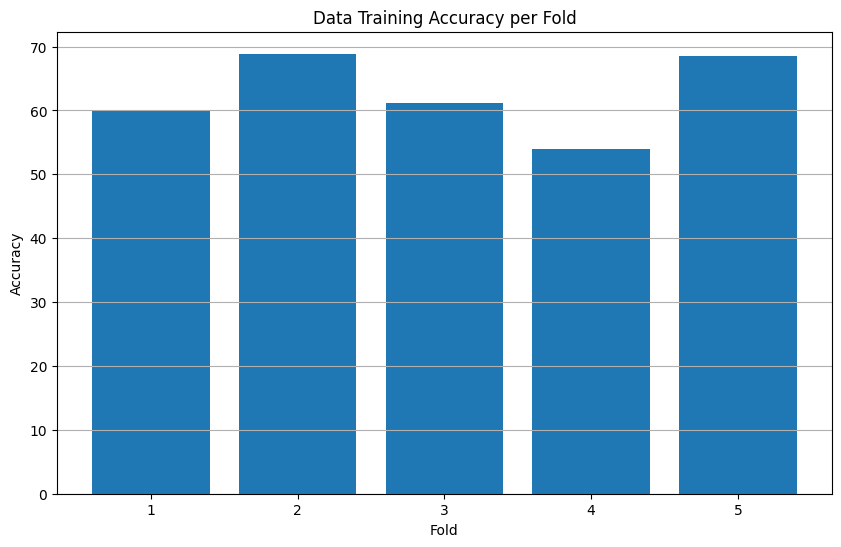

In [200]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

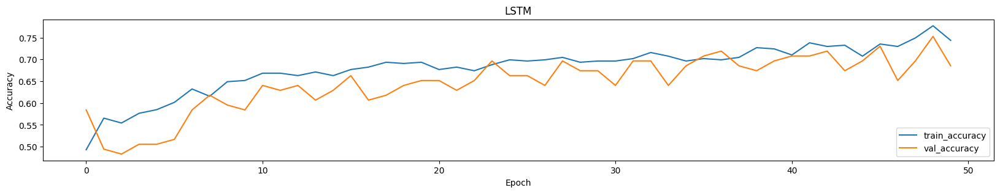

In [201]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('LSTM')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(lstm)

In [202]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_lstm/model_lstm_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'model2.h5')
    print(f'Model with the best accuracy saved as model2.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 0.8777175545692444 - Accuracy: 58.92857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 169ms/step
Model Evaluate Accuracy Score for fold 1: 58.92857142857143%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.62      0.66      0.64        62
           1       0.54      0.50      0.52        50

    accuracy                           0.59       112
   macro avg       0.58      0.58      0.58       112
weighted avg       0.59      0.59      0.59       112



Fold 2 - Loss: 0.7381975054740906 - Accuracy: 63.39285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step


Model Evaluate Accuracy Score for fold 2: 63.39285714285714%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.71      0.58      0.64        62
           1       0.57      0.70      0.63        50

    accuracy                           0.63       112
   macro avg       0.64      0.64      0.63       112
weighted avg       0.65      0.63      0.63       112

Fold 3 - Loss: 0.8124303817749023 - Accuracy: 61.60714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 99ms/step


Model Evaluate Accuracy Score for fold 3: 61.60714285714286%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.65      0.68      0.66        62
           1       0.57      0.54      0.56        50

    accuracy                           0.62       112
   macro avg       0.61      0.61      0.61       112
weighted avg       0.61      0.62      0.61       112

Fold 4 - Loss: 0.9084777235984802 - Accuracy: 55.35714030265808%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step


Model Evaluate Accuracy Score for fold 4: 55.35714285714286%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.60      0.60      0.60        62
           1       0.50      0.50      0.50        50

    accuracy                           0.55       112
   macro avg       0.55      0.55      0.55       112
weighted avg       0.55      0.55      0.55       112

Fold 5 - Loss: 0.9445514678955078 - Accuracy: 50.0%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step
Model Evaluate Accuracy Score for fold 5: 50.0%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.56      0.47      0.51        62
           1       0.45      0.54      0.49        50

    accuracy                           0.50       112
   macro avg       0.50      0.50      0.50       112
weighted avg       0.51      0.50      0.50       112

------------------------------------------------------------------------
Sco

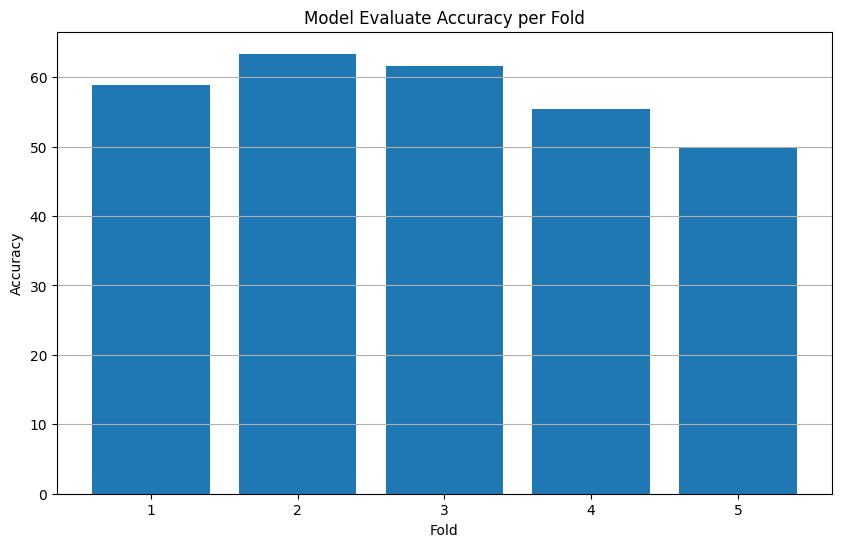

In [203]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

## Tuning

### CNN

In [204]:
from scikeras.wrappers import KerasClassifier

model = KerasClassifier(build_fn=create_cnn_model, input_shape=input_shape, num_classes=2, verbose=2)

In [205]:
param_grid = {
    'batch_size': [32, 64, 128],
    'epochs': [10, 50, 100]
}

In [206]:
from sklearn.model_selection import GridSearchCV

grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1)
grid_result = grid.fit(X_train, y_train)

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\scikeras\wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
14/14 - 4s - 279ms/step - accuracy: 0.5446 - loss: 0.6901
Epoch 2/50
14/14 - 0s - 13ms/step - accuracy: 0.6116 - loss: 0.6480
Epoch 3/50
14/14 - 0s - 14ms/step - accuracy: 0.6384 - loss: 0.6102
Epoch 4/50
14/14 - 0s - 7ms/step - accuracy: 0.6719 - loss: 0.5820
Epoch 5/50
14/14 - 0s - 7ms/step - accuracy: 0.7121 - loss: 0.5484
Epoch 6/50
14/14 - 0s - 6ms/step - accuracy: 0.7388 - loss: 0.5107
Epoch 7/50
14/14 - 0s - 6ms/step - accuracy: 0.7478 - loss: 0.4837
Epoch 8/50
14/14 - 0s - 6ms/step - accuracy: 0.7031 - loss: 0.5372
Epoch 9/50
14/14 - 0s - 6ms/step - accuracy: 0.7746 - loss: 0.4600
Epoch 10/50
14/14 - 0s - 6ms/step - accuracy: 0.8013 - loss: 0.4326
Epoch 11/50
14/14 - 0s - 6ms/step - accuracy: 0.8170 - loss: 0.4290
Epoch 12/50
14/14 - 0s - 10ms/step - accuracy: 0.8013 - loss: 0.4322
Epoch 13/50
14/14 - 0s - 7ms/step - accuracy: 0.8192 - loss: 0.3891
Epoch 14/50
14/14 - 0s - 6ms/step - accuracy: 0.8036 - loss: 0.4107
Epoch 15/50
14/14 - 0s - 5ms/step - accuracy: 0.8504

In [208]:
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, std, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, std, param))

Best: 0.756554 using {'batch_size': 32, 'epochs': 50}
0.674132 (0.030864) with: {'batch_size': 32, 'epochs': 10}
0.756554 (0.029763) with: {'batch_size': 32, 'epochs': 50}
0.754282 (0.037971) with: {'batch_size': 32, 'epochs': 100}
0.673983 (0.033781) with: {'batch_size': 64, 'epochs': 10}
0.729938 (0.029079) with: {'batch_size': 64, 'epochs': 50}
0.740899 (0.051385) with: {'batch_size': 64, 'epochs': 100}
0.636330 (0.039949) with: {'batch_size': 128, 'epochs': 10}
0.754407 (0.037553) with: {'batch_size': 128, 'epochs': 50}
0.750012 (0.017956) with: {'batch_size': 128, 'epochs': 100}


In [209]:
best_params=grid_result.best_params_ 
accuracy=grid_result.best_score_ 

print(best_params)
print(accuracy)

{'batch_size': 32, 'epochs': 50}
0.7565543071161048


In [211]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_cnn_tuning', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_cnn = create_cnn_model(input_shape, 2)
    
    # Melatih model
    cnn = model_cnn.fit(X_train_fold, y_train_fold, batch_size=32, epochs=50, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_cnn.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_cnn.metrics_names[0]} of {scores[0]}; {model_cnn.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_cnn_tuning/model_cnn_tuning_fold_{fold_no}.h5'
    model_cnn.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

Fold 1
Epoch 1/50
12/12 - 2s - 194ms/step - accuracy: 0.5475 - loss: 0.6819 - val_accuracy: 0.5222 - val_loss: 0.6637
Epoch 2/50
12/12 - 0s - 11ms/step - accuracy: 0.6229 - loss: 0.6365 - val_accuracy: 0.6556 - val_loss: 0.6292
Epoch 3/50
12/12 - 0s - 11ms/step - accuracy: 0.6648 - loss: 0.5940 - val_accuracy: 0.6222 - val_loss: 0.6336
Epoch 4/50
12/12 - 0s - 10ms/step - accuracy: 0.6648 - loss: 0.5896 - val_accuracy: 0.7556 - val_loss: 0.5648
Epoch 5/50
12/12 - 0s - 11ms/step - accuracy: 0.7067 - loss: 0.5455 - val_accuracy: 0.7778 - val_loss: 0.5437
Epoch 6/50
12/12 - 0s - 11ms/step - accuracy: 0.6955 - loss: 0.5538 - val_accuracy: 0.6444 - val_loss: 0.5883
Epoch 7/50
12/12 - 0s - 11ms/step - accuracy: 0.6844 - loss: 0.5495 - val_accuracy: 0.7222 - val_loss: 0.5629
Epoch 8/50
12/12 - 0s - 10ms/step - accuracy: 0.7598 - loss: 0.5089 - val_accuracy: 0.7444 - val_loss: 0.5625
Epoch 9/50
12/12 - 0s - 9ms/step - accuracy: 0.7654 - loss: 0.4796 - val_accuracy: 0.7111 - val_loss: 0.5806
Epo

Score for fold 1: loss of 1.3096258640289307; compile_metrics of 75.55555701255798%
Model for fold 1 saved as models_cnn_tuning/model_cnn_tuning_fold_1.h5
Fold 2
Epoch 1/50
12/12 - 2s - 191ms/step - accuracy: 0.5531 - loss: 0.6755 - val_accuracy: 0.6333 - val_loss: 0.6701
Epoch 2/50
12/12 - 0s - 11ms/step - accuracy: 0.6313 - loss: 0.6309 - val_accuracy: 0.5333 - val_loss: 0.6676
Epoch 3/50
12/12 - 0s - 10ms/step - accuracy: 0.6453 - loss: 0.6067 - val_accuracy: 0.5222 - val_loss: 0.6550
Epoch 4/50
12/12 - 0s - 9ms/step - accuracy: 0.6872 - loss: 0.5594 - val_accuracy: 0.6222 - val_loss: 0.6019
Epoch 5/50
12/12 - 0s - 10ms/step - accuracy: 0.7458 - loss: 0.5273 - val_accuracy: 0.5333 - val_loss: 0.7902
Epoch 6/50
12/12 - 0s - 10ms/step - accuracy: 0.7123 - loss: 0.5591 - val_accuracy: 0.6444 - val_loss: 0.5801
Epoch 7/50
12/12 - 0s - 10ms/step - accuracy: 0.7011 - loss: 0.5415 - val_accuracy: 0.6778 - val_loss: 0.5586
Epoch 8/50
12/12 - 0s - 14ms/step - accuracy: 0.7374 - loss: 0.5084 

Score for fold 2: loss of 1.371309518814087; compile_metrics of 75.55555701255798%
Model for fold 2 saved as models_cnn_tuning/model_cnn_tuning_fold_2.h5
Fold 3
Epoch 1/50
12/12 - 3s - 212ms/step - accuracy: 0.5698 - loss: 0.6809 - val_accuracy: 0.6667 - val_loss: 0.6615
Epoch 2/50
12/12 - 0s - 14ms/step - accuracy: 0.6564 - loss: 0.6435 - val_accuracy: 0.6222 - val_loss: 0.6474
Epoch 3/50
12/12 - 0s - 13ms/step - accuracy: 0.6704 - loss: 0.6078 - val_accuracy: 0.6889 - val_loss: 0.6113
Epoch 4/50
12/12 - 0s - 12ms/step - accuracy: 0.6732 - loss: 0.5780 - val_accuracy: 0.6111 - val_loss: 0.5954
Epoch 5/50
12/12 - 0s - 13ms/step - accuracy: 0.7235 - loss: 0.5439 - val_accuracy: 0.6556 - val_loss: 0.6033
Epoch 6/50
12/12 - 0s - 10ms/step - accuracy: 0.7430 - loss: 0.4982 - val_accuracy: 0.6111 - val_loss: 0.6289
Epoch 7/50
12/12 - 0s - 12ms/step - accuracy: 0.7737 - loss: 0.4840 - val_accuracy: 0.6444 - val_loss: 0.6044
Epoch 8/50
12/12 - 0s - 12ms/step - accuracy: 0.7346 - loss: 0.5018 

Score for fold 3: loss of 1.1213467121124268; compile_metrics of 75.55555701255798%
Model for fold 3 saved as models_cnn_tuning/model_cnn_tuning_fold_3.h5
Fold 4
Epoch 1/50
12/12 - 2s - 164ms/step - accuracy: 0.5292 - loss: 0.6844 - val_accuracy: 0.5955 - val_loss: 0.6730
Epoch 2/50
12/12 - 0s - 12ms/step - accuracy: 0.6351 - loss: 0.6432 - val_accuracy: 0.6517 - val_loss: 0.6472
Epoch 3/50
12/12 - 0s - 11ms/step - accuracy: 0.6240 - loss: 0.6154 - val_accuracy: 0.6517 - val_loss: 0.6133
Epoch 4/50
12/12 - 0s - 12ms/step - accuracy: 0.6741 - loss: 0.5922 - val_accuracy: 0.6854 - val_loss: 0.5944
Epoch 5/50
12/12 - 0s - 12ms/step - accuracy: 0.7214 - loss: 0.5698 - val_accuracy: 0.6292 - val_loss: 0.6042
Epoch 6/50
12/12 - 0s - 13ms/step - accuracy: 0.6936 - loss: 0.5690 - val_accuracy: 0.7079 - val_loss: 0.5772
Epoch 7/50
12/12 - 0s - 13ms/step - accuracy: 0.7549 - loss: 0.5217 - val_accuracy: 0.7303 - val_loss: 0.5962
Epoch 8/50
12/12 - 0s - 11ms/step - accuracy: 0.7019 - loss: 0.5289

Score for fold 4: loss of 1.272355556488037; compile_metrics of 75.28089880943298%
Model for fold 4 saved as models_cnn_tuning/model_cnn_tuning_fold_4.h5
Fold 5
Epoch 1/50
12/12 - 2s - 180ms/step - accuracy: 0.5599 - loss: 0.6859 - val_accuracy: 0.5618 - val_loss: 0.6640
Epoch 2/50
12/12 - 0s - 9ms/step - accuracy: 0.6490 - loss: 0.6409 - val_accuracy: 0.5955 - val_loss: 0.6284
Epoch 3/50
12/12 - 0s - 10ms/step - accuracy: 0.6685 - loss: 0.5945 - val_accuracy: 0.5955 - val_loss: 0.6163
Epoch 4/50
12/12 - 0s - 9ms/step - accuracy: 0.7047 - loss: 0.5604 - val_accuracy: 0.6180 - val_loss: 0.6152
Epoch 5/50
12/12 - 0s - 10ms/step - accuracy: 0.6462 - loss: 0.5800 - val_accuracy: 0.6742 - val_loss: 0.5959
Epoch 6/50
12/12 - 0s - 14ms/step - accuracy: 0.7382 - loss: 0.5273 - val_accuracy: 0.6854 - val_loss: 0.5859
Epoch 7/50
12/12 - 0s - 10ms/step - accuracy: 0.7521 - loss: 0.5004 - val_accuracy: 0.6067 - val_loss: 0.6332
Epoch 8/50
12/12 - 0s - 9ms/step - accuracy: 0.7549 - loss: 0.4853 - v

Score for fold 5: loss of 1.3777904510498047; compile_metrics of 73.03370833396912%
Model for fold 5 saved as models_cnn_tuning/model_cnn_tuning_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 1.3096258640289307 - Accuracy: 75.55555701255798%
------------------------------------------------------------------------
> Fold 2 - Loss: 1.371309518814087 - Accuracy: 75.55555701255798%
------------------------------------------------------------------------
> Fold 3 - Loss: 1.1213467121124268 - Accuracy: 75.55555701255798%
------------------------------------------------------------------------
> Fold 4 - Loss: 1.272355556488037 - Accuracy: 75.28089880943298%
------------------------------------------------------------------------
> Fold 5 - Loss: 1.3777904510498047 - Accuracy: 73.03370833396912%
-----------------------------------------------------------

In [212]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 75.55555701255798%
Fold 2: 75.55555701255798%
Fold 3: 75.55555701255798%
Fold 4: 75.28089880943298%
Fold 5: 73.03370833396912%


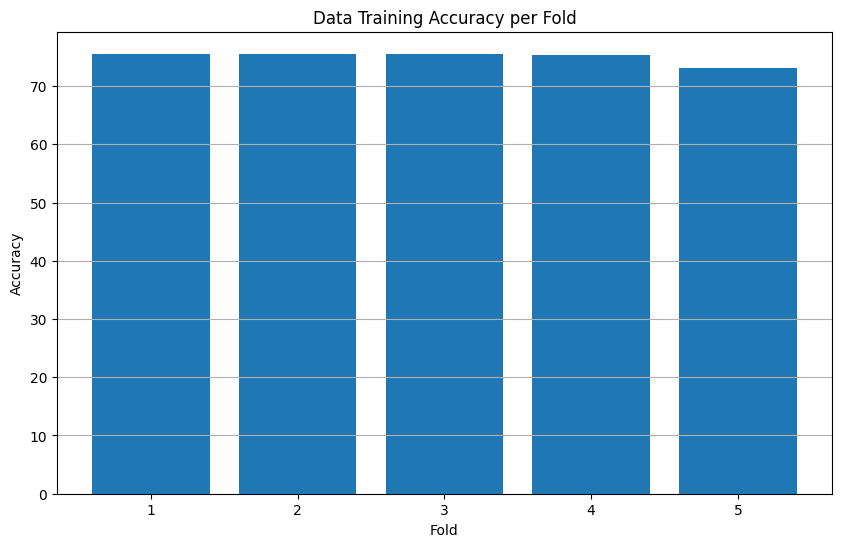

In [213]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

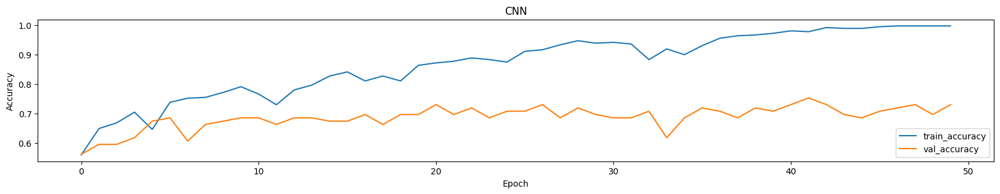

In [214]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('CNN')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(cnn)

In [215]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_cnn_tuning/model_cnn_tuning_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'modelTuning1.h5')
    print(f'Model with the best accuracy saved as modelTuning1.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 0.8965309858322144 - Accuracy: 75.0%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Model Evaluate Accuracy Score for fold 1: 75.0%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.80      0.73      0.76        62
           1       0.70      0.78      0.74        50

    accuracy                           0.75       112
   macro avg       0.75      0.75      0.75       112
weighted avg       0.76      0.75      0.75       112



Fold 2 - Loss: 1.2764670848846436 - Accuracy: 72.32142686843872%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Model Evaluate Accuracy Score for fold 2: 72.32142857142857%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.78      0.69      0.74        62
           1       0.67      0.76      0.71        50

    accuracy                           0.72       112
   macro avg       0.72      0.73      0.72       112
weighted avg       0.73      0.72      0.72       112



Fold 3 - Loss: 0.8032349944114685 - Accuracy: 77.67857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Model Evaluate Accuracy Score for fold 3: 77.67857142857143%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.82      0.76      0.79        62
           1       0.73      0.80      0.76        50

    accuracy                           0.78       112
   macro avg       0.78      0.78      0.78       112
weighted avg       0.78      0.78      0.78       112



Fold 4 - Loss: 1.2937222719192505 - Accuracy: 77.67857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Model Evaluate Accuracy Score for fold 4: 77.67857142857143%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.79      0.81      0.80        62
           1       0.76      0.74      0.75        50

    accuracy                           0.78       112
   macro avg       0.77      0.77      0.77       112
weighted avg       0.78      0.78      0.78       112



Fold 5 - Loss: 0.9101012945175171 - Accuracy: 75.0%
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Model Evaluate Accuracy Score for fold 5: 75.0%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.81      0.71      0.76        62
           1       0.69      0.80      0.74        50

    accuracy                           0.75       112
   macro avg       0.75      0.75      0.75       112
weighted avg       0.76      0.75      0.75       112

------------------------------------------------------------------------
Score per fold
> Fold 1 - Loss: 0.8965309858322144 - Accuracy: 75.0%
> Fold 2 - Loss: 1.2764670848846436 - Accuracy: 72.32142686843872%
> Fold 3 - Loss: 0.8032349944114685 - Accuracy: 77.67857313156128%
> Fold 4 - Loss: 1.2937222719192505 - Accuracy: 77.67857313156128%
> Fold 5 - Loss: 0.9101012945175171 - Accuracy: 75.0%
------------------------------------------------------------------------
Average scores for all folds:


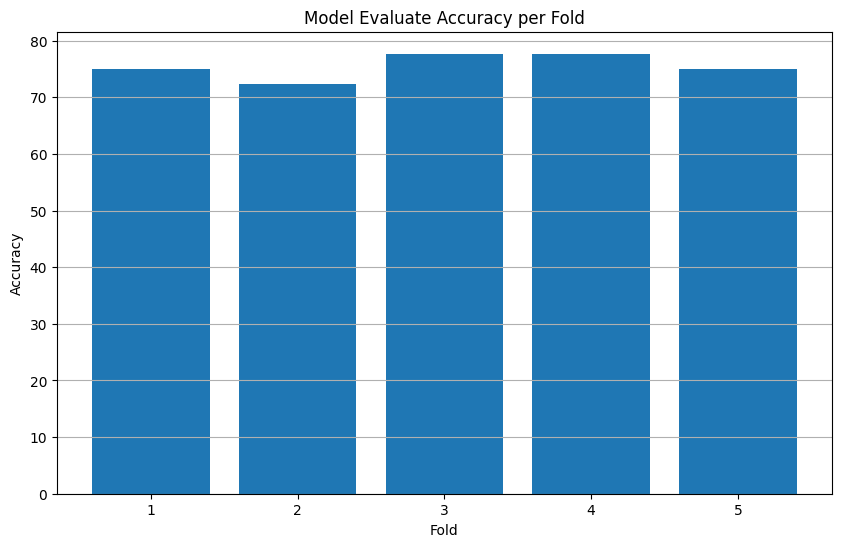

In [216]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

### LSTM

In [217]:
model2 = KerasClassifier(build_fn=create_lstm_model, input_shape=input_shape, num_classes=2, verbose=2)

In [218]:
grid2 = GridSearchCV(estimator=model2, param_grid=param_grid, n_jobs=-1)
grid_result2 = grid2.fit(X_train, y_train)

C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\scikeras\wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
C:\Users\asus\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
14/14 - 7s - 483ms/step - accuracy: 0.5134 - loss: 0.6901
Epoch 2/100
14/14 - 0s - 25ms/step - accuracy: 0.5335 - loss: 0.6826
Epoch 3/100
14/14 - 0s - 22ms/step - accuracy: 0.5647 - loss: 0.6744
Epoch 4/100
14/14 - 0s - 22ms/step - accuracy: 0.5938 - loss: 0.6560
Epoch 5/100
14/14 - 0s - 22ms/step - accuracy: 0.6250 - loss: 0.6458
Epoch 6/100
14/14 - 0s - 22ms/step - accuracy: 0.6138 - loss: 0.6302
Epoch 7/100
14/14 - 0s - 22ms/step - accuracy: 0.6429 - loss: 0.6178
Epoch 8/100
14/14 - 0s - 23ms/step - accuracy: 0.6295 - loss: 0.6308
Epoch 9/100
14/14 - 0s - 21ms/step - accuracy: 0.6652 - loss: 0.5992
Epoch 10/100
14/14 - 0s - 18ms/step - accuracy: 0.6496 - loss: 0.6014
Epoch 11/100
14/14 - 0s - 16ms/step - accuracy: 0.6719 - loss: 0.5835
Epoch 12/100
14/14 - 0s - 17ms/step - accuracy: 0.6562 - loss: 0.5788
Epoch 13/100
14/14 - 0s - 21ms/step - accuracy: 0.6674 - loss: 0.5897
Epoch 14/100
14/14 - 0s - 20ms/step - accuracy: 0.6853 - loss: 0.5663
Epoch 15/100
14/14 - 0s - 22

In [219]:
print("Best: %f using %s" % (grid_result2.best_score_, grid_result2.best_params_))
means = grid_result2.cv_results_['mean_test_score']
stds = grid_result2.cv_results_['std_test_score']
params = grid_result2.cv_results_['params']
for mean, std, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, std, param))

Best: 0.665194 using {'batch_size': 32, 'epochs': 100}
0.593758 (0.012952) with: {'batch_size': 32, 'epochs': 10}
0.651860 (0.036162) with: {'batch_size': 32, 'epochs': 50}
0.665194 (0.042752) with: {'batch_size': 32, 'epochs': 100}
0.584719 (0.021217) with: {'batch_size': 64, 'epochs': 10}
0.629488 (0.018558) with: {'batch_size': 64, 'epochs': 50}
0.649488 (0.034968) with: {'batch_size': 64, 'epochs': 100}
0.569313 (0.034994) with: {'batch_size': 128, 'epochs': 10}
0.634057 (0.031897) with: {'batch_size': 128, 'epochs': 50}
0.624944 (0.030360) with: {'batch_size': 128, 'epochs': 100}


In [220]:
best_params2=grid_result2.best_params_ 
accuracy2=grid_result2.best_score_ 

print(best_params2)
print(accuracy2)

{'batch_size': 32, 'epochs': 100}
0.6651935081148563


In [221]:
from sklearn.model_selection import KFold
import numpy as np
import os

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Menyimpan hasil setiap fold
fold_no = 1
accuracy_per_fold = []
loss_per_fold = []

# Membuat direktori untuk menyimpan model jika belum ada
os.makedirs('models_lstm_tuning', exist_ok=True)

for train_index, val_index in kf.split(X_train):
    print(f'Fold {fold_no}')
    
    # Membagi data
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Membuat model baru
    model_lstm = create_lstm_model(input_shape, 2)
    
    # Melatih model
    lstm = model_lstm.fit(X_train_fold, y_train_fold, batch_size=32, epochs=100, validation_data=(X_val_fold, y_val_fold), verbose=2)
    
    # Evaluasi model pada data validasi fold
    scores = model_lstm.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f'Score for fold {fold_no}: {model_lstm.metrics_names[0]} of {scores[0]}; {model_lstm.metrics_names[1]} of {scores[1]*100}%')
    accuracy_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    
    # Simpan model
    model_filename = f'models_lstm_tuning/model_lstm_tuning_fold_{fold_no}.h5'
    model_lstm.save(model_filename)
    print(f'Model for fold {fold_no} saved as {model_filename}')
    
    fold_no += 1

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

Fold 1
Epoch 1/100
12/12 - 6s - 494ms/step - accuracy: 0.4637 - loss: 0.6943 - val_accuracy: 0.4778 - val_loss: 0.6913
Epoch 2/100
12/12 - 1s - 43ms/step - accuracy: 0.5531 - loss: 0.6844 - val_accuracy: 0.4556 - val_loss: 0.6909
Epoch 3/100
12/12 - 1s - 46ms/step - accuracy: 0.5642 - loss: 0.6791 - val_accuracy: 0.4556 - val_loss: 0.6919
Epoch 4/100
12/12 - 1s - 47ms/step - accuracy: 0.5559 - loss: 0.6668 - val_accuracy: 0.4889 - val_loss: 0.6883
Epoch 5/100
12/12 - 0s - 36ms/step - accuracy: 0.6061 - loss: 0.6488 - val_accuracy: 0.5778 - val_loss: 0.6759
Epoch 6/100
12/12 - 0s - 28ms/step - accuracy: 0.6257 - loss: 0.6382 - val_accuracy: 0.6000 - val_loss: 0.6754
Epoch 7/100
12/12 - 0s - 33ms/step - accuracy: 0.6341 - loss: 0.6210 - val_accuracy: 0.5667 - val_loss: 0.6539
Epoch 8/100
12/12 - 0s - 30ms/step - accuracy: 0.6536 - loss: 0.6126 - val_accuracy: 0.5889 - val_loss: 0.6479
Epoch 9/100
12/12 - 0s - 29ms/step - accuracy: 0.6229 - loss: 0.6136 - val_accuracy: 0.5111 - val_loss: 

Score for fold 1: loss of 1.0479193925857544; compile_metrics of 61.11111044883728%
Model for fold 1 saved as models_lstm_tuning/model_lstm_tuning_fold_1.h5
Fold 2
Epoch 1/100
12/12 - 5s - 398ms/step - accuracy: 0.5223 - loss: 0.6917 - val_accuracy: 0.4667 - val_loss: 0.6931
Epoch 2/100
12/12 - 0s - 25ms/step - accuracy: 0.5475 - loss: 0.6815 - val_accuracy: 0.4667 - val_loss: 0.6951
Epoch 3/100
12/12 - 0s - 27ms/step - accuracy: 0.5363 - loss: 0.6777 - val_accuracy: 0.4889 - val_loss: 0.6969
Epoch 4/100
12/12 - 0s - 24ms/step - accuracy: 0.5642 - loss: 0.6690 - val_accuracy: 0.5444 - val_loss: 0.6753
Epoch 5/100
12/12 - 0s - 24ms/step - accuracy: 0.5978 - loss: 0.6502 - val_accuracy: 0.5667 - val_loss: 0.6562
Epoch 6/100
12/12 - 0s - 24ms/step - accuracy: 0.6145 - loss: 0.6425 - val_accuracy: 0.6111 - val_loss: 0.6485
Epoch 7/100
12/12 - 0s - 34ms/step - accuracy: 0.6592 - loss: 0.6246 - val_accuracy: 0.6000 - val_loss: 0.6378
Epoch 8/100
12/12 - 0s - 26ms/step - accuracy: 0.6676 - lo

Score for fold 2: loss of 1.0626691579818726; compile_metrics of 66.66666865348816%
Model for fold 2 saved as models_lstm_tuning/model_lstm_tuning_fold_2.h5
Fold 3
Epoch 1/100
12/12 - 17s - 1s/step - accuracy: 0.5447 - loss: 0.6911 - val_accuracy: 0.5778 - val_loss: 0.6840
Epoch 2/100
12/12 - 0s - 28ms/step - accuracy: 0.5615 - loss: 0.6850 - val_accuracy: 0.6000 - val_loss: 0.6685
Epoch 3/100
12/12 - 0s - 34ms/step - accuracy: 0.5475 - loss: 0.6824 - val_accuracy: 0.5778 - val_loss: 0.6598
Epoch 4/100
12/12 - 0s - 28ms/step - accuracy: 0.5782 - loss: 0.6769 - val_accuracy: 0.6333 - val_loss: 0.6545
Epoch 5/100
12/12 - 0s - 25ms/step - accuracy: 0.5950 - loss: 0.6682 - val_accuracy: 0.6222 - val_loss: 0.6334
Epoch 6/100
12/12 - 0s - 28ms/step - accuracy: 0.5978 - loss: 0.6588 - val_accuracy: 0.6000 - val_loss: 0.6185
Epoch 7/100
12/12 - 0s - 27ms/step - accuracy: 0.6145 - loss: 0.6431 - val_accuracy: 0.6889 - val_loss: 0.6081
Epoch 8/100
12/12 - 0s - 28ms/step - accuracy: 0.6313 - loss

Score for fold 3: loss of 0.9170703291893005; compile_metrics of 63.333332538604736%
Model for fold 3 saved as models_lstm_tuning/model_lstm_tuning_fold_3.h5
Fold 4
Epoch 1/100
12/12 - 5s - 383ms/step - accuracy: 0.5237 - loss: 0.6916 - val_accuracy: 0.5169 - val_loss: 0.6905
Epoch 2/100
12/12 - 0s - 29ms/step - accuracy: 0.5599 - loss: 0.6845 - val_accuracy: 0.5169 - val_loss: 0.6853
Epoch 3/100
12/12 - 0s - 27ms/step - accuracy: 0.5571 - loss: 0.6740 - val_accuracy: 0.5618 - val_loss: 0.6774
Epoch 4/100
12/12 - 0s - 29ms/step - accuracy: 0.5822 - loss: 0.6604 - val_accuracy: 0.6067 - val_loss: 0.6727
Epoch 5/100
12/12 - 0s - 31ms/step - accuracy: 0.6184 - loss: 0.6422 - val_accuracy: 0.6517 - val_loss: 0.6782
Epoch 6/100
12/12 - 0s - 38ms/step - accuracy: 0.6490 - loss: 0.6197 - val_accuracy: 0.5618 - val_loss: 0.7039
Epoch 7/100
12/12 - 0s - 37ms/step - accuracy: 0.6462 - loss: 0.6228 - val_accuracy: 0.5506 - val_loss: 0.7068
Epoch 8/100
12/12 - 0s - 40ms/step - accuracy: 0.6490 - l

Score for fold 4: loss of 1.8560755252838135; compile_metrics of 58.4269642829895%
Model for fold 4 saved as models_lstm_tuning/model_lstm_tuning_fold_4.h5
Fold 5
Epoch 1/100
12/12 - 4s - 355ms/step - accuracy: 0.5097 - loss: 0.6916 - val_accuracy: 0.4719 - val_loss: 0.6851
Epoch 2/100
12/12 - 0s - 30ms/step - accuracy: 0.5543 - loss: 0.6848 - val_accuracy: 0.4494 - val_loss: 0.6830
Epoch 3/100
12/12 - 0s - 42ms/step - accuracy: 0.5738 - loss: 0.6752 - val_accuracy: 0.4944 - val_loss: 0.6689
Epoch 4/100
12/12 - 0s - 40ms/step - accuracy: 0.5682 - loss: 0.6691 - val_accuracy: 0.5281 - val_loss: 0.6576
Epoch 5/100
12/12 - 0s - 36ms/step - accuracy: 0.5933 - loss: 0.6499 - val_accuracy: 0.5506 - val_loss: 0.6517
Epoch 6/100
12/12 - 1s - 42ms/step - accuracy: 0.6128 - loss: 0.6471 - val_accuracy: 0.5730 - val_loss: 0.6536
Epoch 7/100
12/12 - 0s - 29ms/step - accuracy: 0.6351 - loss: 0.6394 - val_accuracy: 0.6517 - val_loss: 0.6678
Epoch 8/100
12/12 - 0s - 31ms/step - accuracy: 0.6379 - los

Score for fold 5: loss of 0.68873131275177; compile_metrics of 65.16854166984558%
Model for fold 5 saved as models_lstm_tuning/model_lstm_tuning_fold_5.h5
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 1.0479193925857544 - Accuracy: 61.11111044883728%
------------------------------------------------------------------------
> Fold 2 - Loss: 1.0626691579818726 - Accuracy: 66.66666865348816%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.9170703291893005 - Accuracy: 63.333332538604736%
------------------------------------------------------------------------
> Fold 4 - Loss: 1.8560755252838135 - Accuracy: 58.4269642829895%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.68873131275177 - Accuracy: 65.16854166984558%
-----------------------------------------------------------

In [222]:
# Menampilkan akurasi per fold
print('Data Training Accuracy per fold:')
for i in range(len(accuracy_per_fold)):
    print(f'Fold {i+1}: {accuracy_per_fold[i]}%')

Data Training Accuracy per fold:
Fold 1: 61.11111044883728%
Fold 2: 66.66666865348816%
Fold 3: 63.333332538604736%
Fold 4: 58.4269642829895%
Fold 5: 65.16854166984558%


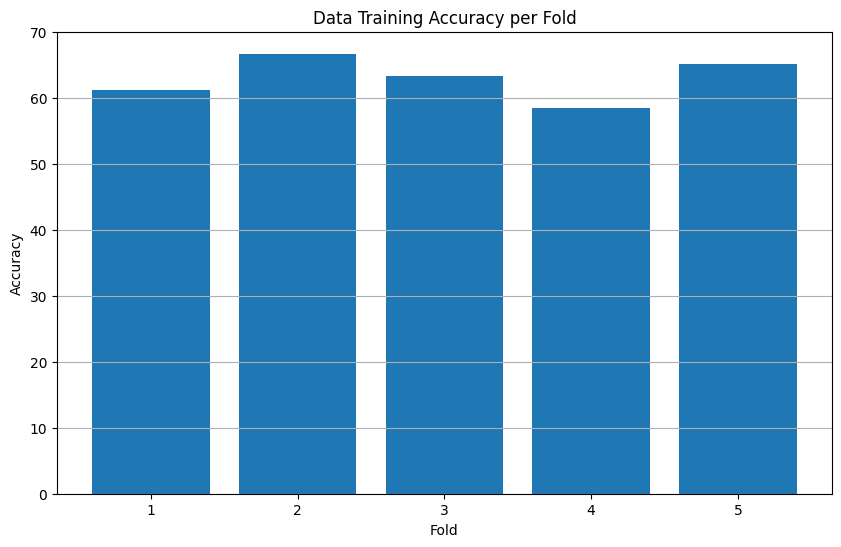

In [223]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Data Training Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()

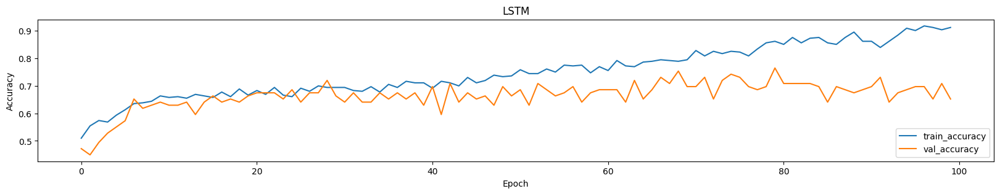

In [224]:
import matplotlib.pyplot as plt

def plot_learning_curves(history):
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.title('LSTM')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.show()

# Gunakan fungsi plot_learning_curves dengan parameter objek history dari model.fit
plot_learning_curves(lstm)

In [225]:
import numpy as np
from keras.models import load_model
from sklearn.metrics import accuracy_score, classification_report
import shutil

# Asumsikan X_test dan y_test adalah dataset yang digunakan untuk evaluasi
# Anda harus mengganti ini dengan data yang sesuai

# Jumlah fold yang digunakan selama cross-validation
n_folds = 5

# List untuk menyimpan hasil evaluasi
accuracy_per_fold = []
loss_per_fold = []

# Variabel untuk melacak model dengan akurasi terbaik
best_accuracy = 0.0
best_model_filename = None

for fold_no in range(1, n_folds + 1):
    # Membuat path ke model yang disimpan
    model_filename = f'models_lstm_tuning/model_lstm_tuning_fold_{fold_no}.h5'
    
    # Memuat model
    model = load_model(model_filename)
    
    # Evaluasi model pada data uji
    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    print(f'Fold {fold_no} - Loss: {loss} - Accuracy: {accuracy * 100}%')
    accuracy_per_fold.append(accuracy * 100)
    loss_per_fold.append(loss)
    
    # Cek apakah model saat ini adalah yang terbaik
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_filename = model_filename

    # Prediksi label menggunakan model
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)  # Bentuk one-hot encoded

    # Hitung accuracy score
    acc_score = accuracy_score(y_true, y_pred_classes)
    print(f'Model Evaluate Accuracy Score for fold {fold_no}: {acc_score * 100}%')

    # Laporan klasifikasi
    print(f'Classification Report for fold {fold_no}:\n', classification_report(y_true, y_pred_classes))

# Menampilkan hasil akhir
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(accuracy_per_fold)):
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {accuracy_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(accuracy_per_fold)} (+- {np.std(accuracy_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

# Menyimpan model dengan akurasi terbaik
if best_model_filename:
    shutil.copy(best_model_filename, 'modelTuning2.h5')
    print(f'Model with the best accuracy saved as modelTuning2.h5 with accuracy: {best_accuracy * 100}%')

Fold 1 - Loss: 1.0599335432052612 - Accuracy: 62.5%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step


Model Evaluate Accuracy Score for fold 1: 62.5%
Classification Report for fold 1:
               precision    recall  f1-score   support

           0       0.66      0.66      0.66        62
           1       0.58      0.58      0.58        50

    accuracy                           0.62       112
   macro avg       0.62      0.62      0.62       112
weighted avg       0.62      0.62      0.62       112

Fold 2 - Loss: 1.485197901725769 - Accuracy: 63.39285969734192%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step


Model Evaluate Accuracy Score for fold 2: 63.39285714285714%
Classification Report for fold 2:
               precision    recall  f1-score   support

           0       0.70      0.60      0.64        62
           1       0.58      0.68      0.62        50

    accuracy                           0.63       112
   macro avg       0.64      0.64      0.63       112
weighted avg       0.64      0.63      0.63       112

Fold 3 - Loss: 0.9492635130882263 - Accuracy: 64.28571343421936%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step


Model Evaluate Accuracy Score for fold 3: 64.28571428571429%
Classification Report for fold 3:
               precision    recall  f1-score   support

           0       0.69      0.65      0.67        62
           1       0.59      0.64      0.62        50

    accuracy                           0.64       112
   macro avg       0.64      0.64      0.64       112
weighted avg       0.65      0.64      0.64       112

Fold 4 - Loss: 1.408118486404419 - Accuracy: 58.92857313156128%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 159ms/step


Model Evaluate Accuracy Score for fold 4: 58.92857142857143%
Classification Report for fold 4:
               precision    recall  f1-score   support

           0       0.64      0.60      0.62        62
           1       0.54      0.58      0.56        50

    accuracy                           0.59       112
   macro avg       0.59      0.59      0.59       112
weighted avg       0.59      0.59      0.59       112

Fold 5 - Loss: 1.4158576726913452 - Accuracy: 60.71428656578064%
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step
Model Evaluate Accuracy Score for fold 5: 60.71428571428571%
Classification Report for fold 5:
               precision    recall  f1-score   support

           0       0.63      0.69      0.66        62
           1       0.57      0.50      0.53        50

    accuracy                           0.61       112
   macro avg       0.60      0.60      0.60       112
weighted avg       0.60      0.61      0.60       112

--------------------------------------------------

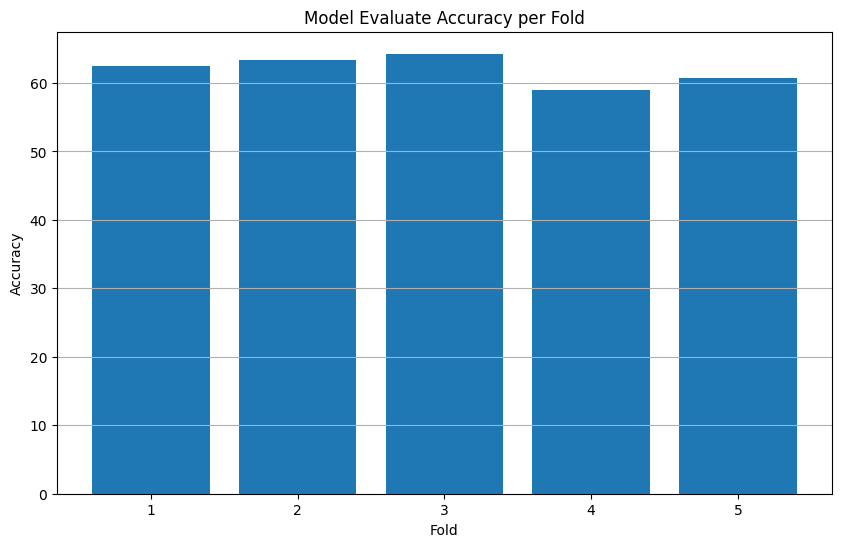

In [226]:
import matplotlib.pyplot as plt

# Buat figure dengan ukuran yang diinginkan
plt.figure(figsize=(10, 6))

# Buat grafik batang
plt.bar(range(1, len(accuracy_per_fold) + 1), accuracy_per_fold)

# Tambahkan judul dan label sumbu
plt.title('Model Evaluate Accuracy per Fold')
plt.xlabel('Fold')
plt.ylabel('Accuracy')

# Tambahkan tanda pada sumbu x sesuai jumlah fold
plt.xticks(range(1, len(accuracy_per_fold) + 1))

# Tambahkan grid untuk memudahkan pembacaan nilai
plt.grid(True, axis='y')

# Tampilkan grafik
plt.show()